## **ENERGYTECH-1: Analysis of the biogas detonation cell size measurements and creation of predicitive model.**

**author: Stanislaw Siatkowski**

Loading packages and setting up path.

In [1]:
import pandas as pd
import numpy as np
import os
import re
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from sklearn.linear_model import LinearRegression, ElasticNet, Ridge, Lasso
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, KFold
from sklearn.feature_selection import RFE, RFECV
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
from sklearn.preprocessing import StandardScaler
from datetime import date
import time
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from keras.wrappers.scikit_learn import KerasRegressor
import joblib
import winsound
from sdtoolbox.postshock import CJspeed, PostShock_fr, PostShock_eq
from sdtoolbox.znd import zndsolve
from sdtoolbox.cv import cvsolve
from sdtoolbox.utilities import CJspeed_plot, znd_plot
import cantera as ct

# add to Cantera directory with combustion mechanism files:
ct.add_directory("C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/SDToolbox/cti")

pd.options.display.max_rows = 100 # setting max displayed rows
os_path = "C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania"
export_path = "C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/05 Wyniki badań"
photos_path = "C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/03 Pomiary wielkości komórek_1/"
os.chdir(os_path)
pd.set_option('display.max_rows', 1000) # display up to 1000 rows in pandas dataframe

# Checking if I'm in the right directory:
os.getcwd()

'C:\\Users\\Stanislaw\\OneDrive - Politechnika Warszawska\\Pulpit\\09 Synology\\01 ENERGYTECH\\04 Badania'

Loading useful functions used while working with models.

In [4]:
def results_with_exp_uncertainty(y_test, y_pred, uncertaity=0.2 ):

    data_for_eval = pd.DataFrame({"y_test" : np.ravel(y_test),
                                  "y_pred" : np.ravel(y_pred),
                                  "y_pred_minus_uncertainty" : (1-uncertaity)*np.ravel(y_pred),
                                  "y_pred_plus_uncertainty" : (1+uncertaity)*np.ravel(y_pred)
                                 }
                                ).reset_index(drop=True)

    y_test_mod = []
    for idx, row in data_for_eval.iterrows():
        if row['y_test'] >= row['y_pred_minus_uncertainty'] and row['y_test'] <= row['y_pred_plus_uncertainty']:
            y_test_mod.append(row['y_pred'])
        elif row['y_test'] < row['y_pred_minus_uncertainty']:
            y_test_mod.append(row['y_test'] + uncertaity*row['y_pred'])
        elif row['y_test'] > row['y_pred_plus_uncertainty']:
            y_test_mod.append(row['y_test'] - uncertaity*row['y_pred'])
            
    data_for_eval['y_test_mod'] = y_test_mod

    R2_   = r2_score(y_test, y_pred)
    MSE_  = mean_squared_error(y_test, y_pred)
    MAE_  = mean_absolute_error(y_test, y_pred)
    MAPE_ = mean_absolute_percentage_error(y_test, y_pred)
    
    R2_mod   = r2_score(y_test_mod, y_pred)
    MSE_mod  = mean_squared_error(y_test_mod, y_pred)
    MAE_mod  = mean_absolute_error(y_test_mod, y_pred)
    MAPE_mod = mean_absolute_percentage_error(y_test_mod, y_pred)
    
    results = pd.DataFrame({"Version": ['No uncertainty correction', 'Uncertainty correction'],
                            "R2" : [R2_, R2_mod],
                            "MSE" : [MSE_, MSE_mod],
                            "MAE" : [MAE_, MAE_mod],
                            "MAPE" : [MAPE_, MAPE_mod],})
    
    return (results, y_test_mod)


In [5]:
# function to quickly plot learning history

# copied from: https://www.tensorflow.org/tutorials/keras/regression#linear_regression_with_one_variable

def plot_loss(history, metric):
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  # plt.ylim([0, 1])
  plt.xlabel('Epoch')
  plt.ylabel(f'{metric}')
  plt.legend()
  plt.grid(True)

In [6]:
# function to quickly plot predicted vs true values and calculate basic parameters
# describing model fit
def results(y_pred, y):
    y_max = np.max(y)
    y_pred_max = np.max(y_pred)
    if y_max > y_pred_max:
        limit = y_max+50
    else:
        limit = y_pred_max + 50
    
    R2 = r2_score(y, y_pred)
    MSE = mean_squared_error(y, y_pred)
    MAE = mean_absolute_error(y, y_pred)
    MAPE = mean_absolute_percentage_error(y, y_pred)

    results_ = pd.DataFrame({"R2" :  [R2],
                            "MSE" :  [MSE],
                            "MAE" :  [MAE],
                            "MAPE" : [MAPE],})
    
    a = plt.axes(aspect='equal')
    plt.scatter(y, y_pred)
    plt.xlabel('True Values [Cell size]')
    plt.ylabel('Predictions [Cell size]')
    lims = [0, limit]
    plt.xlim(lims)
    plt.ylim(lims)
    _ = plt.plot(lims, lims)

    return results_
    

In [7]:
# function to build and compile model (Neural Network)
def build_and_compile_model( n_hidden=2, n_neurons=10, loss_function  = 'mae', l2_penalty=0.001):
    model = keras.models.Sequential()
    # model.add(normalization_layer)
    for i in range(n_hidden):
        model.add(keras.layers.Dense(units = n_neurons, 
                                     activation = 'relu',
                                     kernel_regularizer = keras.regularizers.l2(l2_penalty)))
    model.add(keras.layers.Dense(1))

    model.compile(loss = loss_function,
                optimizer = tf.keras.optimizers.Adam(0.001),
                metrics = ['mse'])
    return model

In [8]:
def get_cantera_parameters(p0, phi, CH4, H2 = 0.0, air = False, T0 = 293, diluent = False, diluent_fraction = 0.0, zhang = False):
    p0 = p0*100000
    gas = ct.Solution('gri30.yaml')
    gas.TP = T0, p0
    diluent_ = f"H2"
    
    if air:
        oxidizer_ = "O2:0.21, N2:0.79"
    else:
        oxidizer_ = "O2:1.0"
    
    if diluent:
        fuel_    = f"CH4:{CH4}, CO2:{1-CH4}"
    elif zhang:
        fuel_    = f"CH4:{CH4}, H2:{H2}"
    else:
        fuel_ = f"CH4:{CH4}, CO2:{1-CH4-H2}, H2:{H2}"
    
    gas.set_equivalence_ratio(phi=phi,
                        fuel=fuel_, 
                        oxidizer=oxidizer_,
                        diluent=diluent_, 
                        fraction={"diluent":diluent_fraction}
                        )
    
    
    density_mole              = gas.density_mole
    mean_molecular_weight     = gas.mean_molecular_weight
    enthalpy_mole             = gas.enthalpy_mole
    int_energy_mole           = gas.int_energy_mole
    entropy_mole              = gas.entropy_mole
    gibbs_mole                = gas.gibbs_mole
    fuel_molecular_weight     = np.sum(gas['CH4', 'H2'].X*gas['CH4','H2'].molecular_weights)
    oxidizer_molecular_weight = np.sum(gas['O2'].X*gas['O2'].molecular_weights)
    inert_molecular_weight     = np.sum(gas['CO2', 'N2'].X*gas['CO2', 'N2'].molecular_weights)
    
    return (density_mole, mean_molecular_weight, enthalpy_mole, int_energy_mole, entropy_mole, gibbs_mole, fuel_molecular_weight, oxidizer_molecular_weight, inert_molecular_weight)

In [ ]:
# Exemplary chuck of code for plotting predicted vs true but using interactive plotly graph
X_y_lit_comb = data_from_literature_general
X_y_lit_comb['Predictions'] = y_pred_literature
fig = go.Figure()
fig.add_trace(go.Scatter(x = X_y_lit_comb['Cell_size'], 
                         y = X_y_lit_comb['Predictions'], 
                         mode = 'markers', 
                         name = "NN Literature",
                         customdata=X_y_lit_comb[['phi','p0','ch4', 'h2','air','diluent']],
                         hovertemplate = 'Phi: %{customdata[0]}<br>p0: %{customdata[1]:1.3f}[bar]<br>CH4:%{customdata[2]}<br>H2:%{customdata[3]}<br>air:%{customdata[4]}<br>diluent:%{customdata[5]}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))

fig.update_layout(
                title=f"Training set: Predicted values vs real values",
                xaxis_title="True Values [Cell size]",
                yaxis_title="Predictions [Cell size]",
                legend_title = 'Model:',
                yaxis_range=[0,250],
                xaxis_range=[0,250],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

### 0.Loading measured cell sizes.

In [13]:
print(f"Tensorflow version: {tf.__version__}")
print(f"Cantera version: {ct.__version__}")

Tensorflow version: 2.9.1
Cantera version: 2.5.1


Reading the sheet 'Badanie' from the spreadsheet 'Matryca-Badań', holding the research journal, and selecting the experiments with exported data.

In [6]:
badanie = pd.read_excel('Matryca-Badań.xlsx', sheet_name = 'Badanie', engine = 'openpyxl', header = 1, usecols = "A:L")
# select rows with experiments marked as exported
wyeksportowane = badanie.loc[badanie['Eksport']=='TAK',:].copy()
wyeksportowane['Nazwa pliku'] = wyeksportowane.loc[:,'Nazwa pliku'].str.replace('zd', "Zd.")

display(wyeksportowane.head())
#wyeksportowane.to_csv(export_path + "/wyeksportowane.csv", index = False)

,Lp.,Komponenty mieszaniny,Skład - f,po [bar],To [oC],Data,Nazwa pliku,Plik zdjęcia,Uwagi,Pomierzone [TAK/NIE],Eksport,Liczenie prędkości
38,39,80% CH4 + 20% CO2 + O2,1.5,0.7,22.8,2021-02-23,Zd.97,zdjęcie,"OK, tak sobie (KW)",TAK,TAK,NaN
44,45,80% CH4 + 20% CO2 + O2,0.75,1.0,18.3,2021-02-24,Zd.109,zdjęcie,częściowo zniszczyło folię,TAK,TAK,NaN
45,46,80% CH4 + 20% CO2 + O2,0.75,0.8,21.9,2021-02-24,Zd.110,zdjęcie,OK,TAK,TAK,NaN
46,47,80% CH4 + 20% CO2 + O2,0.75,0.6,21.5,2021-02-24,Zd.111,zdjęcie,"zmiana butli, OK",TAK,TAK,NaN
56,57,60% CH4 + 40% CO2 + O2,1,0.5,18.2,2021-03-01,Zd.130,zdjęcie,"wyszło, ale słabo widać",TAK,TAK,tak


Loading the data from folders containing exported csv files with data cell size measurements.

In [7]:
pliki = []
foldery = wyeksportowane['Nazwa pliku']
for zd in foldery:
    zawartosc = os.listdir(photos_path+zd)
    
    # Looking for a text file with scale in the directiory with simple check for a case if there is no text file in which it means the scale is 1
    # IT DOES NOT HELP IN CASE WHERE THERE ARE MULTIPLE FILES LIKE "SKALA_****.txt"
    skala = [f for f in zawartosc if f.endswith('.txt')]
    if len(skala) > 1:
        r = re.compile("SKALA_[0-9]\.[0-9]+.txt")
        skala = list(filter(r.match, zawartosc))
        skala = float(re.findall('[0-9]\.[0-9]+', skala[0])[0])
    elif len(skala) == 0:
        skala = 1.0
    else:
        skala = float(re.findall('[0-9]\.[0-9]+', skala[0])[0])

     # checking how many csv files there are in the directory
    plik_z_danymi = [f for f in zawartosc if f.endswith('.csv')]
    if len(plik_z_danymi) > 1:
        raise ValueError([zawartosc,'should be only one csv file in the current directory'])
    elif len(plik_z_danymi) == 0:
        raise ValueError([zawartosc, 'No csv file in the directory!'])
    else:
        plik_z_danymi = plik_z_danymi[0]
    
     # if there is an '*.xlsx' file in the folder it means that the csv filde has the colmuns separated with ';'
    # and not with ','. I need to check for that to properly set up the separator argument while reading the csv file 
    test_na_dziesietne = [f for f in zawartosc if f.endswith('.xlsx')]
    if len(test_na_dziesietne) > 0:
        tmp = pd.read_csv(photos_path+zd+'/'+plik_z_danymi, sep = ';', decimal = ',')
    else:
        tmp = pd.read_csv(photos_path+zd+'/'+plik_z_danymi, sep = ',', decimal = '.')
    
    # removing rows with a drawing layer from the picture (a thing specific to the data acquisition process)
    kolumny = list(tmp.columns)
    if 'Layer' in kolumny:
        tmp = tmp.loc[tmp['Layer']=='0']
        tmp = tmp.drop(columns = ['Layer'])
    
    tmp.columns = ['Cell_size']
    tmp['Cell_size'] = pd.to_numeric(tmp['Cell_size'])
    tmp = tmp.sort_values(by = 'Cell_size')
    tmp['Cell_size'] = tmp['Cell_size']/skala
    
    # deleting 5% of the data from the top and bottom if there is 20 or more points
    if len(tmp) >= 20:
        n = round(len(tmp)/20)
        tmp = tmp[n:-n]
    tmp.insert(loc = 0,
          column = 'Zd',
          value = zd)    
    
    pliki.append(tmp)
    
cell_sizes = pd.concat(pliki, ignore_index=True)
cell_sizes.dropna(inplace = True)
del pliki

cell_sizes.head(5)

,Zd,Cell_size
0,Zd.97,14.3898
1,Zd.97,14.6971
2,Zd.97,14.9641
3,Zd.97,15.3802
4,Zd.97,15.4201


**Finally I  have data from the following experiments:**

In [8]:
if len(wyeksportowane) != len(cell_sizes.Zd.unique()):
    print("IMPORTANT!! NOT ALL FILES WITH EXPORTED DATA WERE READ! CHECK IT!")
print(f" {len(cell_sizes.Zd.unique())} files were loaded resulting in a total of {len(cell_sizes)} rows.")

 291 files were loaded resulting in a total of 36418 rows.


### 1.Data preparation

Joining measured cell sizes with the experiment parameters. Additionally I add a column with methane percentage in a biogas.

In [9]:
joined_data = wyeksportowane.loc[:, ['Komponenty mieszaniny', 'Skład - f', 'po [bar]', 'Nazwa pliku']].merge(right = cell_sizes, 
                                                                                                            left_on = 'Nazwa pliku', 
                                                                                                            right_on = 'Zd' )

joined_data['CH4_perc'] = joined_data['Komponenty mieszaniny'].str.extract(r"(^[0-9]{2})")
joined_data['CH4_perc'] = joined_data['CH4_perc'].astype(float)/100
display(joined_data)
print(f"Shape of the data:{joined_data.shape}")

,Komponenty mieszaniny,Skład - f,po [bar],Nazwa pliku,Zd,Cell_size,CH4_perc
0,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,14.389800,0.80
1,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,14.697100,0.80
2,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,14.964100,0.80
3,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,15.380200,0.80
4,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,15.420100,0.80
...,...,...,...,...,...,...,...
36413,65% CH4 + 35% CO2 + O2,1.25,1.6,Zd.592,Zd.592,10.689745,0.65
36414,65% CH4 + 35% CO2 + O2,1.25,1.6,Zd.592,Zd.592,10.712868,0.65
36415,65% CH4 + 35% CO2 + O2,1.25,1.6,Zd.592,Zd.592,10.868206,0.65
36416,65% CH4 + 35% CO2 + O2,1.25,1.6,Zd.592,Zd.592,10.956558,0.65


Shape of the data:(36418, 7)


#### 1.1. Data aggregation per case

Calculating descriptive statistics of the experiments. It is important to note that I treat multiple experiments with the same initial conditions as one case that I aggregate.

In [10]:
agg_data = joined_data.loc[:,['Komponenty mieszaniny','Skład - f', 'po [bar]', 'Cell_size']].groupby(['Komponenty mieszaniny','Skład - f', 'po [bar]']).agg(['count', 'min', 'max', 'mean', 'median', 'std', 'var', 'sem']).reset_index()
agg_data.columns = agg_data.columns.droplevel(0)
agg_data.columns = ['Komponenty mieszaniny','Skład - f','p0 [bar]','count', 'min', 'max', 'mean', 'median', 'std', 'var', 'sem']
agg_data['CV'] = agg_data['std']/agg_data['mean']
agg_data = agg_data.sort_values(by=['Skład - f', 'p0 [bar]'])

# add column w CH4 percentage
agg_data['CH4_perc'] = agg_data['Komponenty mieszaniny'].str.extract(r"(^[0-9]{2})")
agg_data['CH4_perc'] = agg_data['CH4_perc'].astype(float)/100
display(agg_data.head())
print(f"Shape of the data: {agg_data.shape}")

,Komponenty mieszaniny,Skład - f,p0 [bar],count,min,max,mean,median,std,var,sem,CV,CH4_perc
12,50% CH4 + 50% CO2 + O2,0.5,0.6,31,38.095205,60.017982,47.493133,47.095305,5.976602,35.719766,1.073429,0.125841,0.50
53,55% CH4 + 45% CO2 + O2,0.5,0.6,61,29.824184,61.450675,46.646059,47.155810,7.164928,51.336198,0.917375,0.153602,0.55
92,60% CH4 + 40% CO2 + O2,0.5,0.6,95,28.671294,56.151916,41.891211,41.563464,6.974131,48.638497,0.715531,0.166482,0.60
140,65% CH4 + 35% CO2 + O2,0.5,0.6,87,23.715171,50.390915,37.126564,37.736307,7.241881,52.444835,0.776411,0.195059,0.65
180,70% CH4 + 30% CO2 + O2,0.5,0.6,49,24.988897,38.357631,31.680960,31.689745,3.536719,12.508382,0.505246,0.111635,0.70


Shape of the data: (229, 13)


In [11]:
agg_data

,Komponenty mieszaniny,Skład - f,p0 [bar],count,min,max,mean,median,std,var,sem,CV,CH4_perc
12,50% CH4 + 50% CO2 + O2,0.50,0.60,31,38.095205,60.017982,47.493133,47.095305,5.976602,35.719766,1.073429,0.125841,0.50
53,55% CH4 + 45% CO2 + O2,0.50,0.60,61,29.824184,61.450675,46.646059,47.155810,7.164928,51.336198,0.917375,0.153602,0.55
92,60% CH4 + 40% CO2 + O2,0.50,0.60,95,28.671294,56.151916,41.891211,41.563464,6.974131,48.638497,0.715531,0.166482,0.60
140,65% CH4 + 35% CO2 + O2,0.50,0.60,87,23.715171,50.390915,37.126564,37.736307,7.241881,52.444835,0.776411,0.195059,0.65
180,70% CH4 + 30% CO2 + O2,0.50,0.60,49,24.988897,38.357631,31.680960,31.689745,3.536719,12.508382,0.505246,0.111635,0.70
13,50% CH4 + 50% CO2 + O2,0.50,0.70,68,29.362708,44.687062,35.890307,35.462047,4.145607,17.186057,0.502729,0.115508,0.50
54,55% CH4 + 45% CO2 + O2,0.50,0.70,57,29.383320,46.060423,36.715271,36.010384,4.023061,16.185019,0.532867,0.109575,0.55
93,60% CH4 + 40% CO2 + O2,0.50,0.70,152,19.022025,46.232305,31.136828,30.843352,5.679277,32.254185,0.460650,0.182397,0.60
141,65% CH4 + 35% CO2 + O2,0.50,0.70,145,15.436625,43.325551,28.968232,29.785809,7.407491,54.870926,0.615159,0.255711,0.65
181,70% CH4 + 30% CO2 + O2,0.50,0.70,64,15.402738,37.359357,23.826080,24.071303,5.151130,26.534141,0.643891,0.216197,0.70


#### 1.2. Data aggregation per experiment

Additionally, I am aggregating data per experiment instead of per set of initial conditions. This might be useful when looking if some measurements were done incorrectly. Dividing per experiments helps pinpointing a particular experiment that need to be analyzed again.

In [85]:
agg_data_JK = joined_data.loc[:,['Zd', 'Komponenty mieszaniny','Skład - f', 'po [bar]', 'Cell_size']].groupby(['Zd','Komponenty mieszaniny','Skład - f', 'po [bar]']).agg(['count', 'min', 'max', 'mean','median', 'std', 'var', 'sem']).reset_index()
agg_data_JK.columns = agg_data_JK.columns.droplevel(0)
agg_data_JK.columns = ['Zd','Komponenty mieszaniny','Skład - f','p0 [bar]','count', 'min', 'max', 'mean', 'median', 'std', 'var', 'sem']
agg_data_JK['CV'] = agg_data_JK['std']/agg_data_JK['mean']
agg_data_JK = agg_data_JK.sort_values(by = ['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]'])

# adding column with CH4 percentage
agg_data_JK['CH4_perc'] = agg_data_JK['Komponenty mieszaniny'].str.extract(r"(^[0-9]{2})")
agg_data_JK['CH4_perc'] = agg_data_JK['CH4_perc'].astype(float)/100
display(agg_data_JK.head())
print(f"Shape of the data: {agg_data_JK.shape}")

,Zd,Komponenty mieszaniny,Skład - f,p0 [bar],count,min,max,mean,median,std,var,sem,CV,CH4_perc
235,Zd.520,40% CH4 + 60% CO2 + O2,1.0,0.8,10,34.932600,62.679400,48.405510,46.771600,10.024787,100.496364,3.170116,0.207100,0.4
18,Zd.166,40% CH4 + 60% CO2 + O2,1.0,1.0,39,28.748134,38.490994,33.216286,32.858991,2.630370,6.918844,0.421196,0.079189,0.4
236,Zd.521,40% CH4 + 60% CO2 + O2,1.0,1.2,33,21.949700,35.694600,29.836533,30.465100,2.808757,7.889116,0.488942,0.094138,0.4
247,Zd.533,40% CH4 + 60% CO2 + O2,1.0,1.4,21,20.334998,28.723515,23.390766,23.141488,2.561458,6.561068,0.558956,0.109507,0.4
234,Zd.519,40% CH4 + 60% CO2 + O2,1.0,1.6,67,11.632700,18.643100,14.619306,14.734300,1.741629,3.033271,0.212774,0.119132,0.4


Shape of the data: (292, 14)


### 2.Data visualization

#### 2.1. Plots of **average** detonation cell size per experiment

**1) $\lambda(p_0)$:**

In [55]:
for m in agg_data_JK['Komponenty mieszaniny'].unique():
    for f in np.sort(agg_data_JK['Skład - f'].unique()):
        tmp = agg_data_JK.loc[(agg_data_JK['Skład - f'] == f) & (agg_data_JK['Komponenty mieszaniny'] == m) & (agg_data_JK['p0 [bar]'] > 0.55)]

        if len(tmp) != 0:
            # ---------------- calculations to add trend lines ------------
            x_min = tmp['p0 [bar]'].min()
            x_max = tmp['p0 [bar]'].max()
            x_range = np.linspace(x_min, x_max, 100)

            log_p0 = np.log(tmp.loc[:,['p0 [bar]']])
            model1 = LinearRegression()
            model1.fit(log_p0.values, tmp['mean'])
            y_range1 = model1.predict(np.log(x_range.reshape(-1, 1)))
            pred1 = model1.predict(np.log(tmp[['p0 [bar]']].values))
            log_r2 = r2_score(y_true = tmp['mean'], y_pred = pred1)
            

            odwr_p0 = 1/(tmp.loc[:,['p0 [bar]']])
            model2 = LinearRegression()
            model2.fit(odwr_p0.values, tmp['mean'])
            y_range2 = model2.predict((1/x_range.reshape(-1, 1)))
            pred2 = model2.predict(1/(tmp[['p0 [bar]']].values))
            odwr_r2 = r2_score(y_true = tmp['mean'], y_pred = pred2)

            # ------------------------------------------------

            fig = go.Figure()
            fig.add_trace(go.Scatter(x = tmp['p0 [bar]'],
                                     y = tmp['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='Phi: ' + str(f),
                                     #text = tmp[['Zd','count']],
                                     customdata=tmp[['Zd','count']],
                                     #hoverinfo = 'text',
                                     hovertemplate = 'Zd: %{customdata[0]}<br>'+'count: %{customdata[1]}<br>'+'p<sub>0</sub>:%{x}<br>'+'cell size:%{y:.2f}'
                                    ))

            # --------------- adding trend lines --------------
            fig.add_trace(go.Scatter(x = x_range, y = y_range1, name = "Regression log(p0) fit."))
            fig.add_trace(go.Scatter(x = x_range, y = y_range2, name = "Regression 1/p0 fit."))
            
            fig.add_annotation(x = 1.5, 
                               y = tmp['mean'].max() - 5,
                               showarrow = False,
                               text = f"log(p0): R2 = {log_r2:.2f}"
                              )
            fig.add_annotation(x = 1.5, 
                               y = tmp['mean'].max() - 10,
                               showarrow = False,
                               text = f"1/p0: R2 = {odwr_r2:.2f}"
                              )
            # -----------------------------------------------
            
            fig.update_layout(
                title="Mieszanina {}, phi: {}".format(m,str(f)),
                xaxis_title="p0 [bar]",
                yaxis_title="Detonation cell size [mm]",
                #yaxis_range=[0,2],
                #yaxis_type = "log",
                #xaxis_type = "log",
                xaxis_range=[0.55, 1.65]
            )
            
            #fig.show()
            if m == "80% CH4 + 20% CO2 + O2": #in ["45% CH4 + 55% CO2 + O2", "40% CH4 + 60% CO2 + O2"]: #
                #fig.update_layout(yaxis_range = [0,60])
                display(fig.show())
            
            # saving plots:
            # today = date.today()
            #path_to_save = "C:/Users/Stanislaw.Siatkowski/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/CloudStation/04 Badania/05 Wyniki badań/01 Wykresy/01 Zaleznosc od p0/Mieszanina {}, phi_{}_{}.png".format(m,str(f), str(today))
            #fig.write_image(path_to_save, width = 1600, height = 900)
del tmp

None

None

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning:

R^2 score is not well-defined with less than two samples.

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning:

R^2 score is not well-defined with less than two samples.



None

**2) $\lambda(\phi)$:**

In [56]:
for m in agg_data_JK['Komponenty mieszaniny'].unique():
    for f in [0.6, 0.7, 0.8, 0.9, 1.0, 1.2, 1.4, 1.6]:
        tmp = agg_data_JK.loc[(agg_data_JK['p0 [bar]'] == f) & (agg_data_JK['Komponenty mieszaniny'] == m)]
        if len(tmp) != 0:
                    
            fig = go.Figure()
            fig.add_trace(go.Scatter(x = tmp['Skład - f'],
                                     y = tmp['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='p0: ' + str(f)+' [bar]',
                                     customdata = tmp[['Zd','count']],
                                     #hoverinfo = 'text',
                                     hovertemplate = 'Zd: %{customdata[0]}<br>count: %{customdata[1]}<br>phi:%{x}<br>lambda:%{y}'
                                     ))
            
            
            fig.update_layout(
                title="Mieszanina {}, p<sub>0</sub>: {} [bar]".format(m, str(f)),
                xaxis_title="$\phi [-] $",
                yaxis_title="Detonation cell size [mm]",
                #yaxis_range=[0,40],
                xaxis_range=[0.4, 1.6]
            )
            #fig.show()
            if (m == "50% CH4 + 50% CO2 + O2") & (f in [0.9, 1.0, 1.2, 1.4, 1.6]):
                # ---------------- calculations to add trend lines ------------
                x_min = tmp['Skład - f'].min()
                x_max = tmp['Skład - f'].max()
                x_range = np.linspace(x_min, x_max, 100)
                model1 = np.poly1d(np.polyfit(tmp['Skład - f'], tmp['mean'], 2))
                y_range1 = model1(x_range)
                pred1 = model1(tmp['Skład - f'])
                f_square_r2 = r2_score(y_true = tmp['mean'], y_pred = pred1)
                # ------------------------------------------------    

                # --------------- adding trend lines --------------
                fig.add_trace(go.Scatter(x = np.linspace(x_max, x_min, 100), y = y_range1, name = "phi^2 fit."))
                fig.add_annotation(x = 1.5, 
                                   y = tmp['mean'].max() - 5,
                                   showarrow = False,
                                   text = f"phi^2: R2 = {f_square_r2:.2f}"
                                  )
                # ------------------------------------------------
                fig.show()

del tmp

#### 2.2. Plots of **average** detonation cell size per case (unique initial parameters set)

**1) $\lambda(p_0)$:**

In [57]:
for m in agg_data['Komponenty mieszaniny'].unique():
    for f in agg_data['Skład - f'].unique():
        tmp = agg_data.loc[(agg_data['Skład - f'] == f) & (agg_data['Komponenty mieszaniny'] == m) & (agg_data['p0 [bar]'] > 0.55)]
        if len(tmp) != 0:
             # ---------------- calculations to add trend lines ------------
            x_min = tmp['p0 [bar]'].min()
            x_max = tmp['p0 [bar]'].max()
            x_range = np.linspace(x_min, x_max, 100)

            log_p0 = np.log(tmp.loc[:,['p0 [bar]']])
            model1 = LinearRegression()
            model1.fit(log_p0.values, tmp['mean'])
            y_range1 = model1.predict(np.log(x_range.reshape(-1, 1)))
            pred1 = model1.predict(np.log(tmp[['p0 [bar]']].values))
            log_r2 = r2_score(y_true = tmp['mean'], y_pred = pred1)
            

            odwr_p0 = 1/(tmp.loc[:,['p0 [bar]']])
            model2 = LinearRegression()
            model2.fit(odwr_p0.values, tmp['mean'])
            y_range2 = model2.predict((1/x_range.reshape(-1, 1)))
            pred2 = model2.predict(1/(tmp[['p0 [bar]']].values))
            odwr_r2 = r2_score(y_true = tmp['mean'], y_pred = pred2)

            # ------------------------------------------------
            fig = go.Figure()
            fig.add_trace(go.Scatter(x = tmp['p0 [bar]'],
                                     y = tmp['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='Phi: ' + str(f)))
            
            # --------------- adding trend lines and annotations --------------
            fig.add_trace(go.Scatter(x = x_range, y = y_range1, name = "Regression log(p0) fit."))
            fig.add_trace(go.Scatter(x = x_range, y = y_range2, name = "Regression 1/p0 fit."))
            
            fig.add_annotation(x = 1.5, 
                               y = tmp['mean'].max() - 5,
                               showarrow = False,
                               text = f"log(p0): R2 = {log_r2:.2f}"
                              )
            fig.add_annotation(x = 1.5, 
                               y = tmp['mean'].max() - 10,
                               showarrow = False,
                               text = f"1/p0: R2 = {odwr_r2:.2f}"
                              )
            # -----------------------------------------------
            
            fig.update_layout(
                title="Mieszanina {}, phi = {}".format(m,str(f)),
                xaxis_title="p<sub>0</sub> [bar]",
                yaxis_title="Mean detonation cell size [mm]",
                xaxis_range=[0.55, 1.65]
            )
            #fig.show()
            if m == "55% CH4 + 45% CO2 + O2":
                #fig.update_layout(yaxis_range=[0,65])
                fig.show()
            #sciezka = "Z:/04 Badania/05 Wyniki badań/01 Wykresy/01 Zaleznosc od p0/Mieszanina {}, phi_{}.png".format(m,str(f))
            #fig.write_image(sciezka, width = 1600, height = 900)
            
del tmp

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning:

R^2 score is not well-defined with less than two samples.

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\sklearn\metrics\_regression.py:796: UndefinedMetricWarning:

R^2 score is not well-defined with less than two samples.



**2) $\lambda(\phi)$:**

In [58]:
for m in agg_data['Komponenty mieszaniny'].unique():
    for f in np.sort(agg_data['p0 [bar]'].unique()):
        tmp = agg_data.loc[(agg_data['p0 [bar]'] == f) & (agg_data['Komponenty mieszaniny'] == m)]
        if len(tmp) != 0:
            fig = go.Figure()
            fig.add_trace(go.Scatter(x = tmp['Skład - f'],
                                     y = tmp['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='p0: ' + str(f)+' [bar]'))
            fig.update_layout(
                title="Mieszanina {}, p0: {} [bar]".format(m, str(f)),
                xaxis_title="$\phi$",
                yaxis_title="Mean detonation cell size [mm]"#,
                #yaxis_range=[0,40],
                #xaxis_range=[0.4, 1.6]
            )
            if (m == "50% CH4 + 50% CO2 + O2") & (f in [0.9, 1.0, 1.2, 1.4, 1.6]):
                # ---------------- calculations to add trend lines ------------
                x_min = tmp['Skład - f'].min()
                x_max = tmp['Skład - f'].max()
                x_range = np.linspace(x_min, x_max, 100)
                model1 = np.poly1d(np.polyfit(tmp['Skład - f'], tmp['mean'], 2))
                y_range1 = model1(x_range)
                pred1 = model1(tmp['Skład - f'])
                f_square_r2 = r2_score(y_true = tmp['mean'], y_pred = pred1)
                # ------------------------------------------------    

                # --------------- adding trend lines --------------
                fig.add_trace(go.Scatter(x = np.linspace(x_max, x_min, 100), y = y_range1, name = "phi^2 fit."))
                fig.add_annotation(x = 1.5, 
                                   y = tmp['mean'].max() - 5,
                                   showarrow = False,
                                   text = f"phi^2: R2 = {f_square_r2:.2f}"
                                  )
                # ------------------------------------------------
                fig.show()
            #sciezka = "Z:/04 Badania/05 Wyniki badań/01 Wykresy/02 Zaleznosc od phi/Mieszanina {}, p0_{} bar.png".format(m, str(f))
            #fig.write_image(sciezka, width = 1600, height = 900)

#### 2.3. All plots of $\lambda(p_0)$ for different $\phi$ on one plots. One plot per biogas composition.

In [59]:
for m in agg_data['Komponenty mieszaniny'].unique():
    fig = go.Figure()
    for f in agg_data['Skład - f'].unique():
        tmp1 = agg_data.loc[(agg_data['Skład - f'] == f) & (agg_data['Komponenty mieszaniny'] == m)]
        if len(tmp1) != 0:
            
            fig.add_trace(go.Scatter(x = tmp1['p0 [bar]'],
                                     y = tmp1['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='phi: ' + str(f)))
    fig.update_layout(
        title="Mixture {}".format(m),
        xaxis_title="<b>p<sub>0</sub> [bar]</b>",
        yaxis_title="<b>Mean detonation cell size [mm]</b>",
        #yaxis_range=[25,60],
        xaxis_range=[0.5, 1.8]
    )
    
    fig.show()
    #if (m == "70% CH4 + 30% CO2 + O2"):
    #    fig.show()
    #sciezka = "Z:/04 Badania/05 Wyniki badań/01 Wykresy/01 Zaleznosc od p0/Mieszanina {} , ZBIORCZY.png".format(m, str(f))
    #fig.write_image(sciezka, width = 1600, height = 900)

#### 2.4. All plots of $\lambda(\phi)$ for different $p_0$ on one plots. One plot per biogas composition.

In [60]:
tmp0 = agg_data[agg_data['p0 [bar]'].isin([0.6,0.7,0.9,1.0,1.2,1.4,1.6])]
for m in tmp0['Komponenty mieszaniny'].unique():
    fig = go.Figure()
    for f in tmp0['p0 [bar]'].unique():
        tmp1 = tmp0.loc[(agg_data['p0 [bar]'] == f) & (tmp0['Komponenty mieszaniny'] == m)]
        if len(tmp1) != 0:
            
            fig.add_trace(go.Scatter(x = tmp1['Skład - f'],
                                     y = tmp1['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='p<sub>0</sub>: ' + str(f)+' [bar]'))
    fig.update_layout(
        title="Mixture {}".format(m),
        xaxis_title="<b>phi</b>",
        yaxis_title="<b>Mean detonation cell size [mm]</b>",
        #yaxis_range=[5,140],
        #xaxis_range=[0.4, 1.8]
        )
    fig.show()
    #if m == "70% CH4 + 30% CO2 + O2":
    #    fig.show()
    #sciezka = "Z:/04 Badania/05 Wyniki badań/01 Wykresy/02 Zaleznosc od phi/Mieszanina {} , ZBIORCZY.png".format(m, str(f))
    #fig.write_image(sciezka, width = 1600, height = 900)

#### 2.5. Visual analysis of Coefficient of Variantion (CV)

Coefficient of Variation (CV) is defined as standard deviation devided by the mean of a sample.

In [61]:
print(f"Shape of the agg_data: {agg_data.shape}")
display(agg_data.head())

Shape of the agg_data: (230, 13)


,Komponenty mieszaniny,Skład - f,p0 [bar],count,min,max,mean,median,std,var,sem,CV,CH4_perc
12,50% CH4 + 50% CO2 + O2,0.5,0.6,31,38.095205,60.017982,47.493133,47.095305,5.976602,35.719766,1.073429,0.125841,0.50
53,55% CH4 + 45% CO2 + O2,0.5,0.6,61,29.824184,61.450675,46.646059,47.155810,7.164928,51.336198,0.917375,0.153602,0.55
92,60% CH4 + 40% CO2 + O2,0.5,0.6,95,28.671294,56.151916,41.891211,41.563464,6.974131,48.638497,0.715531,0.166482,0.60
141,65% CH4 + 35% CO2 + O2,0.5,0.6,87,23.715171,50.390915,37.126564,37.736307,7.241881,52.444835,0.776411,0.195059,0.65
181,70% CH4 + 30% CO2 + O2,0.5,0.6,49,24.988897,38.357631,31.680960,31.689745,3.536719,12.508382,0.505246,0.111635,0.70


In [62]:
display(agg_data['CH4_perc'].unique())
display(agg_data['Skład - f'].unique())
display(agg_data['p0 [bar]'].unique())
display(agg_data[agg_data['p0 [bar]'] == 0.3])

array([0.5 , 0.55, 0.6 , 0.65, 0.7 , 0.8 , 0.45, 0.4 ])

array([0.5 , 0.75, 1.  , 1.25, 1.5 ])

array([0.6 , 0.7 , 0.8 , 0.9 , 1.  , 1.2 , 1.32, 1.36, 1.4 , 1.6 , 0.3 ,
       0.4 , 0.5 , 1.5 , 0.53, 0.54])

,Komponenty mieszaniny,Skład - f,p0 [bar],count,min,max,mean,median,std,var,sem,CV,CH4_perc
109,60% CH4 + 40% CO2 + O2,1.0,0.3,7,84.841155,155.163759,120.744298,119.206679,25.148992,632.471795,9.505425,0.208283,0.6


In [63]:
import plotly.graph_objects as go
# tmp0 = agg_data[agg_data['CH4_perc'].isin([50.0, 60.0, 70.0])]
fig = go.Figure()
fig.add_trace(go.Histogram(x = agg_data['CV'], #tmp0['CV'],
                          xbins=dict(
                            start=.1,
                            end=0.35,
                            size=0.01)
                          )
             )
fig.show()

agg_data.loc[:, ['CV', 'Komponenty mieszaniny']].groupby(['Komponenty mieszaniny']).describe()


CV                                          \
                       count      mean       std       min       25%   
Komponenty mieszaniny                                                  
40% CH4 + 60% CO2 + O2   5.0  0.128920  0.052045  0.079189  0.094138   
45% CH4 + 55% CO2 + O2   7.0  0.116794  0.022122  0.080185  0.106580   
50% CH4 + 50% CO2 + O2  41.0  0.133300  0.041814  0.076223  0.110525   
55% CH4 + 45% CO2 + O2  39.0  0.154191  0.046616  0.051205  0.119211   
60% CH4 + 40% CO2 + O2  49.0  0.168449  0.041647  0.092660  0.144022   
65% CH4 + 35% CO2 + O2  40.0  0.194492  0.024322  0.141566  0.179831   
70% CH4 + 30% CO2 + O2  41.0  0.180440  0.035182  0.077658  0.159439   
80% CH4 + 20% CO2 + O2   8.0  0.146981  0.044346  0.070317  0.121748   

                                                      
                             50%       75%       max  
Komponenty mieszaniny                                 
40% CH4 + 60% CO2 + O2  0.109507  0.154667  0.207100  
45% CH4 + 55% CO2 + O2  0.120667  0.126185  0.151180  
50% CH4 + 50% CO2 + O2  0.125841  0.147094  0.273814  
55% CH4 + 45% CO2 + O2  0.157284  0.185670  0.246361  
60% CH4 + 40% CO2 + O2  0.163118  0.190474  0.317269  
65% CH4 + 35% CO2 + O2  0.191126  0.203934  0.266521  
70% CH4 + 30% CO2 + O2  0.187116  0.207114  0.229454  
80% CH4 + 20% CO2 + O2  0.144442  0.180994  0.207914

In [64]:
fig = go.Figure()
fig.add_trace(go.Box(x = agg_data['CV'],
                     boxmean='sd'))
fig.show()

#### 2.6. Cell size in a function of $CH_4$ percentage $\lambda(\%CH_4)$

In [1]:
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import numpy as np
tmp0 = agg_data[agg_data['p0 [bar]'].isin([0.6,0.9,1.0,1.2,1.6])]
tmp0['CH4_perc'] = tmp0.loc[:,'CH4_perc'] * 100
for phi in tmp0['Skład - f'].unique():
    fig = go.Figure()
    for initial_pressure in tmp0['p0 [bar]'].unique():
        tmp1 = tmp0.loc[(agg_data['p0 [bar]'] == initial_pressure) & (tmp0['Skład - f'] == phi)]
        if len(tmp1) != 0:
            # ---------------- calculations to add trend lines ------------
            x_min = tmp1['CH4_perc'].min()
            x_max = tmp1['CH4_perc'].max()
            x_range = np.linspace(x_min, x_max, 100)

            x_CH4 = tmp1.loc[:,['CH4_perc']]
            model2 = LinearRegression()
            model2.fit(x_CH4.values, tmp1['mean'])
            y_range2 = model2.predict((x_range.reshape(-1, 1)))
            pred2 = model2.predict(tmp1[['CH4_perc']].values)
            r2 = r2_score(y_true = tmp1['mean'], y_pred = pred2)

            # ------------------------------------------------

            fig.add_trace(go.Scatter(x = tmp1['CH4_perc'],
                                     y = tmp1['mean'],
                                     mode='markers',
                                     marker = dict(size = 10),
                                     name='p_0 = {} [bar]'.format(str(initial_pressure))
                                     )
                          )

            # --------------- adding trend lines --------------
            fig.add_trace(go.Scatter(x = x_range, y = y_range2, name = "Linear Regression fit."))
            fig.add_annotation(x = 45,
                               y = initial_pressure * 50,#tmp1['mean'].max() + 15,
                               showarrow = False,
                               text = f"p0 = {initial_pressure} [bar]: R2 = {r2:.2f}"
                               )
            # -----------------------------------------------

    fig.update_layout(
        title="$\phi = {}$".format(phi),
        xaxis_title="<b>%CH4</b>",
        yaxis_title="<b>Mean detonation cell size [mm]</b>",
        yaxis_range=[0,80],
        xaxis_range=[39, 71]
    )
    fig.show()
    #if m == "70% CH4 + 30% CO2 + O2":
    #    fig.show()
    #sciezka = "Z:/04 Badania/05 Wyniki badań/01 Wykresy/02 Zaleznosc od phi/Mieszanina {} , ZBIORCZY.png".format(m, str(f))
    #fig.write_image(sciezka, width = 1600, height = 900)

NameError: name 'agg_data' is not defined

### 3.Detonation propagation velocity

During the research we calculated both theoretical CJ values of a detonation propagation speed as well as experimental, for every case. The experimental velocity was calculted using a known distances between pressure sensors and the time difference of detonation wave arrival at the two consecutive sensors. The arrival time was defined as the time of a peak pressure registration. Finally, the velocity was calculated as an average of the velocities calculated between last 4 pressure sensors.

#### 3.1. Loading and preparation of the experimental velocities

In [66]:
experimental_velocities = pd.read_csv(filepath_or_buffer='06 Obliczenia prędkości detonacji/BazaDanych-Predkosci-wszystkie.dat',
                                       sep = " ",
                                       decimal = '.',
                                       na_values = ["INF","-1.0"],
                                       index_col = False)
print(f"Shape of the file: {experimental_velocities.shape}")
experimental_velocities.head()

Shape of the file: (284, 16)


,Nazwa_pliku,T1[ms],T2[ms],T3[ms],T4[ms],T5[ms],T6[ms],T7[ms],T8[ms],V1[m/s],V2[m/s],V3[m/s],V4[m/s],V5[m/s],V6[m/s],V7[m/s]
0,Z130_POB-E-H2_2021_03_01.dat,130.944,131.139,131.332,131.721,131.913,132.107,132.302,132.302,2051.3,2072.5,2056.6,2083.3,2061.9,2051.3,NaN
1,Z131_POB-E-H2_2021_03_01.dat,131.000,131.198,131.390,131.782,131.978,132.172,132.369,132.369,2020.2,2083.3,2040.8,2040.8,2061.9,2030.5,NaN
2,Z132_POB-E-H2_2021_03_01.dat,131.064,131.257,131.450,131.837,132.029,132.225,132.420,132.420,2072.5,2072.5,2067.2,2083.3,2040.8,2051.3,NaN
3,Z133_POB-E-H2_2021_03_01.dat,130.969,131.161,131.358,131.755,131.952,132.151,132.352,132.352,2083.3,2030.5,2015.1,2030.5,2010.1,1990.0,NaN
4,Z137_POB-E-H2_2021_03_04.dat,131.129,131.322,131.513,131.896,132.088,132.281,132.473,132.473,2072.5,2094.2,2088.8,2083.3,2072.5,2083.3,NaN


Extracting the experiment number from the column *Nazwa_pliku*. It is the number after letter *Z*, however in the rest of the tables it is in the form of *Zd.XXX* where *XXX* is the number of the experiment.

In [67]:
experiments_numbers = []
for plik in experimental_velocities['Nazwa_pliku']:
    exp_no = re.findall(pattern='Z\d*', string=plik)[0]
    experiments_numbers.append(exp_no)

experimental_velocities['Zd'] = experiments_numbers
experimental_velocities['Zd'] = experimental_velocities['Zd'].str.replace('Z', "Zd.")
# experimental_velocities

Adding information about $p_0, \phi$ and $\%CH_4$.

In [68]:
experimental_velocities = wyeksportowane.loc[:, ['Komponenty mieszaniny', 'Skład - f', 'po [bar]', 'Nazwa pliku']].merge(right = experimental_velocities,
                                                                                                                           left_on = 'Nazwa pliku',
                                                                                                                           right_on = 'Zd',
                                                                                                                           how = 'right')
experimental_velocities['CH4_perc'] = experimental_velocities['Komponenty mieszaniny'].str.extract(r"(^[0-9]{2})")
experimental_velocities['CH4_perc'] = experimental_velocities['CH4_perc'].astype(float)/100
experimental_velocities. rename(columns = {'po [bar]':'p0 [bar]'}, inplace = True)
experimental_velocities.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 284 entries, 0 to 283
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Komponenty mieszaniny  283 non-null    object 
 1   Skład - f              283 non-null    object 
 2   p0 [bar]               283 non-null    float64
 3   Nazwa pliku            283 non-null    object 
 4   Nazwa_pliku            284 non-null    object 
 5   T1[ms]                 284 non-null    float64
 6   T2[ms]                 284 non-null    float64
 7   T3[ms]                 284 non-null    float64
 8   T4[ms]                 284 non-null    float64
 9   T5[ms]                 284 non-null    float64
 10  T6[ms]                 284 non-null    float64
 11  T7[ms]                 284 non-null    float64
 12  T8[ms]                 283 non-null    float64
 13  V1[m/s]                276 non-null    float64
 14  V2[m/s]                283 non-null    float64
 15  V3[m/s

#### 3.2. Loading the theoretical CJ velocities

In [69]:
CJ_velocities = pd.read_csv(filepath_or_buffer='06 Obliczenia prędkości detonacji/V_CJ.csv',
                                        sep = ";",
                                        decimal = '.',
                                        index_col = False,
                                        encoding = 'utf-8')
CJ_velocities['CH4_perc'] = CJ_velocities['Komponenty mieszaniny'].str.extract(r"(^[0-9]{2})")
CJ_velocities['CH4_perc'] = CJ_velocities['CH4_perc'].astype(float)#/100
print(f"Shape of the file: {CJ_velocities.shape}")
CJ_velocities.head()

Shape of the file: (280, 5)


,Komponenty mieszaniny,Skład - f,p0 [bar],V_CJ,CH4_perc
0,70% CH4 + 30% CO2 + O2,0.5,0.6,1941.7,70.0
1,70% CH4 + 30% CO2 + O2,0.5,0.7,1946.3,70.0
2,70% CH4 + 30% CO2 + O2,0.5,0.8,1950.2,70.0
3,70% CH4 + 30% CO2 + O2,0.5,0.9,1953.7,70.0
4,70% CH4 + 30% CO2 + O2,0.5,1.0,1956.8,70.0


#### 3.3. Joining tables with theoretical and experimental velocities.

In [70]:
detonation_velocities = experimental_velocities.merge(right = CJ_velocities,
                                                                 on = ['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]'],
                                                                 how = 'left',
                                                                 validate = 'many_to_one')
print(f"Shape of the dataset: {detonation_velocities.shape}")
detonation_velocities.head()

Shape of the dataset: (284, 24)


,Komponenty mieszaniny,Skład - f,p0 [bar],Nazwa pliku,Nazwa_pliku,T1[ms],T2[ms],T3[ms],T4[ms],T5[ms],...,V2[m/s],V3[m/s],V4[m/s],V5[m/s],V6[m/s],V7[m/s],Zd,CH4_perc_x,V_CJ,CH4_perc_y
0,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Z130_POB-E-H2_2021_03_01.dat,130.944,131.139,131.332,131.721,131.913,...,2072.5,2056.6,2083.3,2061.9,2051.3,NaN,Zd.130,0.6,NaN,NaN
1,60% CH4 + 40% CO2 + O2,1,0.4,Zd.131,Z131_POB-E-H2_2021_03_01.dat,131.000,131.198,131.390,131.782,131.978,...,2083.3,2040.8,2040.8,2061.9,2030.5,NaN,Zd.131,0.6,NaN,NaN
2,60% CH4 + 40% CO2 + O2,1,0.6,Zd.132,Z132_POB-E-H2_2021_03_01.dat,131.064,131.257,131.450,131.837,132.029,...,2072.5,2067.2,2083.3,2040.8,2051.3,NaN,Zd.132,0.6,2073.2,60.0
3,60% CH4 + 40% CO2 + O2,1,0.3,Zd.133,Z133_POB-E-H2_2021_03_01.dat,130.969,131.161,131.358,131.755,131.952,...,2030.5,2015.1,2030.5,2010.1,1990.0,NaN,Zd.133,0.6,NaN,NaN
4,60% CH4 + 40% CO2 + O2,1,0.8,Zd.137,Z137_POB-E-H2_2021_03_04.dat,131.129,131.322,131.513,131.896,132.088,...,2094.2,2088.8,2083.3,2072.5,2083.3,NaN,Zd.137,0.6,2083.0,60.0


Export the data to a csv file.

In [71]:
# detonation_velocities.to_csv(path_or_buf="06 Obliczenia prędkości detonacji/predkosci_z_eksperymentow_i_CJ.csv",
#                                       sep = ';',
#                                       index = False,
#                                       encoding = 'utf-8')

### 4.CANTERA and SDToolbox calculations

In this section I am using CANTERA and a special toolbox for Cantera that allows to calculate different detonation parameters like:
1. detonation velocity
2. ZND parameters (e.g. induction length)
3. instability parameter Chi introduced by Ng.

Here, I am mostly interested in calculating ZND induction length and instability parameter Chi to see if and how they correlate either with initial parameters or detonation cell size.

#### 4.1. Import required libraries and add directory with combustions mechanism files:

In [2]:
from sdtoolbox.postshock import CJspeed, PostShock_fr, PostShock_eq
from sdtoolbox.znd import zndsolve
from sdtoolbox.cv import cvsolve
from sdtoolbox.utilities import CJspeed_plot, znd_plot
import cantera as ct

# add to Cantera directory with combustion mechanism files:
ct.add_directory("C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/SDToolbox/cti")

#### 4.2. Define functions to calculate mixture composition and properties:

Creating a function to output a dictionary with mixture composition. It takes $\phi$, $\%CH_4$ and indicator if mixture is with air or no(meaning that it is with oxygen).

In [3]:
def mixture_composition(phi, CH4_perc,air = False):
    """
    This function calculates the composition of a biogas-oxidizer mixture. An oxdizer might be either
    pure oxygen or air (oxygen + nitrogen).

    Args:
        phi (float): equivalence ratio of the mixture
        CH4_perc (float): molar fraction of CH4 in the biogas
        air (bool, optional): Indicator if mixture is with air or pure oxygen. Defaults to False.

    Returns:
        dictionary: mixture composition
    """
    if CH4_perc > 1:
        X_CH4 = CH4_perc/100   
        X_CO2 = (100 - CH4_perc)/100
    else:
        X_CH4 = CH4_perc
        X_CO2 = 1 - CH4_perc
    X_O2_stoich = 2 * X_CH4
    if air:
        X_N2_stoich = X_O2_stoich * 3.76
    else:
        X_N2_stoich = 0
    
    if phi <= 0:
        print("ERROR! Phi must be greater than 0!")
        return -1
    elif phi != 1:
            # Fuel to Air ratios: stoichiometric and for given phi
        FA_stoich = (X_CH4 + X_CO2)/(X_O2_stoich + X_N2_stoich)
        FA_phi   = FA_stoich * phi
            # molar fractions of the oxidizer
        
        if air:
            X_O2_phi = (X_CH4 + X_CO2)/(FA_phi*(1+3.76))
            X_N2_phi = X_O2_phi * 3.76
        else:
            X_O2_phi = (X_CH4 + X_CO2)/(FA_phi*(1+0))
            X_N2_phi = 0
            # final composition
        composition = {'CH4':X_CH4, 'CO2': X_CO2, 'O2':X_O2_phi, 'N2':X_N2_phi}
    else:
        composition = {'CH4':X_CH4, 'CO2': X_CO2, 'O2':X_O2_stoich, 'N2':X_N2_stoich}
        
    # if phi != 1:
    #     print("Not stoichiometric mixture:")
    #     print("Molar fractios:")
    #     print(f"F/A_stoich:  {FA_stoich}")
    #     print(f"F/A_phi: {FA_phi}")
    #     print(f"CH4: {X_CH4}")
    #     print(f"CO2: {X_CO2}")
    #     print(f"O2:  {X_O2_phi}")
    #     print(f"N2:  {X_N2_phi}")
    # else:
    #     print("Stoichiometric mixture:")
    #     # print(f"F/A: {FA_stoich}")
    #     print("Molar fractios:")
    #     print(f"CH4: {X_CH4}")
    #     print(f"CO2: {X_CO2}")
    #     print(f"O2:  {X_O2_stoich}")
    #     print(f"N2:  {X_N2_stoich}")
    return composition

Creating function to calculate detonation parameters:
* $V_{CJ}$
* ZND induction length
* $\chi$

In [4]:
def calculate_det_parameters( P1 = None, T1 = 300, phi = None, CH4_perc = None,mech = 'sandiego20161214.cti', air = False, method = 'BDF', only_VCJ = False):
    """
    This function calculates and outputs following detonation parameters:
        * V_CJ
        * ZND induction length
        * instability paremeter Chi

    Args:
        P1 (float): initial pressure of the combustible mixture in bars
        T1 (float): initial temperature of the combustible mixture in Kelvins
        phi (float): equivalence ratio, 
        CH4_perc (float): percentage of the CH4 in the biogas
        mech (string): string with the name of the file with combustion mechanism in the following form: '<file_name>.cti'
        air (bool, optional): Bool showing if the oxidizer is either Air (air = True) or pure Oxygen (air = False). Defaults to False.
        only_VCJ (bool, optional): Boolean showing if only V_CJ should be calculated and outputted.
    """

    # calculate composition of the mixture:
    composition = mixture_composition(phi, CH4_perc,air)
    if P1<=0 or T1 <= 0:
        print("ERROR! P1 and T1 must be greater than 0!")
        return -1
    
    # Find CJ speed and related data
    if P1 == 1.6 and phi == 1.0 and  CH4_perc == 65.0:
        p1 = 1.599
    P1 = P1 * 100000 # convert from bars to Pascals because Cantera takes only SI units
    cj_speed = CJspeed(P1,T1,composition,mech)
    if only_VCJ:
        return cj_speed

    # Set up gas object
    gas1 = ct.Solution(mech)
    gas1.TPX = T1,P1,composition
    
    # Find equilibrium post shock state for given speed
    gas = PostShock_eq(cj_speed, P1, T1, composition, mech)
    u_cj = cj_speed*gas1.density/gas.density
    
    # Find frozen post shock state for given speed
    gas = PostShock_fr(cj_speed, P1, T1, composition, mech)

    # Solve ZND ODEs, make ZND plots
    # print("#############################")
    # print("BEFORE CALLING zndsolve():")
    # print("Gas properties:")
    # display(gas())
    # print("----------------")
    # print("Gas1 properties")
    # display(gas1())
    out = zndsolve(gas,
                gas1,
                cj_speed,
                t_end=1e-3,
                advanced_output=True, 
                Method=method)#, 
                #    relTol=1e-6,
                #    absTol=1e-9,) # changing default solver 'LSODA' to 'BDF'
    
    # Find CV parameters including effective activation energy
    gas.TPX = T1,P1,composition
    gas = PostShock_fr(cj_speed, P1, T1, composition, mech)
    Ts = gas.T; Ps = gas.P
    Ta = Ts*1.02
    gas.TPX = Ta,Ps,composition
    CVout1 = cvsolve(gas, t_end = 5e-4)
    Tb = Ts*0.98
    gas.TPX = Tb,Ps,composition
    CVout2 = cvsolve(gas, t_end = 5e-3)
    # Approximate effective activation energy for CV explosion
    taua = CVout1['ind_time']
    taub = CVout2['ind_time']
    if taua==0 and taub==0:
        theta_effective_CV = 0
    else:
        theta_effective_CV = 1/Ts*((np.log(taua)-np.log(taub))/((1/Ta)-(1/Tb)))
        
    # Calculate instability parameter Chi
    max_thermicity_width_ZND = u_cj/out['max_thermicity_ZND']
    chi_ng = theta_effective_CV*out['ind_len_ZND']/max_thermicity_width_ZND
    znd_induction_length = out['ind_len_ZND']
    
    return (cj_speed, znd_induction_length, chi_ng)

Testing the functions: 

In [9]:
mixture_composition(phi=1.0, CH4_perc=70.0, air=True)

{'CH4': 0.7, 'CO2': 0.3, 'O2': 1.4, 'N2': 5.263999999999999}

In [77]:
# testing function to calculate detonatino parameters
# ,znd_induction_length, chi_ng

cj_speed = calculate_det_parameters(P1 = 1.599, 
                                    T1 = 300, 
                                    phi = 1.0, 
                                    CH4_perc = 65.0,
                                    mech = 'sandiego20161214.cti', 
                                    air = False,
                                    only_VCJ = True)
print(f"Calculated V_CJ = {cj_speed:.2f} [m/s]")
# print(f"Calculated ZND induction length = {znd_induction_length} [m]")
# print(f"Calculated Chi = {chi_ng} [m]")

Calculated V_CJ = 2153.26 [m/s]


Creating function to calculate adiabatic flame themperature.

In [78]:
def get_adiabatic_flame_temp(p0, phi, CH4_perc, T0 = 298, air = False):
    """
    This function calculates adiabatic flame temperature for a given mixture in given set of parameters.

    Args:
        p0 (float): mixture initial pressure in [bar]
        phi (float): equivalence ratio
        CH4_perc (float): CH4 percentage in biogas, value between 0 and 1
        T0 (int, optional): Initial temperature of the combustible mixture. Defaults to 298.
        air (bool, optional): Flag describing if the mixture is biogas-air (True) or biogas-oxygen(False). Defaults to False.

    Returns:
        float: adiabatic flame temperature
    """
    # convert pressure from bars to Pa
    p0 = p0 * 100000
    
    # Get all of the Species objects defined in the GRI 3.0 mechanism
    species = {S.name: S for S in ct.Species.listFromFile("gri30.yaml")}

    # Create an IdealGas object with species representing complete combustion
    complete_species = [species[S] for S in ("CH4", "O2", "N2", "CO2", "H2O")]
    gas1 = ct.Solution(thermo="IdealGas", species=complete_species)

    print(f'Phi:{phi}')
    gas1.TP = T0, p0
    if air:
        gas1.set_equivalence_ratio(phi, 
                                fuel=f"CH4:{CH4_perc}, CO2:{1-CH4_perc}",
                                oxidizer="O2:1.0, N2:3.76")
    else:
        gas1.set_equivalence_ratio(phi, 
                                fuel=f"CH4:{CH4_perc}, CO2:{1-CH4_perc}",
                                oxidizer="O2:1.0, N2:0.0")
    gas1.equilibrate("HP")
    T_adj = gas1.T
    return T_adj

Test T_adj calculation.

In [79]:
print(f'T_ajd = {get_adiabatic_flame_temp(p0=1.0, phi=1.0, CH4_perc=0.7)}')

Phi:1.0
T_ajd = 4578.5793171849555


#### 4.3. Calculate $V_{CJ}$ with Cantera and compare with $V_{CJ}$ calculated by STANJAN.

In [80]:
cj_velocities_cnt = []

for idx, row in CJ_velocities.iterrows():
    start_time = time.time()
    p1 = row['p0 [bar]']
    if row['p0 [bar]'] == 1.6 and row['Skład - f'] == 1.0 and row['CH4_perc'] == 65.0:
        p1 = 1.599
    
    V_CJ_cantera = calculate_det_parameters(P1=p1, 
                                            phi = row['Skład - f'],
                                            CH4_perc=row['CH4_perc'],
                                            only_VCJ = True)
    cj_velocities_cnt.append(V_CJ_cantera)
    print(f"Czas iteracji nr {idx}: {time.time() - start_time:.2f}s")
    # CJ_velocities['V_CJ_cantera'][idx] = V_CJ_cantera

CJ_velocities['V_CJ_cantera'] = cj_velocities_cnt
CJ_velocities

Czas iteracji nr 0: 1.27s
Czas iteracji nr 1: 2.03s
Czas iteracji nr 2: 0.78s
Czas iteracji nr 3: 1.01s
Czas iteracji nr 4: 1.72s
Czas iteracji nr 5: 1.03s
Czas iteracji nr 6: 0.78s
Czas iteracji nr 7: 0.79s
Czas iteracji nr 8: 1.01s
Czas iteracji nr 9: 0.94s
Czas iteracji nr 10: 2.50s
Czas iteracji nr 11: 0.81s


KeyboardInterrupt: 

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = CJ_velocities['V_CJ'],
    y = CJ_velocities['V_CJ_cantera'],
    mode='markers'))


fig.update_layout(
    title="V_CJ calculated by Cantera and STANJAN - comparison.",
    xaxis_title="STANJAN: V_CJ [m/s]",
    yaxis_title="Cantera: V_CJ [m/s]",
    template = 'seaborn',
    xaxis_range=[1750, 2300],
    yaxis_range=[1750, 2300]

)
fig.show()

**RESULT:** The calculations done in Cantera and STANJAN are giving the same results, great.

#### 4.4. Calculate $V_{CJ}$, ZND induction length and instability parameter $\chi$ for all cases.

In [ ]:
cj_velocities_cnt = []
znd_ind_len_list = []
chi_list = []

for idx, row in CJ_velocities.iterrows():
    start_time = time.time()
    p1 = row['p0 [bar]']
    phi = row['Skład - f']
    perc_ch4 = row['CH4_perc']
        
    print(f"Iteracja {idx}, p1 = {p1}, phi = {phi}, %CH4 = {perc_ch4}")
    V_CJ_cantera,znd_ind_len, chi = calculate_det_parameters(P1       = p1, 
                                                             phi      = phi,
                                                             CH4_perc = perc_ch4
                                                            )
    
    cj_velocities_cnt.append(V_CJ_cantera)
    znd_ind_len_list.append(znd_ind_len)
    chi_list.append(chi)
    print(f"Czas iteracji nr {idx}: {time.time() - start_time:.2f}s")
    print("------------------")

CJ_velocities['V_CJ_cantera'] = cj_velocities_cnt
CJ_velocities['ZND_ind_len'] = znd_ind_len_list
CJ_velocities['Chi'] = chi_list
CJ_velocities

Iteracja 0, p1 = 0.6, phi = 0.5, %CH4 = 70.0
Czas iteracji nr 0: 20.50s
------------------
Iteracja 1, p1 = 0.7, phi = 0.5, %CH4 = 70.0
Czas iteracji nr 1: 103.07s
------------------
Iteracja 2, p1 = 0.8, phi = 0.5, %CH4 = 70.0
Czas iteracji nr 2: 8.28s
------------------
Iteracja 3, p1 = 0.9, phi = 0.5, %CH4 = 70.0


CanteraError: 
***********************************************************************
CanteraError thrown by IdealGasPhase::setState_RP:
pressure must be positive
***********************************************************************


From the above triala it looks like I have some numerical issues, sometimes slight changes in the parameter value might give good results. For example changing p1 from 1.6 bar to 1.599 bar. Below, I am trying to check this.

In [ ]:
V_CJ_cantera,znd_ind_len, chi = calculate_det_parameters(P1      = 0.899, 
                                                        phi      = 0.5,
                                                        CH4_perc = 70.0
                                                            )
print(f"V_CJ = {V_CJ_cantera} [m/s]")
print(f"ZND ind. len. = {znd_ind_len} [m]")
print(f"Chi = {chi}.")

V_CJ = 1953.6262422522673 [m/s]
ZND ind. len. = 0.001985602951998358 [m]
Chi = 150.37531668600127.


It looks like subtracting some very small number from a parameter makes the calculations to converge. I will add try-except block to try to calculate with 'original' parameters and to subtract some very small number from it and try again if it won't work on the 'original' set.

In [ ]:
cj_velocities_cnt = []
znd_ind_len_list = []
chi_list = []
real_p1 = []
computations_times = []
with open('05 Wyniki badań/parametry_detonacji_CANTERA.txt','a') as det_par_file:
    for idx, row in CJ_velocities.iterrows():
        start_time = time.time()
        p1 = row['p0 [bar]']
        phi = row['Skład - f']
        perc_ch4 = row['CH4_perc']
        V_CJ_stanjan = row['V_CJ']
        
        # safety for this one set of parameters that made function calculating V_CJ fall into an endless loop.
        if row['p0 [bar]'] == 1.6 and row['Skład - f'] == 1.0 and row['CH4_perc'] == 65.0:
            p1 = 1.599
        
        print(f"Iteracja {idx}, p1 = {p1}, phi = {phi}, %CH4 = {perc_ch4}")
        subtractor = 0.001
        is_ok = False
        max_subtractor = 0.01
        p1_treshold = p1 - max_subtractor
        while p1 >= p1_treshold:
            try:
                V_CJ_cantera,znd_ind_len, chi = calculate_det_parameters(P1      = p1, 
                                                                        phi      = phi,
                                                                        CH4_perc = perc_ch4,
                                                                        # method = 'LSDOA'
                                                                        )
                is_ok = True
                break
            except:
                p1 = p1 - subtractor
                subtractor = subtractor + 0.001
        
        if is_ok:    
            print(f"Parametry obliczono pomyślnie! Użyte p1 = {p1} [bar].")
        else:
            V_CJ_cantera = -1
            znd_ind_len = -1
            chi = -1
            print("OBLICZENIA NIEUDANE")
        
        # add calculated parameters to list to be then added to DF 
        cj_velocities_cnt.append(V_CJ_cantera)
        znd_ind_len_list.append(znd_ind_len)
        chi_list.append(chi)
        real_p1.append(p1) 
        
        # write calculations results to a file  
        det_par_file.write(f'{p1:.4f};{phi:.2f};{perc_ch4:.2f};{V_CJ_stanjan:.2f};\
                           {V_CJ_cantera};{znd_ind_len:.4f};{chi:.2f}\n')
        # write and report time
        computation_time = time.time() - start_time
        computations_times.append(computation_time)
        print(f"Czas obliczen nr {idx}: {computation_time:.2f}s")
        print("------------------")
        
        

CJ_velocities['V_CJ_cantera'] = cj_velocities_cnt
CJ_velocities['ZND_ind_len'] = znd_ind_len_list
CJ_velocities['Chi'] = chi_list
CJ_velocities['real_p1'] = real_p1
CJ_velocities['Iteration_time'] = computations_times
CJ_velocities

Iteracja 0, p1 = 0.6, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 0.6 [bar].
Czas obliczen nr 0: 14.95s
------------------
Iteracja 1, p1 = 0.7, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 0.7 [bar].
Czas obliczen nr 1: 77.56s
------------------
Iteracja 2, p1 = 0.8, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 0.8 [bar].
Czas obliczen nr 2: 6.70s
------------------
Iteracja 3, p1 = 0.9, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 0.899 [bar].
Czas obliczen nr 3: 17.31s
------------------
Iteracja 4, p1 = 1.0, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 0.997 [bar].
Czas obliczen nr 4: 147.77s
------------------
Iteracja 5, p1 = 1.2, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 1.2 [bar].
Czas obliczen nr 5: 1609.35s
------------------
Iteracja 6, p1 = 1.4, phi = 0.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 1.399 [bar].
Czas obliczen nr 6: 391.58s
--

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\integrate\_ode.py:1350: UserWarning: lsoda: Excess accuracy requested (tolerances too small).
  warnings.warn('{:s}: {:s}'.format(self.__class__.__name__,


Parametry obliczono pomyślnie! Użyte p1 = 1.397 [bar].
Czas obliczen nr 38: 234.00s
------------------
Iteracja 39, p1 = 1.6, phi = 1.5, %CH4 = 70.0
Parametry obliczono pomyślnie! Użyte p1 = 1.6 [bar].
Czas obliczen nr 39: 352.68s
------------------
Iteracja 40, p1 = 0.6, phi = 0.5, %CH4 = 65.0
Parametry obliczono pomyślnie! Użyte p1 = 0.599 [bar].
Czas obliczen nr 40: 139.84s
------------------
Iteracja 41, p1 = 0.7, phi = 0.5, %CH4 = 65.0
Parametry obliczono pomyślnie! Użyte p1 = 0.697 [bar].
Czas obliczen nr 41: 1716.90s
------------------
Iteracja 42, p1 = 0.8, phi = 0.5, %CH4 = 65.0
Parametry obliczono pomyślnie! Użyte p1 = 0.8 [bar].
Czas obliczen nr 42: 33.06s
------------------
Iteracja 43, p1 = 0.9, phi = 0.5, %CH4 = 65.0
Parametry obliczono pomyślnie! Użyte p1 = 0.899 [bar].
Czas obliczen nr 43: 70.80s
------------------
Iteracja 44, p1 = 1.0, phi = 0.5, %CH4 = 65.0
Parametry obliczono pomyślnie! Użyte p1 = 1.0 [bar].
Czas obliczen nr 44: 4140.28s
------------------
Iteracja 

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\integrate\_ivp\common.py:336: RuntimeWarning: overflow encountered in multiply
  new_factor = NUM_JAC_FACTOR_INCREASE * factor[ind]
c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\integrate\_ivp\common.py:358: RuntimeWarning: overflow encountered in multiply
  factor[max_diff < NUM_JAC_DIFF_SMALL * scale] *= NUM_JAC_FACTOR_INCREASE


Parametry obliczono pomyślnie! Użyte p1 = 1.197 [bar].
Czas obliczen nr 125: 25.26s
------------------
Iteracja 126, p1 = 1.4, phi = 0.5, %CH4 = 55.0
Parametry obliczono pomyślnie! Użyte p1 = 1.399 [bar].
Czas obliczen nr 126: 28.63s
------------------
Iteracja 127, p1 = 1.6, phi = 0.5, %CH4 = 55.0
Parametry obliczono pomyślnie! Użyte p1 = 1.6 [bar].
Czas obliczen nr 127: 10.65s
------------------
Iteracja 128, p1 = 0.6, phi = 0.75, %CH4 = 55.0
Parametry obliczono pomyślnie! Użyte p1 = 0.6 [bar].
Czas obliczen nr 128: 5359.88s
------------------
Iteracja 129, p1 = 0.7, phi = 0.75, %CH4 = 55.0
Parametry obliczono pomyślnie! Użyte p1 = 0.7 [bar].
Czas obliczen nr 129: 353.08s
------------------
Iteracja 130, p1 = 0.8, phi = 0.75, %CH4 = 55.0
Parametry obliczono pomyślnie! Użyte p1 = 0.799 [bar].
Czas obliczen nr 130: 35.69s
------------------
Iteracja 131, p1 = 0.9, phi = 0.75, %CH4 = 55.0
Parametry obliczono pomyślnie! Użyte p1 = 0.894 [bar].
Czas obliczen nr 131: 21.39s
---------------

,Komponenty mieszaniny,Skład - f,p0 [bar],V_CJ,CH4_perc,V_CJ_cantera,ZND_ind_len,Chi,real_p1,Iteration_time
0,70% CH4 + 30% CO2 + O2,0.5,0.6,1941.7,70.0,1941.660258,0.003051,160.891246,0.600,14.947084
1,70% CH4 + 30% CO2 + O2,0.5,0.7,1946.3,70.0,1946.235395,0.002590,156.965668,0.700,77.556513
2,70% CH4 + 30% CO2 + O2,0.5,0.8,1950.2,70.0,1950.185551,0.002247,153.608413,0.800,6.702363
3,70% CH4 + 30% CO2 + O2,0.5,0.9,1953.7,70.0,1953.626242,0.001986,150.375317,0.899,17.314867
4,70% CH4 + 30% CO2 + O2,0.5,1.0,1956.8,70.0,1956.668632,0.001778,147.988927,0.997,147.770007
...,...,...,...,...,...,...,...,...,...,...
275,40% CH4 + 60% CO2 + O2,1.5,0.9,1849.5,40.0,1849.408286,0.018694,199.251464,0.900,510.334525
276,40% CH4 + 60% CO2 + O2,1.5,1.0,1851.2,40.0,1851.148024,0.016782,191.505595,1.000,26.922452
277,40% CH4 + 60% CO2 + O2,1.5,1.2,1854.1,40.0,1854.080319,0.013922,178.665424,1.200,43.150651
278,40% CH4 + 60% CO2 + O2,1.5,1.4,1856.5,40.0,1856.480013,0.011879,167.793736,1.400,30584.678743


Calculate adiabatic flame temperature.

In [ ]:
adiabatic_temperatures = []
for idx, row in CJ_velocities.iterrows():
        # get p0, phi and %CH4
        p0_row = row['p0 [bar]']
        phi_row = row['Skład - f']
        perc_ch4 = row['CH4_perc']

        # calculate adiabatic flame temperature
        T_adj = get_adiabatic_flame_temp(p0 = p0_row, phi = phi_row, CH4_perc = perc_ch4)
        adiabatic_temperatures.append(T_adj)

CJ_velocities['T_adj'] = adiabatic_temperatures

Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.5
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:0.75
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.0
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.25
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5
Phi:1.5


In [ ]:
CJ_velocities.head()

,Komponenty mieszaniny,Skład - f,p0 [bar],V_CJ,CH4_perc,V_CJ_cantera,ZND_ind_len,Chi,real_p1,Iteration_time,T_ajd
0,70% CH4 + 30% CO2 + O2,0.5,0.6,1941.7,0.7,1941.660258,0.003051,160.891246,0.600,14.947084,3465.456668
1,70% CH4 + 30% CO2 + O2,0.5,0.7,1946.3,0.7,1946.235395,0.002590,156.965668,0.700,77.556513,3465.456668
2,70% CH4 + 30% CO2 + O2,0.5,0.8,1950.2,0.7,1950.185551,0.002247,153.608413,0.800,6.702363,3465.456668
3,70% CH4 + 30% CO2 + O2,0.5,0.9,1953.7,0.7,1953.626242,0.001986,150.375317,0.899,17.314867,3465.456668
4,70% CH4 + 30% CO2 + O2,0.5,1.0,1956.8,0.7,1956.668632,0.001778,147.988927,0.997,147.770007,3465.456668


Exporting the results to csv file:

In [ ]:
CJ_velocities.to_csv(path_or_buf="07 Parametry detonacji - CANTERA/parametry_detonacji_CANTERA.csv",
                                      sep = ';',
                                      index = False,
                                      encoding = 'utf-8')

After 94,4 hours it finally calculated!

#### 4.5. Visualizing the results of Cantera calculations.

Loading the calculated detonation parameters.

In [ ]:
# Load the calculated data
detonation_parameters_cnt = pd.read_csv(filepath_or_buffer='07 Parametry detonacji - CANTERA/parametry_detonacji_CANTERA.csv',
                                        sep = ";",
                                        decimal = '.',
                                        index_col = False,
                                        encoding = 'utf-8')
# detonation_parameters_cnt['CH4_perc'] = detonation_parameters_cnt['CH4_perc']/100

detonation_parameters_cnt.head()

,Komponenty mieszaniny,Skład - f,p0 [bar],V_CJ,CH4_perc,V_CJ_cantera,ZND_ind_len,Chi,real_p1,Iteration_time,T_adj
0,70% CH4 + 30% CO2 + O2,0.5,0.6,1941.7,0.7,1941.660258,0.003051,160.891246,0.600,14.947084,3465.456668
1,70% CH4 + 30% CO2 + O2,0.5,0.7,1946.3,0.7,1946.235395,0.002590,156.965668,0.700,77.556513,3465.456668
2,70% CH4 + 30% CO2 + O2,0.5,0.8,1950.2,0.7,1950.185551,0.002247,153.608413,0.800,6.702363,3465.456668
3,70% CH4 + 30% CO2 + O2,0.5,0.9,1953.7,0.7,1953.626242,0.001986,150.375317,0.899,17.314867,3465.456668
4,70% CH4 + 30% CO2 + O2,0.5,1.0,1956.8,0.7,1956.668632,0.001778,147.988927,0.997,147.770007,3465.456668


Joining the detonation cell size measurements descriptive statistics.

In [ ]:
all_agg_data = agg_data.merge(right = detonation_parameters_cnt,
                on = ['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]', 'CH4_perc'],
                how = 'left')
all_agg_data.head(5)

,Komponenty mieszaniny,Skład - f,p0 [bar],count,min,max,mean,median,std,var,sem,CV,CH4_perc,V_CJ,V_CJ_cantera,ZND_ind_len,Chi,real_p1,Iteration_time,T_adj
0,50% CH4 + 50% CO2 + O2,0.5,0.6,31,38.095205,60.017982,47.493133,47.095305,5.976602,35.719766,1.073429,0.125841,0.50,1835.7,1835.611827,0.006708,231.993280,0.600,520.538156,3142.266968
1,55% CH4 + 45% CO2 + O2,0.5,0.6,61,29.824184,61.450675,46.646059,47.155810,7.164928,51.336198,0.917375,0.153602,0.55,1866.7,1866.621462,0.005288,207.366137,0.599,28.762429,3237.410048
2,60% CH4 + 40% CO2 + O2,0.5,0.6,95,28.671294,56.151916,41.891211,41.563464,6.974131,48.638497,0.715531,0.166482,0.60,1894.4,1894.350656,0.004289,189.001019,0.600,9.327064,3321.919055
3,65% CH4 + 35% CO2 + O2,0.5,0.6,87,23.715171,50.390915,37.126564,37.736307,7.241881,52.444835,0.776411,0.195059,0.65,1919.3,1919.158656,0.003586,173.234002,0.599,139.844984,3397.484629
4,70% CH4 + 30% CO2 + O2,0.5,0.6,49,24.988897,38.357631,31.680960,31.689745,3.536719,12.508382,0.505246,0.111635,0.70,1941.7,1941.660258,0.003051,160.891246,0.600,14.947084,3465.456668


In [ ]:
np.sort(all_agg_data['CH4_perc'].unique(), axis=-1)

array([0.4 , 0.45, 0.5 , 0.55, 0.6 , 0.65, 0.7 , 0.8 ])

**4.5.0. Export the whole data.**

Exporting the data to be used as a supplementary material in an article.

In [ ]:
all_agg_data.columns

Index(['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]', 'count', 'min', 'max',
       'mean', 'median', 'std', 'var', 'sem', 'CV', 'CH4_perc', 'V_CJ',
       'V_CJ_cantera', 'ZND_ind_len', 'Chi', 'real_p1', 'Iteration_time'],
      dtype='object')

In [ ]:
columns_to_drop = ['V_CJ_cantera','real_p1','Iteration_time']
column_rename_dict = {'Komponenty mieszaniny':'Biogas composition', 'Skład - f':'Phi'}
new_columns_order = ['Biogas composition', 'CH4_perc','Phi', 'p0 [bar]', 'V_CJ', 'ZND_ind_len',
                    'Chi', 'count', 'min', 'max', 'mean', 'median', 'std', 'var', 'sem', 'CV']
p0_to_keep = {0.6, 0.7, 0.8, 0.9, 1.0, 1.2, 1.4, 1.6}
ch4_to_keep = {0.7, 0.65, 0.6, 0.55, 0.5}

data_to_export = all_agg_data.drop(columns=columns_to_drop)
data_to_export = data_to_export.rename(columns=column_rename_dict)
data_to_export = data_to_export.reindex(columns=new_columns_order)
data_to_export = data_to_export.loc[(data_to_export['p0 [bar]'].isin(p0_to_keep))]
data_to_export = data_to_export.loc[(data_to_export['CH4_perc'].isin(ch4_to_keep))]
data_to_export['CH4_perc'] = data_to_export['CH4_perc']*100
data_to_export = data_to_export.sort_values(by = ['CH4_perc', 'Phi', 'p0 [bar]'])
data_to_export.to_csv(path_or_buf="05 Wyniki badań/aggregated_data_ch4_70-50.csv",
                                      sep = ';',
                                      index = False,
                                      encoding = 'utf-8')

**4.5.1. Iterations computation time.**

In [ ]:
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Histogram(x = detonation_parameters_cnt['Iteration_time'],
                          xbins=dict(
                            start=0,
                            end=28000,
                            size=360)
                          )
             )
fig.update_layout(
        title="Computations time histogram",
        xaxis_title="Case's computation time [s]",
        yaxis_title=""
    )
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = detonation_parameters_cnt.index,
                         y = detonation_parameters_cnt['Iteration_time']
                          )
             )
fig.update_layout(
        title="Computations time",
        yaxis_title="Iteration's computation time [s]",
        xaxis_title="Case"
    )
fig.show()

**4.5.2. Instability parameter $\chi(p_0)$.**

In [ ]:
detonation_parameters_cnt.columns

Index(['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]', 'V_CJ', 'CH4_perc',
       'V_CJ_cantera', 'ZND_ind_len', 'Chi', 'real_p1', 'Iteration_time'],
      dtype='object')

In [ ]:

detonation_parameters_cnt["CH4_perc"] = detonation_parameters_cnt["CH4_perc"].astype(str)

fig = px.scatter(detonation_parameters_cnt, 
                 x="p0 [bar]", 
                 y="Chi", 
                 facet_col="Skład - f",
                 color="CH4_perc")

fig.show()
detonation_parameters_cnt["CH4_perc"] = detonation_parameters_cnt["CH4_perc"].astype(float)

**4.5.3. Recalculate wrong data.**

From the plots it can be seen that some of the calculations were unsuccessfull. Those are the ones with Chi eqaul to -1 or close to 0. I am trying to re-run them.

EDIT:
After re-running the cases below and updating the files with results, it looks good now.

In [ ]:
# case 1: phi = 0.75, p1 = 1.2 [bar], Ch4_perc = 0.65
cj_speed, znd_induction_length, chi_ng  = calculate_det_parameters(P1 = 1.19, 
                                        T1 = 300, 
                                        phi = 0.75, 
                                        CH4_perc = 65.0,
                                        mech = 'sandiego20161214.cti', 
                                        air = False)
print(f"Calculated V_CJ = {cj_speed:.2f} [m/s]")
print(f"Calculated ZND induction length = {znd_induction_length} [m]")
print(f"Calculated Chi = {chi_ng} [m]")

Calculated V_CJ = 2061.35 [m/s]
Calculated ZND induction length = 0.0012762845012352251 [m]
Calculated Chi = 157.26724882200105 [m]


In [ ]:
# case 2: phi = 1.5, p1 = 0.6 [bar], Ch4_perc = 0.40
cj_speed, znd_induction_length, chi_ng  = calculate_det_parameters(P1 = 0.6, 
                                        T1 = 300, 
                                        phi = 1.5, 
                                        CH4_perc = 40.0,
                                        mech = 'sandiego20161214.cti', 
                                        air = False)
print(f"Calculated V_CJ = {cj_speed:.2f} [m/s]")
print(f"Calculated ZND induction length = {znd_induction_length} [m]")
print(f"Calculated Chi = {chi_ng} [m]")

Calculated V_CJ = 1842.42 [m/s]
Calculated ZND induction length = 0.028280911110140413 [m]
Calculated Chi = 229.9430344394927 [m]


In [ ]:
# case 3: phi = 1.5, p1 = 0.7 [bar], Ch4_perc = 0.40
cj_speed, znd_induction_length, chi_ng  = calculate_det_parameters(P1 = 0.7, 
                                        T1 = 300, 
                                        phi = 1.5, 
                                        CH4_perc = 40.0,
                                        mech = 'sandiego20161214.cti', 
                                        air = False)
print(f"Calculated V_CJ = {cj_speed:.2f} [m/s]")
print(f"Calculated ZND induction length = {znd_induction_length} [m]")
print(f"Calculated Chi = {chi_ng} [m]")

Calculated V_CJ = 1845.13 [m/s]
Calculated ZND induction length = 0.024169874002299408 [m]
Calculated Chi = 218.47618077786473 [m]


In [ ]:
import plotly.express as px
p0_to_keep = {0.6,  1.0,  1.6}
ch4_to_keep = {0.7, 0.6, 0.5, 0.4}
tmp = detonation_parameters_cnt.loc[(detonation_parameters_cnt['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.scatter(tmp, 
                 x="Skład - f", 
                 y="Chi", 
                 facet_col="p0 [bar]",
                 color="CH4_perc")
fig.update_xaxes(
    title='phi'
)
fig.show()


**4.5.4. ZND ind. length.**

In [ ]:
all_agg_data.columns

Index(['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]', 'count', 'min', 'max',
       'mean', 'median', 'std', 'var', 'sem', 'CV', 'CH4_perc', 'V_CJ',
       'V_CJ_cantera', 'ZND_ind_len', 'Chi', 'real_p1', 'Iteration_time'],
      dtype='object')

In [ ]:
import plotly.express as px
p0_to_keep = {0.6, 0.8, 1.0, 1.2, 1.6}
ch4_to_keep = {0.7, 0.6, 0.5,0.55, 0.4}
tmp = detonation_parameters_cnt.loc[(detonation_parameters_cnt['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.scatter(tmp, 
                 x="ZND_ind_len", 
                 y="Chi", 
                 facet_col="Skład - f",
                 color="CH4_perc")

fig.show()


In [ ]:
import plotly.express as px
# p0_to_keep = {0.6,  1.0,  1.6}
ch4_to_keep = {0.7, 0.6, 0.5}
# tmp = all_agg_data.loc[(all_agg_data['p0 [bar]'].isin(p0_to_keep))]
tmp = all_agg_data.loc[(all_agg_data['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.scatter(tmp, 
                 x="ZND_ind_len", 
                 y="mean", 
                 facet_col="Skład - f",
                 color="CH4_perc")
fig.update_layout(
        yaxis_title="Mean det. cell size [m]",
        xaxis_title="ZND ind. len. [m]",
        yaxis_range=[0,60]
    )

fig.show()


C:\Users\STANIS~1\AppData\Local\Temp/ipykernel_21008/4014419003.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



**4.5.6. Adiabatic flame temperature $T_{adj}$.**

In [ ]:
detonation_parameters_cnt.rename({'T_ajd':'T_adj'}, inplace=True, axis= 'columns')

In [ ]:
detonation_parameters_cnt.columns

Index(['Komponenty mieszaniny', 'Skład - f', 'p0 [bar]', 'V_CJ', 'CH4_perc',
       'V_CJ_cantera', 'ZND_ind_len', 'Chi', 'real_p1', 'Iteration_time',
       'T_adj'],
      dtype='object')

In [ ]:
import plotly.express as px
p0_to_keep = {0.6, 0.8, 1.0, 1.2, 1.6}
ch4_to_keep = {0.7, 0.6, 0.5,0.55, 0.4}
tmp = detonation_parameters_cnt.loc[(detonation_parameters_cnt['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.line(tmp, 
            x="Skład - f", 
            y="T_adj", 
            facet_col="p0 [bar]",
            color="CH4_perc")
fig.update_xaxes(
    title='phi'
)
fig.show()


### 5.Machine Learning model for cell size prediction.

#### 5.1. Coefficient of variation and standard dev. as a function of different parameters.

In [ ]:
all_agg_data.columns

NameError: name 'all_agg_data' is not defined

In [ ]:
import plotly.express as px
p0_to_keep = {0.6, 0.8, 1.0, 1.2, 1.6}
ch4_to_keep = {0.7, 0.6, 0.5,0.55, 0.4}
tmp = all_agg_data.loc[(all_agg_data['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.line(tmp, 
            x="Skład - f", 
            y="std", 
            facet_col="p0 [bar]",
            color="CH4_perc")
fig.update_xaxes(
    title='phi'
)
fig.update_layout(
    title = 'Standard deviation vs phi'
)
fig.show()


In [ ]:
import plotly.express as px
p0_to_keep = {0.6, 0.8, 1.0, 1.2, 1.6}
ch4_to_keep = {0.7, 0.6, 0.5,0.55, 0.4}
tmp = all_agg_data.loc[(all_agg_data['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.line(tmp, 
            facet_col="Skład - f", 
            y="CV", 
            x="p0 [bar]",
            color="CH4_perc")
fig.update_xaxes(
    title='p0 [bar]'
)
fig.update_layout(
    title = 'Coefficient of Variation vs p0'
)
fig.show()


In [ ]:
import plotly.express as px
p0_to_keep = {0.6, 0.8, 1.0, 1.2, 1.6}
ch4_to_keep = {0.7, 0.6, 0.5,0.55, 0.4}
tmp = all_agg_data.loc[(all_agg_data['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.line(tmp, 
            facet_col="Skład - f", 
            y="CV", 
            color="p0 [bar]",
            x="CH4_perc")
fig.update_xaxes(
    title='% CH4'
)
fig.update_layout(
    title = 'Coefficient of Variation vs %CH4'
)
fig.show()


In [ ]:
import plotly.express as px
p0_to_keep = {0.6, 0.8, 1.0, 1.2, 1.6}
ch4_to_keep = {0.7, 0.6, 0.5,0.55, 0.4}
tmp = all_agg_data.loc[(all_agg_data['p0 [bar]'].isin(p0_to_keep))]
tmp = tmp.loc[(tmp['CH4_perc'].isin(ch4_to_keep))]

tmp["CH4_perc"] = tmp["CH4_perc"].astype(str)

fig = px.line(tmp, 
            x="Skład - f", 
            y="CV", 
            facet_col="p0 [bar]",
            color="CH4_perc")
fig.update_xaxes(
    title='phi'
)
fig.update_layout(
    title = 'CV vs phi'
)
fig.show()


COMMENT: It doesn't look like there is any visible correlation between standard deviation or CV as dependent variable and phi/%CH4/p0 as independent variables.

#### 5.2. Checking the normality of the measurements distributions for each set of parameters.

In [ ]:
joined_data.head()

,Komponenty mieszaniny,Skład - f,po [bar],Nazwa pliku,Zd,Cell_size,CH4_perc
0,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,14.3898,0.8
1,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,14.6971,0.8
2,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,14.9641,0.8
3,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,15.3802,0.8
4,80% CH4 + 20% CO2 + O2,1.5,0.7,Zd.97,Zd.97,15.4201,0.8


In [ ]:
normality_check_data = joined_data.loc[joined_data['CH4_perc'] < 0.8]

In [ ]:
normality_check_data.head()

,Komponenty mieszaniny,Skład - f,po [bar],Nazwa pliku,Zd,Cell_size,CH4_perc
191,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,34.067803,0.6
192,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,34.272432,0.6
193,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,35.533800,0.6
194,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,36.228177,0.6
195,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,36.894641,0.6


In [ ]:
unique_rows = normality_check_data.drop_duplicates(subset=['po [bar]', 'Skład - f', 'CH4_perc']).sort_values(by = ['CH4_perc', 'Skład - f', 'po [bar]']).reset_index(drop = True)

normality_checks_tmp =  []
for idx, row in unique_rows.iterrows():
    p0 = row['po [bar]']
    phi = row['Skład - f']
    ch4_perc = row['CH4_perc']
    tmp  =  normality_check_data.loc[(normality_check_data['po [bar]']  == p0) &
                                        (normality_check_data['Skład - f'] == phi) &
                                        (normality_check_data['CH4_perc']  == ch4_perc),['Cell_size']].reset_index(drop=True)
    # print(f'iteracja: {idx}, p0 = {p0}, phi = {phi}, %ch4 = {ch4_perc}')
    if len(tmp) > 7:
        p_val_N = stats.normaltest(tmp)[1]
        p_val_SW = stats.shapiro(tmp)[1]
        normality_checks_tmp.append({'p0 [bar]': p0, 'Phi': phi, 'CH4_perc': ch4_perc,'n_samples': len(tmp), 'p_val_N': p_val_N[0], 'p_val_SW':p_val_SW})
    else:
        normality_checks_tmp.append({'p0 [bar]': p0, 'Phi': phi, 'CH4_perc': ch4_perc,'n_samples': len(tmp), 'p_val_N': -1, 'p_val_SW':-0.5})
normality_checks_df = pd.DataFrame(normality_checks_tmp)       

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=10

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=13

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=17

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=10

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=18

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest 

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=normality_checks_df['p_val_N'], name = 'Kurtosis & Scewness Test'))
fig.add_trace(go.Histogram(x=normality_checks_df['p_val_SW'], name = 'Shapiro-Wilk test'))

fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

In [ ]:
normality_checks_df.loc[normality_checks_df['p_val_N'] < 0.05]

,p0 [bar],Phi,CH4_perc,n_samples,p_val_N,p_val_SW
4,1.60,1.00,0.40,113,6.649173e-03,2.112459e-03
11,1.60,1.00,0.45,103,3.881817e-03,3.398015e-02
14,0.80,0.50,0.50,53,2.187031e-06,9.877461e-05
15,0.90,0.50,0.50,42,3.070633e-02,3.078059e-02
19,1.60,0.50,0.50,189,9.562605e-05,1.856233e-05
22,0.80,0.75,0.50,84,4.502027e-03,3.922004e-02
23,0.90,0.75,0.50,63,1.040385e-03,1.907645e-02
26,1.40,0.75,0.50,146,1.845461e-09,4.658553e-04
27,1.60,0.75,0.50,262,3.325467e-09,2.375846e-04
34,1.40,1.00,0.50,161,2.436918e-04,7.757805e-03


**COMMENT:** It looks like measurements from a lot of experiments do not follow normal distribution. I am taking a closer look to some of them.

In [ ]:
joined_data.columns

Index(['Komponenty mieszaniny', 'Skład - f', 'po [bar]', 'Nazwa pliku', 'Zd',
       'Cell_size', 'CH4_perc'],
      dtype='object')

In [ ]:
tmp = normality_check_data.loc[(normality_check_data['po [bar]']  == 0.70) &
                      (normality_check_data['Skład - f'] == 1.25) &
                      (normality_check_data['CH4_perc']  == 0.7)]
fig = px.histogram(tmp, x = 'Cell_size')
fig.show()

**COMMENTS:** After looking through a number of histograms it looks like usually the distribution is skewed. I will try to transform the data.

In [ ]:
# transforming data:
normality_check_data['Cell_size_log']  = np.log(normality_check_data.loc[:,['Cell_size']]);  # log(x)
normality_check_data['Cell_size_sqrt'] = np.sqrt(normality_check_data.loc[:,['Cell_size']]); # sqrt(x)
normality_check_data.head()


C:\Users\Stanislaw\AppData\Local\Temp\ipykernel_3944\4263873813.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Stanislaw\AppData\Local\Temp\ipykernel_3944\4263873813.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Komponenty mieszaniny,Skład - f,po [bar],Nazwa pliku,Zd,Cell_size,CH4_perc,Cell_size_log,Cell_size_sqrt
191,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,34.067803,0.6,3.528353,5.836763
192,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,34.272432,0.6,3.534341,5.854266
193,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,35.533800,0.6,3.570484,5.961023
194,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,36.228177,0.6,3.589837,6.018985
195,60% CH4 + 40% CO2 + O2,1,0.5,Zd.130,Zd.130,36.894641,0.6,3.608066,6.074096


**Checking normality after transformations:**

In [ ]:
normality_checks_tmp = []
for idx, row in unique_rows.iterrows():
    p0 = row['po [bar]']
    phi = row['Skład - f']
    ch4_perc = row['CH4_perc']
    tmp  =  normality_check_data.loc[(normality_check_data['po [bar]']  == p0) &
                                        (normality_check_data['Skład - f'] == phi) &
                                        (normality_check_data['CH4_perc']  == ch4_perc),['Cell_size', 'Cell_size_log', 'Cell_size_sqrt']].reset_index(drop=True)
    # print(f'iteracja: {idx}, p0 = {p0}, phi = {phi}, %ch4 = {ch4_perc}')
    if len(tmp) > 7:
        # checking normality
        p_val_N = stats.normaltest(tmp['Cell_size'])[1]
        p_val_SW = stats.shapiro(tmp['Cell_size'])[1]
        p_val_N_log = stats.normaltest(tmp['Cell_size_log'])[1]
        p_val_SW_log = stats.shapiro(tmp['Cell_size_log'])[1]
        p_val_N_sqrt = stats.normaltest(tmp['Cell_size_sqrt'])[1]
        p_val_SW_sqrt = stats.shapiro(tmp['Cell_size_sqrt'])[1]
        
        # storing results
        normality_checks_tmp.append({'p0 [bar]': p0, 
                                     'Phi': phi, 
                                     'CH4_perc': ch4_perc,
                                     'n_samples': len(tmp), 
                                     'p_val_N': p_val_N, 
                                     'p_val_SW':p_val_SW,
                                     'p_val_N_log': p_val_N_log, 
                                     'p_val_SW_log':p_val_SW_log,
                                     'p_val_N_sqrt': p_val_N_sqrt, 
                                     'p_val_SW_sqrt':p_val_SW_sqrt})
    else:
        normality_checks_tmp.append({'p0 [bar]': p0, 
                                     'Phi': phi, 
                                     'CH4_perc': ch4_perc,
                                     'n_samples': len(tmp), 
                                     'p_val_N': -1, 
                                     'p_val_SW':-1,
                                     'p_val_N_log'  : -1, 
                                     'p_val_SW_log' : -1,
                                     'p_val_N_sqrt' : -1, 
                                     'p_val_SW_sqrt': -1})
normality_checks_df = pd.DataFrame(normality_checks_tmp)  

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=10

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=13

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=17

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=10

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=18

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest 

In [ ]:
normality_checks_df.shape

(222, 10)

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=normality_checks_df['p_val_N'], name = 'Kurtosis & Scewness Test no transformation'))
fig.add_trace(go.Histogram(x=normality_checks_df['p_val_N_log'], name = 'Kurtosis & Scewness Test log() transformation'))
fig.add_trace(go.Histogram(x=normality_checks_df['p_val_N_sqrt'], name = 'Kurtosis & Scewness Test sqrt transformation'))

fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

I looks like using neither natural logarythm nor square root to transform the data did not help.

**Box-Cox Transformation:**

I am going to try one more transformation method: Box-Cox Transformation.

In [ ]:
box_cox_transformed_data = []
box_cox_lambda = []
box_cox_p0 = []
box_cox_phi = []
box_cox_ch4 = []

for idx, row in unique_rows.iterrows():
    p0 = row['po [bar]']
    phi = row['Skład - f']
    ch4_perc = row['CH4_perc']
    tmp  =  normality_check_data.loc[(normality_check_data['po [bar]']  == p0) &
                                    (normality_check_data['Skład - f'] == phi) &
                                    (normality_check_data['CH4_perc']  == ch4_perc),['Cell_size']].reset_index(drop=True)
    tmp_bxcx_data, lambda_bxcx = stats.boxcox(tmp['Cell_size'])
    n_el = len(tmp)
    # creating lists with the data
    box_cox_transformed_data = box_cox_transformed_data + list(tmp_bxcx_data)
    box_cox_lambda = box_cox_lambda + [lambda_bxcx]*n_el
    box_cox_p0  = box_cox_p0  + [p0]*n_el
    box_cox_phi = box_cox_phi + [phi]*n_el
    box_cox_ch4 = box_cox_ch4 + [ch4_perc]*n_el
    
# combining the data into a dataframe
box_cox_transformed_data = pd.DataFrame({"po [bar]":box_cox_p0,
                                         "phi": box_cox_phi,
                                         "CH4_perc": box_cox_ch4,
                                         "Box_Cox_lambda":box_cox_lambda,
                                         "Cell_size_bxcx":box_cox_transformed_data})

In [ ]:
box_cox_transformed_data.head()

,po [bar],phi,CH4_perc,Box_Cox_lambda,Cell_size_bxcx
0,0.8,1.0,0.4,0.093994,4.218818
1,0.8,1.0,0.4,0.093994,4.370232
2,0.8,1.0,0.4,0.093994,4.374454
3,0.8,1.0,0.4,0.093994,4.464076
4,0.8,1.0,0.4,0.093994,4.533012


Checking the distribution of used lambdas.

In [ ]:
fig = px.box(box_cox_transformed_data, x = 'Box_Cox_lambda')
fig.show()

Checking the normality of the data transformed using Box-Cox Transformation.

In [ ]:
normality_checks_tmp = []
for idx, row in unique_rows.iterrows():
    p0 = row['po [bar]']
    phi = row['Skład - f']
    ch4_perc = row['CH4_perc']
    tmp  =  box_cox_transformed_data.loc[(box_cox_transformed_data['po [bar]']  == p0) &
                                        (box_cox_transformed_data['phi'] == phi) &
                                        (box_cox_transformed_data['CH4_perc']  == ch4_perc),['Cell_size_bxcx']].reset_index(drop=True)
    # print(f'iteracja: {idx}, p0 = {p0}, phi = {phi}, %ch4 = {ch4_perc}')
    if len(tmp) > 7:
        # checking normality
        p_val_N = stats.normaltest(tmp['Cell_size_bxcx'])[1]
        p_val_SW = stats.shapiro(tmp['Cell_size_bxcx'])[1]        
        # storing results
        normality_checks_tmp.append({'p0 [bar]': p0, 
                                     'Phi': phi, 
                                     'CH4_perc': ch4_perc,
                                     'n_samples': len(tmp), 
                                     'p_val_N_bxcx': p_val_N, 
                                     'p_val_SW_bxcx':p_val_SW})
    else:
        normality_checks_tmp.append({'p0 [bar]': p0, 
                                     'Phi': phi, 
                                     'CH4_perc': ch4_perc,
                                     'n_samples': len(tmp), 
                                     'p_val_N_bxcx': -1, 
                                     'p_val_SW_bxcx':-1,
})
normality_checks_df_bxcx = pd.DataFrame(normality_checks_tmp)  

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=10

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=13

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=17

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=10

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=18

c:\Users\Stanislaw\.conda\envs\MachineLearningAZ\lib\site-packages\scipy\stats\_stats_py.py:1769: UserWarning:

kurtosistest 

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=normality_checks_df_bxcx['p_val_N_bxcx'], name = 'Kurtosis & Scewness Test'))
fig.add_trace(go.Histogram(x=normality_checks_df_bxcx['p_val_SW_bxcx'], name = 'Shapiro-Wilk test'))

fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

**COMMENT:** Even using Box-Cox transformation on the data did not help to transform it into normally distributed. However in all tries around half of the experiments results are normally distributed. The rest usually has distribution similiar to the normal but with some tail or skewness. 
I think that it is safe to assume that all the data come from a normal distribution but it is hard to prove it by statistical test because there is a so called 'human-factor' interfering. This is because the measurements were done by marking the cell sizes widths with lines in a computer software. This introduced a possible biases linked to a person's judgment where the cell corners are and to the accuracy of marking the cell width. Another source of error and bias might be the fact that in a lot of cases some parts of the foil on which the cells were recorded was unreadable because the soot was blown out and the cells were invisible. The cells were then marked in the places where they were visible which might have been introducing bias due to measuring in only one small area. 

#### 5.3. Preaparing datasets to be used to train and test models

**5.3.1. Compile base dataset.**

In [143]:
# creating dataset for models
data_for_modeling = joined_data.loc[:,['Skład - f', 'po [bar]', 'CH4_perc', 'Cell_size']]
data_for_modeling.rename(columns={"Skład - f": "phi", "po [bar]":"p0", "CH4_perc":"ch4"}, inplace=True)

data_for_modeling['phi^2'] = np.power(data_for_modeling['phi'],2)
data_for_modeling['1/p0'] = 1/data_for_modeling['p0']
data_for_modeling['ln(p0)'] = np.log(data_for_modeling['p0'])
data_for_modeling['phi*p0'] =  [data_for_modeling['phi'][i] * data_for_modeling['p0'][i] for i in range(len(data_for_modeling))]
data_for_modeling['phi*ch4'] =  [data_for_modeling['phi'][i] * data_for_modeling['ch4'][i] for i in range(len(data_for_modeling))]
data_for_modeling['p0*ch4'] =  [data_for_modeling['p0'][i] * data_for_modeling['ch4'][i] for i in range(len(data_for_modeling))]
data_for_modeling = data_for_modeling.loc[:,['phi', 'p0', 'ch4', 'phi^2', '1/p0', 'ln(p0)', 'phi*p0',
       'phi*ch4', 'p0*ch4', 'Cell_size']]
data_for_modeling = data_for_modeling.loc[data_for_modeling['ch4'] < 0.8]
data_for_modeling.head()

,phi,p0,ch4,phi^2,1/p0,ln(p0),phi*p0,phi*ch4,p0*ch4,Cell_size
191,1,0.5,0.6,1,2.0,-0.693147,0.5,0.6,0.3,34.067803
192,1,0.5,0.6,1,2.0,-0.693147,0.5,0.6,0.3,34.272432
193,1,0.5,0.6,1,2.0,-0.693147,0.5,0.6,0.3,35.533800
194,1,0.5,0.6,1,2.0,-0.693147,0.5,0.6,0.3,36.228177
195,1,0.5,0.6,1,2.0,-0.693147,0.5,0.6,0.3,36.894641


**5.3.2. Save the base dataset:**

In [144]:
data_for_modeling.to_csv(path_or_buf="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_for_modeling.csv",
                        sep = ';',
                        index = False,
                        encoding = 'utf-8')


**5.3.3. Load the base dataset:**

In [9]:
data_for_modeling = pd.read_csv(filepath_or_buffer="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_for_modeling.csv",
                        sep = ';',
                        decimal = '.',
                        encoding = 'utf-8')


**5.3.4. Prepare the train and test sets:**

In [10]:
X = data_for_modeling.iloc[:, :-1]
y = data_for_modeling.iloc[:,  -1]

# divide into training and test set.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

# data for training on raw measurements
X_train_2 = X_train.copy()
y_train_2 = y_train.copy()

# raw data for training SVR - will be scaled
X_train_SVR_raw = X_train.copy()
y_train_SVR_raw = y_train.copy()
X_test_SVR_raw  = X_test.copy()
y_test_SVR_raw  = y_test.copy()

# data for training the Neural Network
X_train_NN = X_train.copy()
y_train_NN = y_train.copy()
X_test_NN  = X_test.copy()
y_test_NN = y_test.copy()

# calculate means from traning set
X_y_train = pd.concat([X_train, y_train], axis=1)
X_y_train = X_y_train.groupby(list(X_y_train.columns[:-1])).agg(['mean']).reset_index()
X_y_train.columns = X_y_train.columns.droplevel(1)

# recreate X_train and y_train
X_train = X_y_train.iloc[:,:-1]
y_train = X_y_train.iloc[:, -1]

# averages for training SVR and data for testing:
X_train_SVR_avg = X_train.copy()
y_train_SVR_avg = y_train.copy()
X_test_SVR_avg  = X_test.copy()
y_test_SVR_avg  = y_test.copy()

In [147]:
X_train.head()

,phi,p0,ch4,phi^2,1/p0,ln(p0),phi*p0,phi*ch4,p0*ch4
0,0.5,0.6,0.50,0.25,1.666667,-0.510826,0.3,0.250,0.30
1,0.5,0.6,0.55,0.25,1.666667,-0.510826,0.3,0.275,0.33
2,0.5,0.6,0.60,0.25,1.666667,-0.510826,0.3,0.300,0.36
3,0.5,0.6,0.65,0.25,1.666667,-0.510826,0.3,0.325,0.39
4,0.5,0.6,0.70,0.25,1.666667,-0.510826,0.3,0.350,0.42


#### 5.4. Fitting OLS on means - only physical parameters

In this try I am going to use mean cell size as a response variable. However I will test the results using actual measurements.

**5.4.1. Useful functions:**

Previously here was a cell with one of the usefule functions. As I worked with models i created more and more of those and decided to keep them at the top. I didn't want to correct the numbering so i left the headers.

**5.4.2. OLS Regression:**

In [149]:
# Create the RFE object and compute a cross-validated score.
regression_5_4 = LinearRegression()

models_5_4_results_LinReg = []
for n_features_to_select in range(1, X_train.shape[1]+1):
    model_5_4 = RFE(
        estimator=regression_5_4,
        step=1,
        n_features_to_select=n_features_to_select,
    )
    model_5_4.fit(X_train, y_train)
    R2 = model_5_4.score(X_train,y_train)
    y_pred = model_5_4.predict(X_train)
    MAPE = mean_absolute_percentage_error(y_train, y_pred)
    MAE = mean_absolute_error(y_train, y_pred)
    #calculate adjusted R2:
    # n = number of observation, p = number of features
    n = len(X_train)
    p = n_features_to_select
    R2_adj = 1-(1-R2)*(n-1)/(n-p-1)
    models_5_4_results_LinReg.append({"n_features": n_features_to_select,
                                      "R2": R2,
                                      "R2_adj": R2_adj,
                                      "MAPE": MAPE,
                                      "MAE": MAE})
models_5_4_results_LinReg = pd.DataFrame(models_5_4_results_LinReg)
models_5_4_results_LinReg

,n_features,R2,R2_adj,MAPE,MAE
0,1,0.178944,0.175195,0.409760,7.804469
1,2,0.835392,0.833881,0.177188,3.425188
2,3,0.888922,0.887386,0.142592,2.884465
3,4,0.889551,0.887506,0.142649,2.881392
4,5,0.943394,0.942078,0.090345,1.944079
5,6,0.944478,0.942922,0.089378,1.909090
6,7,0.944823,0.943010,0.086539,1.880608
7,8,0.945112,0.943041,0.085682,1.865841
8,9,0.945524,0.943200,0.085577,1.866621


In [150]:
# fig = go.Figure()
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(x = models_5_4_results_LinReg["n_features"], 
                         y = models_5_4_results_LinReg["R2"], 
                         mode = 'lines + markers', 
                         name = "R2"))
fig.add_trace(go.Scatter(x = models_5_4_results_LinReg["n_features"], 
                         y = models_5_4_results_LinReg["R2_adj"], 
                         mode = 'lines + markers', 
                         name = "R2_adj"))
fig.add_trace(go.Scatter(x = models_5_4_results_LinReg["n_features"], 
                         y = models_5_4_results_LinReg["MAPE"], 
                         mode = 'lines + markers', 
                         name = "MAPE"))
fig.add_trace(go.Scatter(x = models_5_4_results_LinReg["n_features"], 
                         y = models_5_4_results_LinReg["MAE"], 
                         mode = 'lines + markers', 
                         name = "MAE"),
                         secondary_y=True)
fig.update_yaxes(title_text="R2 & MAPE", secondary_y=False, range =[0,1])
fig.update_yaxes(title_text="MAE", secondary_y=True, range =[0,7.5])
fig.update_xaxes(title_text="Number of features")
fig.show()

**5.4.3. Lasso Regression:**

In [151]:
### I don't think this is the right way because Lasso Regression is in a way itself a method for feature selection.

# models_5_4_results_Lasso = []
# for n_features_to_select in range(1, X_train.shape[1]+1):
#     model_5_4 = RFE(
#         estimator=regression_5_4,
#         step=1,
#         n_features_to_select=n_features_to_select,
#     )
#     model_5_4.fit(X_train, y_train)
#     model_train_score = model_5_4.score(X_train,y_train)
#     y_pred = model_5_4.predict(X_train)
#     MAPE = mean_absolute_percentage_error(y_train, y_pred)
#     MAE = mean_absolute_error(y_train, y_pred)
#     models_5_4_results_Lasso.append({"n_features":n_features_to_select, "R2":model_train_score, "MAPE": MAPE, "MAE": MAE})
# models_5_4_results_Lasso = pd.DataFrame(models_5_4_results_Lasso)

In [152]:
# Create the RFE object and compute a cross-validated score.
Lasso_5_4 = Lasso()
Lasso_5_4_results = []
for alpha_ in np.arange(0.05, 1.01, 0.05):
    Lasso_5_4.set_params(alpha = alpha_)
    Lasso_5_4.fit(X_train, y_train)
    y_pred = Lasso_5_4.predict(X_train)
    MAPE = mean_absolute_percentage_error(y_train, y_pred)
    MAE = mean_absolute_error(y_train, y_pred)
    R2 = r2_score(y_train, y_pred)
    #calculate adjusted R2:
    # n = number of observation, p = number of features
    n = len(X_train)
    p = sum([abs(i) > 0.01 for i in list(Lasso_5_4.coef_)])
    R2_adj = 1-(1-R2)*(n-1)/(n-p-1)
    Lasso_5_4_results.append({"alpha":alpha_,
                              "R2":R2,
                              "R2_adj": R2_adj,
                              "MAPE":MAPE,
                              "MAE":MAE})
Lasso_5_4_results = pd.DataFrame(Lasso_5_4_results)
Lasso_5_4_results

,alpha,R2,R2_adj,MAPE,MAE
0,0.05,0.907030,0.904868,0.116104,2.398115
1,0.10,0.891342,0.888295,0.121778,2.563557
2,0.15,0.860029,0.856774,0.145029,2.979646
3,0.20,0.818175,0.813946,0.174860,3.524060
4,0.25,0.767143,0.762830,0.206824,4.097739
5,0.30,0.720191,0.715009,0.229749,4.533715
6,0.35,0.711384,0.707394,0.234651,4.608316
7,0.40,0.702125,0.698007,0.240912,4.691795
8,0.45,0.691633,0.687370,0.248408,4.791623
9,0.50,0.680631,0.677701,0.256590,4.899335


In [153]:
# fig = go.Figure()
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(x = Lasso_5_4_results["alpha"], 
                         y = Lasso_5_4_results["R2"], 
                         mode = 'lines + markers', 
                         name = "R2"))
fig.add_trace(go.Scatter(x = Lasso_5_4_results["alpha"], 
                         y = Lasso_5_4_results["R2_adj"], 
                         mode = 'lines + markers', 
                         name = "R2_adj"))
fig.add_trace(go.Scatter(x = Lasso_5_4_results["alpha"], 
                         y = Lasso_5_4_results["MAPE"], 
                         mode = 'lines + markers', 
                         name = "MAPE"))
fig.add_trace(go.Scatter(x = Lasso_5_4_results["alpha"], 
                         y = Lasso_5_4_results["MAE"], 
                         mode = 'lines + markers', 
                         name = "MAE"),
                         secondary_y=True)
fig.update_yaxes(title_text="R2 & MAPE", secondary_y=False, range =[0,1])
fig.update_yaxes(title_text="MAE", secondary_y=True, range =[0,7.5])
fig.update_xaxes(title_text="Alpha")
fig.show()

**5.4.4. Ridge Regression:**

In [154]:
# Create the RFE object and compute a cross-validated score.
# regression_5_4 = Ridge(alpha=0.05)

# models_5_4_results_Ridge = []
# for n_features_to_select in range(1, X_train.shape[1]+1):
#     model_5_4 = RFE(
#         estimator=regression_5_4,
#         step=1,
#         n_features_to_select=n_features_to_select,
#     )
#     model_5_4.fit(X_train, y_train)
#     model_train_score = model_5_4.score(X_train,y_train)
#     y_pred = model_5_4.predict(X_train)
#     MAPE = mean_absolute_percentage_error(y_train, y_pred)
#     MAE = mean_absolute_error(y_train, y_pred)
#     models_5_4_results_Ridge.append({"n_features":n_features_to_select, "R2":model_train_score, "MAPE": MAPE, "MAE": MAE})
# models_5_4_results_Ridge = pd.DataFrame(models_5_4_results_Ridge)

In [155]:
Ridge_5_4 = Ridge()
Ridge_5_4_results = []
for alpha_ in np.arange(0.05, 1.01, 0.05):
    Ridge_5_4.set_params(alpha = alpha_)
    Ridge_5_4.fit(X_train, y_train)
    y_pred = Ridge_5_4.predict(X_train)
    MAPE = mean_absolute_percentage_error(y_train, y_pred)
    MAE = mean_absolute_error(y_train, y_pred)
    R2 = r2_score(y_train, y_pred)
    #calculate adjusted R2:
    # n = number of observation, p = number of features
    n = len(X_train)
    p = len(X_train.columns)
    R2_adj = 1-(1-R2)*(n-1)/(n-p-1)
    Ridge_5_4_results.append({"alpha":alpha_,
                              "R2":R2,
                              "R2_adj": R2_adj,
                              "MAPE":MAPE,
                              "MAE":MAE})
Ridge_5_4_results = pd.DataFrame(Ridge_5_4_results)
Ridge_5_4_results

,alpha,R2,R2_adj,MAPE,MAE
0,0.05,0.937397,0.934727,0.091689,1.936805
1,0.10,0.931295,0.928365,0.097096,2.005178
2,0.15,0.927098,0.923989,0.100817,2.062410
3,0.20,0.923796,0.920546,0.103977,2.115782
4,0.25,0.920966,0.917595,0.106500,2.161792
5,0.30,0.918412,0.914932,0.108469,2.200297
6,0.35,0.916033,0.912452,0.110144,2.234986
7,0.40,0.913774,0.910096,0.111751,2.267039
8,0.45,0.911600,0.907830,0.113167,2.296022
9,0.50,0.909493,0.905632,0.114598,2.324878


In [156]:
# fig = go.Figure()
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(x = Ridge_5_4_results["alpha"], 
                         y = Ridge_5_4_results["R2"], 
                         mode = 'lines + markers', 
                         name = "R2"))
fig.add_trace(go.Scatter(x = Ridge_5_4_results["alpha"], 
                         y = Ridge_5_4_results["R2_adj"], 
                         mode = 'lines + markers', 
                         name = "R2_adj"))
fig.add_trace(go.Scatter(x = Ridge_5_4_results["alpha"], 
                         y = Ridge_5_4_results["MAPE"], 
                         mode = 'lines + markers', 
                         name = "MAPE"))
fig.add_trace(go.Scatter(x = Ridge_5_4_results["alpha"], 
                         y = Ridge_5_4_results["MAE"], 
                         mode = 'lines + markers', 
                         name = "MAE"),
                         secondary_y=True)
fig.update_yaxes(title_text="R2 & MAPE", secondary_y=False, range =[0,1])
fig.update_yaxes(title_text="MAE", secondary_y=True, range =[0,7.5])
fig.update_xaxes(title_text="Alpha")
fig.show()

Ouputting the coefficient for models with alpha = 0.05 and alpha = 1.

In [157]:
Ridge_5_4_test = Ridge()
Ridge_5_4_test_results = pd.DataFrame({"Features":X_train.columns})

Ridge_5_4_test.set_params(alpha = 0.05)
Ridge_5_4_test.fit(X_train, y_train)
Ridge_5_4_test_results['alpha=0.05'] = Ridge_5_4_test.coef_

Ridge_5_4_test.set_params(alpha = 1)
Ridge_5_4_test.fit(X_train, y_train)
Ridge_5_4_test_results['alpha=1'] = Ridge_5_4_test.coef_

Ridge_5_4_test_results

,Features,alpha=0.05,alpha=1
0,phi,-26.413623,-7.343718
1,p0,-0.674905,5.728123
2,ch4,-65.289018,-21.010796
3,phi^2,23.584728,12.490340
4,1/p0,17.725956,17.250448
5,ln(p0),-16.457439,-4.095738
6,phi*p0,-2.401976,-2.281757
7,phi*ch4,-29.108559,-23.572502
8,p0*ch4,23.552632,-9.223460


**5.4.5. Final model:**

Looking at the results on the training set shown above i draw following conclusions:
1. OLS Regression: The most significant drop of MAE and MAPE as well as increase of R2 happens when going from 3 to 4 features. After that there is another visible gain in R2 and drop of MAE and MAPE for 7 features. I will check and compare both those models.
2. Lasso Regression: the highest R2 is seen for the value of alpha = 0.05 however the value of 0.1 holds the second best R2 but also provides the lowest values of MAPE and MAE. I choose to use this value.
3. Ridge Regression: There is not much difference in the results for the whole range of testes values of parameters alpha. Depending on the value of alpha the valueso of regression parameters changes but almost all of them are at the same order of magnitude. Because i want to keep minimize the number of features and here that is not achieved i will discard Ridge regressio and not use it further in this section.

First I'm creating an OLS regressions with automatic feature selection using 4 and 7 as desired number of features and a Lasso Regression with alpha = 0.1:

In [13]:
n_features_to_select = 4
regression_5_4_4 = LinearRegression()
model_5_4_4 = RFE(
    estimator=regression_5_4_4,
    step=1,
    n_features_to_select=n_features_to_select,
)
model_5_4_4.fit(X_train, y_train)
R2_5_4_4 = model_5_4_4.score(X_train,y_train)
y_pred_5_4_4 = model_5_4_4.predict(X_train)
MAPE_5_4_4 = mean_absolute_percentage_error(y_train, y_pred_5_4_4)
MAE_5_4_4 = mean_absolute_error(y_train, y_pred_5_4_4)
MSE_5_4_4 = mean_squared_error(y_train, y_pred_5_4_4)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_train)
p = 4
R2_adj_5_4_4 = 1-(1-R2_5_4_4)*(n-1)/(n-p-1)

print(f"Selected features: {model_5_4_4.get_feature_names_out()}")
print(model_5_4_4.ranking_)
print(f"R2: {R2_5_4_4:.2f}")
print(f"R2_adj: {R2_adj_5_4_4:.2f}")
print(f"Mean Absolute Error: {MAE_5_4_4:.2f}")
print(f"Mean Squared Error: {MSE_5_4_4:.2f}")
print(f"Mean Absolute Percentage Error: {MAPE_5_4_4:.2f}")

Selected features: ['phi' 'ch4' 'ln(p0)' 'p0*ch4']
[1 3 1 2 4 1 6 5 1]
R2: 0.89
R2_adj: 0.89
Mean Absolute Error: 2.92
Mean Squared Error: 14.04
Mean Absolute Percentage Error: 0.14


In [11]:
n_features_to_select = 7
regression_5_4_7 = LinearRegression()
model_5_4_7 = RFE(
    estimator=regression_5_4_7,
    step=1,
    n_features_to_select=n_features_to_select,
)
model_5_4_7.fit(X_train, y_train)
R2_5_4_7 = model_5_4_7.score(X_train,y_train)
y_pred_5_4_7 = model_5_4_7.predict(X_train)
MAPE_5_4_7 = mean_absolute_percentage_error(y_train, y_pred_5_4_7)
MAE_5_4_7 = mean_absolute_error(y_train, y_pred_5_4_7)
MSE_5_4_7 = mean_squared_error(y_train, y_pred_5_4_7)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_train)
p = 7
R2_adj_5_4_7 = 1-(1-R2_5_4_7)*(n-1)/(n-p-1)

print(f"Selected features: {model_5_4_7.get_feature_names_out()}")
print(model_5_4_7.ranking_)
print(f"R2: {R2_5_4_7:.2f}")
print(f"R2_adj: {R2_adj_5_4_7:.2f}")
print(f"Mean Absolute Error: {MAE_5_4_7:.2f}")
print(f"Mean Squared Error: {MSE_5_4_7:.2f}")
print(f"Mean Absolute Percentage Error: {MAPE_5_4_7:.2f}")

Selected features: ['phi' 'p0' 'ch4' 'phi^2' '1/p0' 'ln(p0)' 'p0*ch4']
[1 1 1 1 1 1 3 2 1]
R2: 0.94
R2_adj: 0.94
Mean Absolute Error: 1.91
Mean Squared Error: 7.37
Mean Absolute Percentage Error: 0.09


In [12]:
Lasso_5_4 = Lasso()
Lasso_5_4.set_params(alpha = 0.1)
Lasso_5_4.fit(X_train, y_train)
y_pred_Lasso = Lasso_5_4.predict(X_train)
R2_Lasso = r2_score(y_train, y_pred_Lasso)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_train)
p = sum([abs(i) > 0.01 for i in list(Lasso_5_4.coef_)])
R2_Lasso_adj = 1-(1-R2_Lasso)*(n-1)/(n-p-1)
MAPE_Lasso = mean_absolute_percentage_error(y_train, y_pred_Lasso)
MAE_Lasso  = mean_absolute_error(y_train, y_pred_Lasso)
MSE_Lasso = mean_squared_error(y_train, y_pred_Lasso)

print(f"R2: {R2_Lasso:.2f}")
print(f"R2_adj: {R2_Lasso_adj:.2f}")
print(f"Mean Absolute Error: {MAE_Lasso:.2f}")
print(f"Mean Squared Error: {MSE_Lasso:.2f}")
print(f"Mean Absolute Percentage Error: {MAPE_Lasso:.2f}")
print(f"Lasso coefficients: ")
pd.DataFrame({"Feature": X_train.columns, "Coeffitiens": Lasso_5_4.coef_})

R2: 0.89
R2_adj: 0.89
Mean Absolute Error: 2.60
Mean Squared Error: 14.00
Mean Absolute Percentage Error: 0.12
Lasso coefficients: 


,Feature,Coeffitiens
0,phi,-0.000000
1,p0,-0.000000
2,ch4,-19.957695
3,phi^2,10.337792
4,1/p0,21.540838
5,ln(p0),-0.000000
6,phi*p0,-0.325827
7,phi*ch4,-32.325721
8,p0*ch4,-0.651638


**Summary:**

In [14]:
pd.DataFrame({"Model": ['OLS: 4 Features', 'OLS: 7 Features', 'Lasso'],
              "R2": [R2_5_4_4, R2_5_4_7, R2_Lasso],
              "R2_adj": [R2_adj_5_4_4, R2_adj_5_4_7, R2_Lasso_adj],
              "MSE": [MSE_5_4_4, MSE_5_4_7, MSE_Lasso],
              "MAE": [MAE_5_4_4, MAE_5_4_7, MAE_Lasso],
              "MAPE": [MAPE_5_4_4, MAPE_5_4_7, MAPE_Lasso]})

,Model,R2,R2_adj,MSE,MAE,MAPE
0,OLS: 4 Features,0.887920,0.885844,14.044243,2.920756,0.143076
1,OLS: 7 Features,0.941165,0.939232,7.372334,1.906912,0.086106
2,Lasso,0.888297,0.885165,13.996977,2.598885,0.122677


In [162]:
X_y_train.columns

Index(['phi', 'p0', 'ch4', 'phi^2', '1/p0', 'ln(p0)', 'phi*p0', 'phi*ch4',
       'p0*ch4', 'Cell_size'],
      dtype='object')

In [17]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = X_y_train['Cell_size'], 
                         y = y_pred_5_4_4, 
                         mode = 'markers', 
                         name = "OLS: 4 Features",
                         customdata=X_y_train[['phi','p0','ch4']],
                         hovertemplate = 'Phi: %{customdata[0]}<br>p0: %{customdata[1]}<br>CH4:%{customdata[2]}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))
fig.add_trace(go.Scatter(x = X_y_train['Cell_size'],  
                         y = y_pred_5_4_7,  
                         mode = 'markers', 
                         name = "OLS: 7 Features"))
fig.add_trace(go.Scatter(x = X_y_train['Cell_size'], 
                         y = y_pred_Lasso,  
                         mode = 'markers', 
                         name = "Lasso"))

fig.update_layout(
                title=f"Training set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model:',
                yaxis_range=[0,150],
                xaxis_range=[0,150],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

**5.4.6. Results on the test set.**

Without correction for experiment uncertaintity

In [18]:
# model 5_4_4
y_pred_test_5_4_4 = model_5_4_4.predict(X_test)
R2_5_4_4 = r2_score(y_test,y_pred_test_5_4_4)
MAPE_5_4_4 = mean_absolute_percentage_error(y_test, y_pred_test_5_4_4)
MAE_5_4_4 = mean_absolute_error(y_test, y_pred_test_5_4_4)
MSE_5_4_4 = mean_squared_error(y_test, y_pred_test_5_4_4)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_test)
p = 4
R2_adj_5_4_4 = 1-(1-R2_5_4_4)*(n-1)/(n-p-1)

# model 5_4_7
y_pred_test_5_4_7 = model_5_4_7.predict(X_test)
R2_5_4_7 = r2_score(y_test,y_pred_test_5_4_7)
MAPE_5_4_7 = mean_absolute_percentage_error(y_test, y_pred_test_5_4_7)
MAE_5_4_7 = mean_absolute_error(y_test, y_pred_test_5_4_7)
MSE_5_4_7 = mean_squared_error(y_test, y_pred_test_5_4_7)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_test)
p = 7
R2_adj_5_4_7 = 1-(1-R2_5_4_7)*(n-1)/(n-p-1)

# model Lasso_5_4
y_pred_test_Lasso_5_4 = Lasso_5_4.predict(X_test)
R2_Lasso_5_4 = r2_score(y_test,y_pred_test_Lasso_5_4)
MAPE_Lasso_5_4 = mean_absolute_percentage_error(y_test, y_pred_test_Lasso_5_4)
MAE_Lasso_5_4 = mean_absolute_error(y_test, y_pred_test_Lasso_5_4)
MSE_Lasso_5_4 = mean_squared_error(y_test, y_pred_test_Lasso_5_4)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_test)
p = sum([abs(i) > 0.01 for i in list(Lasso_5_4.coef_)])
R2_Lasso_5_4_adj = 1-(1-R2_Lasso_5_4)*(n-1)/(n-p-1)

OLS_on_avg_test_results_no_mod = pd.DataFrame({"Model": ['OLS: 4 Features', 'OLS: 7 Features', 'Lasso'],
              "R2": [R2_5_4_4, R2_5_4_7, R2_Lasso_5_4],
              "R2_adj": [R2_adj_5_4_4, R2_adj_5_4_7, R2_Lasso_5_4_adj],
              "MSE": [MSE_5_4_4, MSE_5_4_7, MSE_Lasso_5_4],
              "MAE": [MAE_5_4_4, MAE_5_4_7, MAE_Lasso_5_4],
              "MAPE": [MAPE_5_4_4, MAPE_5_4_7, MAPE_Lasso_5_4]
              })
OLS_on_avg_test_results_no_mod

,Model,R2,R2_adj,MSE,MAE,MAPE
0,OLS: 4 Features,0.745580,0.745438,18.983378,3.355828,0.243710
1,OLS: 7 Features,0.820986,0.820811,13.357026,2.738637,0.185122
2,Lasso,0.765771,0.765574,17.476903,3.147334,0.220545


In [19]:
X_y_test = pd.concat([X_test, y_test], axis=1)
fig = go.Figure()
fig.add_trace(go.Scatter(x = X_y_test['Cell_size'], 
                         y = y_pred_test_5_4_4,
                         mode = 'markers', 
                         name = "OLS: 4 Features",
                         customdata=X_y_test[['phi','p0','ch4']],
                         hovertemplate = 'Phi: %{customdata[0]}<br>p0: %{customdata[1]}<br>CH4:%{customdata[2]}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))
fig.add_trace(go.Scatter(x = X_y_test['Cell_size'], 
                         y = y_pred_test_5_4_7,  
                         mode = 'markers', 
                         name = "OLS: 7 Features",
                         customdata=X_y_test[['phi','p0','ch4']],
                         hovertemplate = 'Phi: %{customdata[0]}<br>p0: %{customdata[1]}<br>CH4:%{customdata[2]}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))
fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_Lasso_5_4,  
                         mode = 'markers', 
                         name = "Lasso"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model:',
                yaxis_range=[0,160],
                xaxis_range=[0,160],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

Now I am going to take into account a measurement/experiment uncertaintity by assuming that if measured values of a cell size is withing +/- 20% range from the prediction it is predicted correctly. Additionally for error metrics calculations I will 'bring them closer' to the predicted value by subtracting or adding the value of 0.2*y_pred.

Taking into account the experiment uncertaintity:

In [20]:
print("OLS: 4 features.")
uncert_comparison_5_4_4, y_test_5_4_4_mod = results_with_exp_uncertainty(y_test=y_test,
                             y_pred=y_pred_test_5_4_4,
                             uncertaity=0.2)
display(uncert_comparison_5_4_4)
print("============================================")

print("OLS: 7 features.")
uncert_comparison_5_4_7, y_test_5_4_7_mod = results_with_exp_uncertainty(y_test=y_test,
                             y_pred=y_pred_test_5_4_7,
                             uncertaity=0.2)
display(uncert_comparison_5_4_7)
print("============================================")

print("LASSO")
uncert_comparison_Lasso_5_4, y_test_Lasso_5_4_mod = results_with_exp_uncertainty(y_test=y_test,
                             y_pred=y_pred_test_Lasso_5_4,
                             uncertaity=0.2)
display(uncert_comparison_Lasso_5_4)
print("============================================")

OLS: 4 features.


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.745580,18.983378,3.355828,0.243710
1,Uncertainty correction,0.939534,3.972195,0.972993,0.065819


OLS: 7 features.


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.820986,13.357026,2.738637,0.185122
1,Uncertainty correction,0.971918,1.933599,0.593924,0.039753


LASSO


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.765771,17.476903,3.147334,0.220545
1,Uncertainty correction,0.951358,3.100739,0.803121,0.052606


In [21]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = y_test_5_4_4_mod, 
                         y = y_pred_test_5_4_4, 
                         mode = 'markers', 
                         name = "OLS: 4 Features"))
fig.add_trace(go.Scatter(x = y_test_5_4_7_mod, 
                         y = y_pred_test_5_4_7,  
                         mode = 'markers', 
                         name = "OLS: 7 Features"))
fig.add_trace(go.Scatter(x = y_test_Lasso_5_4_mod, 
                         y = y_pred_test_Lasso_5_4,  
                         mode = 'markers', 
                         name = "Lasso"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values with the experimental unc.",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model:',
                yaxis_range=[0,160],
                xaxis_range=[0,160],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

**RESULTS:** The results looks very good with R2 reaching 90% and more, Mean Absolute Percentage Error of around 6-7% and Mean Absolute Error of around 1 mm. The problem is with the extreme values but it is to be expected because there is not much data gathered from experiments that resulted in very big cells as only few of those could be gathered from an experiment. This in turn translates into larger errors.

#### 5.5. Fitting OLS on raw data

Now I am going to fit the models to the raw measurement in the contrary to previous approach where i first calculated means from the training set.

First i check if the RFE will choose the same features, this time i will only take into consideration the OLS with 7 features and Lasso Regression.

**5.5.1. OLS Regression:**

In [22]:
# Create the RFE object and compute a cross-validated score.
regression_5_5 = LinearRegression()

rfecv_5_5 = RFE(
    estimator=regression_5_5,
    step=1,
    n_features_to_select = 7
)
rfecv_5_5.fit(X_train_2, y_train_2)

print("Features ranking:")
pd.DataFrame({"Feature": X_train_2.columns,
              "Ranking": rfecv_5_5.ranking_
              })


Features ranking:


,Feature,Ranking
0,phi,1
1,p0,1
2,ch4,1
3,phi^2,1
4,1/p0,1
5,ln(p0),1
6,phi*p0,3
7,phi*ch4,2
8,p0*ch4,1


RFE() chose the same features that were selected previously. I will now use them to fit the OLS regression, additionally i will use the cross-validation while fitting it. 

In [23]:
features = ['phi', 'p0', 'ch4', 'phi^2', '1/p0', 'ln(p0)', 'p0*ch4']
cv_results_OLS_5_5 = cross_validate(estimator = regression_5_5,
                                    X = X_train_2[features], 
                                    y = y_train_2,
                                    scoring = ('r2', 'neg_mean_squared_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error'),
                                    cv=5
                                    )
display(pd.DataFrame(cv_results_OLS_5_5))
print(f"Mean R2: {np.mean(cv_results_OLS_5_5['test_r2']):.2f}")
print(f"Mean MSE: {np.abs(np.mean(cv_results_OLS_5_5['test_neg_mean_squared_error'])):.2f}")
print(f"Mean MAE: {np.abs(np.mean(cv_results_OLS_5_5['test_neg_mean_absolute_error'])):.2f}")
print(f"Mean MAPE: {np.abs(np.mean(cv_results_OLS_5_5['test_neg_mean_absolute_percentage_error'])):.2f}")

,fit_time,score_time,test_r2,test_neg_mean_squared_error,test_neg_mean_absolute_error,test_neg_mean_absolute_percentage_error
0,0.006105,0.001998,0.824604,-12.382501,-2.600518,-0.170831
1,0.005510,0.002002,0.817165,-13.891386,-2.716632,-0.176313
2,0.005534,0.002000,0.827159,-12.760840,-2.635653,-0.179765
3,0.004573,0.002003,0.827300,-13.458441,-2.706828,-0.191090
4,0.005002,0.002504,0.824211,-12.964265,-2.649844,-0.176129


Mean R2: 0.82
Mean MSE: 13.09
Mean MAE: 2.66
Mean MAPE: 0.18


The results are stable across all the folds in cross-validation.

**5.5.2. Lasso Regression:**

In [24]:
# Create the RFE object and compute a cross-validated score.
Lasso_5_5 = Lasso()
Lasso_5_5_results = []
for alpha_ in np.arange(0.05, 1.01, 0.05):
    Lasso_5_5.set_params(alpha = alpha_)
    Lasso_5_5.fit(X_train_2, y_train_2)
    y_pred_Lasso_5_5 = Lasso_5_5.predict(X_train_2)
    MAPE_Lasso_5_5 = mean_absolute_percentage_error(y_train_2, y_pred_Lasso_5_5)
    MAE_Lasso_5_5 = mean_absolute_error(y_train_2, y_pred_Lasso_5_5)
    R2_Lasso_5_5 = r2_score(y_train_2, y_pred_Lasso_5_5)
    #calculate adjusted R2:
    # n = number of observation, p = number of features
    n = len(X_train_2)
    p = sum([abs(i) > 0.01 for i in list(Lasso_5_5.coef_)])
    R2_adj_Lasso_5_5 = 1-(1-R2_Lasso_5_5)*(n-1)/(n-p-1)
    Lasso_5_5_results.append({"alpha":alpha_,
                              "R2":R2_Lasso_5_5,
                              "R2_adj": R2_adj_Lasso_5_5,
                              "MAPE":MAPE_Lasso_5_5,
                              "MAE":MAE_Lasso_5_5})
Lasso_5_5_results = pd.DataFrame(Lasso_5_5_results)
Lasso_5_5_results

,alpha,R2,R2_adj,MAPE,MAE
0,0.05,0.781285,0.781255,0.197566,2.936906
1,0.10,0.732966,0.732929,0.219454,3.237296
2,0.15,0.653997,0.653949,0.256176,3.734294
3,0.20,0.608892,0.608851,0.276573,4.001733
4,0.25,0.600504,0.600476,0.281721,4.054037
5,0.30,0.591412,0.591383,0.287628,4.113096
6,0.35,0.580668,0.580639,0.294559,4.183520
7,0.40,0.568270,0.568240,0.302378,4.264218
8,0.45,0.554218,0.554187,0.310996,4.354501
9,0.50,0.538513,0.538481,0.320262,4.452988


In [25]:
# fig = go.Figure()
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Scatter(x = Lasso_5_5_results["alpha"], 
                         y = Lasso_5_5_results["R2"], 
                         mode = 'lines + markers', 
                         name = "R2"))
fig.add_trace(go.Scatter(x = Lasso_5_5_results["alpha"], 
                         y = Lasso_5_5_results["R2_adj"], 
                         mode = 'lines + markers', 
                         name = "R2_adj"))
fig.add_trace(go.Scatter(x = Lasso_5_5_results["alpha"], 
                         y = Lasso_5_5_results["MAPE"], 
                         mode = 'lines + markers', 
                         name = "MAPE"))
fig.add_trace(go.Scatter(x = Lasso_5_5_results["alpha"], 
                         y = Lasso_5_5_results["MAE"], 
                         mode = 'lines + markers', 
                         name = "MAE"),
                         secondary_y=True)
fig.update_yaxes(title_text="R2 & MAPE", secondary_y=False, range =[0,1])
fig.update_yaxes(title_text="MAE", secondary_y=True, range =[0,7.5])
fig.update_xaxes(title_text="Alpha")
fig.show()

The best results are achieved for alpha = 0.05 so i will use this value going forward.

In [26]:
cv_results_OLS_5_5 = cross_validate(estimator = Lasso_5_5.set_params(alpha = 0.05),
                                    X = X_train_2, 
                                    y = y_train_2,
                                    scoring = ('r2', 'neg_mean_squared_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error'),
                                    cv=5
                                    )
display(pd.DataFrame(cv_results_OLS_5_5))
print(f"Mean R2: {np.mean(cv_results_OLS_5_5['test_r2']):.2f}")
print(f"Mean MSE: {np.abs(np.mean(cv_results_OLS_5_5['test_neg_mean_squared_error'])):.2f}")
print(f"Mean MAE: {np.abs(np.mean(cv_results_OLS_5_5['test_neg_mean_absolute_error'])):.2f}")
print(f"Mean MAPE: {np.abs(np.mean(cv_results_OLS_5_5['test_neg_mean_absolute_percentage_error'])):.2f}")

,fit_time,score_time,test_r2,test_neg_mean_squared_error,test_neg_mean_absolute_error,test_neg_mean_absolute_percentage_error
0,0.023764,0.002502,0.780467,-15.498514,-2.881693,-0.191144
1,0.019947,0.002018,0.775014,-17.093940,-2.986147,-0.196200
2,0.017089,0.002502,0.788172,-15.639205,-2.903451,-0.198356
3,0.018564,0.002525,0.781869,-16.998873,-2.995826,-0.205884
4,0.022077,0.003003,0.780026,-16.222814,-2.921353,-0.196424


Mean R2: 0.78
Mean MSE: 16.29
Mean MAE: 2.94
Mean MAPE: 0.20


For Lasso results are worse than for OLS with 7 features.

**5.5.3. Results on test set:**

a) Without correction for experimental uncertaintity.

In [27]:
# Regression results
regression_5_5.fit(X_train_2[features], y_train_2)
y_pred_test_5_5 = regression_5_5.predict(X_test[features])
R2_test_5_5 = r2_score(y_test,y_pred_test_5_5)
MAPE_test_5_5 = mean_absolute_percentage_error(y_test, y_pred_test_5_5)
MAE_test_5_5 = mean_absolute_error(y_test, y_pred_test_5_5)
MSE_test_5_5 = mean_squared_error(y_test, y_pred_test_5_5)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_test)
p = 4
R2_adj_test_5_5 = 1-(1-R2_test_5_5)*(n-1)/(n-p-1)


# Lasso results:
Lasso_5_5.set_params(alpha = 0.05)
Lasso_5_5.fit(X_train_2, y_train_2)

y_pred_test_Lasso_5_5 = Lasso_5_5.predict(X_test)
MAPE_test_Lasso_5_5 = mean_absolute_percentage_error(y_test, y_pred_test_Lasso_5_5)
MAE_test_Lasso_5_5 = mean_absolute_error(y_test, y_pred_test_Lasso_5_5)
R2_test_Lasso_5_5 = r2_score(y_test, y_pred_test_Lasso_5_5)
MSE_test_Lasso_5_5 = mean_squared_error(y_test, y_pred_test_Lasso_5_5)
#calculate adjusted R2:
# n = number of observation, p = number of features
n = len(X_train)
p = sum([abs(i) > 0.01 for i in list(Lasso_5_5.coef_)])
R2_adj_test_Lasso_5_5 = 1-(1-R2_test_Lasso_5_5)*(n-1)/(n-p-1)

OLS_on_raw_test_results_no_mod = pd.DataFrame({"Model": ['OLS: 7 Features', 'Lasso'],
              "R2": [R2_test_5_5, R2_test_Lasso_5_5],
              "R2_adj": [R2_adj_test_5_5, R2_adj_test_Lasso_5_5],
              "MSE": [MSE_test_5_5, MSE_test_Lasso_5_5],
              "MAE": [MAE_test_5_5, MAE_test_Lasso_5_5],
              "MAPE": [MAPE_test_5_5, MAPE_test_Lasso_5_5]
              })
print("Results from model trained on raw data:")
display(OLS_on_raw_test_results_no_mod)
print("=======================")
print("Results from model trained on averages:")
OLS_on_avg_test_results_no_mod

Results from model trained on raw data:


,Model,R2,R2_adj,MSE,MAE,MAPE
0,OLS: 7 Features,0.82703,0.826933,12.906097,2.660453,0.177767
1,Lasso,0.78490,0.780917,16.049572,2.956623,0.199833


Results from model trained on averages:


,Model,R2,R2_adj,MSE,MAE,MAPE
0,OLS: 4 Features,0.745580,0.745438,18.983378,3.355828,0.243710
1,OLS: 7 Features,0.820986,0.820811,13.357026,2.738637,0.185122
2,Lasso,0.765771,0.765574,17.476903,3.147334,0.220545


In [28]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_5_5,  
                         mode = 'markers', 
                         name = "OLS: 7 Features"))
fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_Lasso_5_5,  
                         mode = 'markers', 
                         name = "Lasso"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model:',
                yaxis_range=[0,160],
                xaxis_range=[0,160],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

b) With additional correction for experimental uncertaintity.

In [29]:
print("Results from models trained on raw data.")
print("OLS: 7 features.")
uncert_comparison_5_5, y_test_5_5_mod = results_with_exp_uncertainty(y_test=y_test,
                             y_pred=y_pred_test_5_5,
                             uncertaity=0.2)
display(uncert_comparison_5_5)
print("============================================")
print("Lasso.")
uncert_comparison_Lasso_5_5, y_test_Lasso_5_5_mod = results_with_exp_uncertainty(y_test=y_test,
                             y_pred=y_pred_test_Lasso_5_5,
                             uncertaity=0.2)
display(uncert_comparison_Lasso_5_5)

Results from models trained on raw data.
OLS: 7 features.


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.827030,12.906097,2.660453,0.177767
1,Uncertainty correction,0.971086,1.881007,0.553443,0.035278


Lasso.


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.784900,16.049572,2.956623,0.199833
1,Uncertainty correction,0.946971,3.011316,0.734695,0.045572


In [30]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = y_test_5_5_mod, 
                         y = y_pred_test_5_5,  
                         mode = 'markers', 
                         name = "OLS: 7 Features"))
fig.add_trace(go.Scatter(x = y_test_Lasso_5_5_mod, 
                         y = y_pred_test_Lasso_5_5,  
                         mode = 'markers', 
                         name = "Lasso"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values with the experimental unc.",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model:',
                yaxis_range=[0,160],
                xaxis_range=[0,160],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

**RESULTS:** The results looks very good with R2 reaching 90% and more, Mean Absolute Percentage Error of around 4-5% and Mean Absolute Error of around 1 mm and less. The results look even better than in the previous section however not that much. It should be noted that depending on the train-test division the results might more or less differ between those model however, as seen here, not that much. One importnat thing to note is that it stands to reason to conclude that a model using only means might be comparably good to the one trained on a lot of raw data (around 200 means from different cases vs around 35k raw measurements). This is especially important because it is easier to obtain averages from literature than raw measurements. However, it should not be overlook that the quality of such model will heavily depend on the quality of the mean measurements obtained from the literature i.e. how close is the raported mean to the real one. 

**5.5.4. Plots for presentation on the faculty.**

a) Model trained on averages vs model trained on raw data no correction

In [177]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_5_4_7,  
                         mode = 'markers', 
                         name = "Średnich"))
fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_5_5, 
                         mode = 'markers', 
                         name = "Surowych danych"))

fig.update_layout(
                title=f"Przewidziane wlk. komórki detonacji vs rzeczywiste.",
                xaxis_title="Rzeczywista wlk. komórki [mm]",
                yaxis_title="Przewidziana wlk. komórki [mm]",
                legend_title = 'Model trenowany na:',
                yaxis_range=[0,210],
                xaxis_range=[0,210],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}],
                template = 'plotly_white',
                title_font = dict(family="Calibri", size=24),
                width=1600,
                height=900
            )
fig.update_xaxes(title_font=dict(size=20, family='Calibri', color='black'))
fig.update_yaxes(title_font=dict(size=20, family='Calibri', color='black'))        
fig.show()

b) Model trained on averages vs model trained on raw data with correction

In [178]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = y_test_5_4_7_mod, 
                         y = y_pred_test_5_4_7,  
                         mode = 'markers', 
                         name = "Średnich"))
fig.add_trace(go.Scatter(x = y_test_5_5_mod, 
                         y = y_pred_test_5_5, 
                         mode = 'markers', 
                         name = "Surowych danych"))

fig.update_layout(
                title=f"Przewidziane wlk. komórki detonacji vs rzeczywiste z uwzględnieniem korekty +/- 20%.",
                xaxis_title="Rzeczywista wlk. komórki [mm]",
                yaxis_title="Przewidziana wlk. komórki [mm]",
                legend_title = 'Model trenowany na:',
                yaxis_range=[0,210],
                xaxis_range=[0,210],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}],
                template = 'plotly_white',
                title_font = dict(family="Calibri", size=24),
                width=1600,
                height=900
            )
fig.update_xaxes(title_font=dict(size=20, family='Calibri', color='black'))
fig.update_yaxes(title_font=dict(size=20, family='Calibri', color='black'))         
fig.show()

#### 5.6. Fitting Support Vector Regression (SVR)

Now I am going to fit a Support Vector Regression in the same manner as previously Linear Regression. I will try to first use X_train to calculate means and fit on those average values to test on raw measurements and then fit the model using raw measurements themselves.

**5.6.1. Scaling the data:**

In [31]:
features = ['phi', 'p0', 'ch4', 'phi^2', '1/p0', 'ln(p0)', 'p0*ch4']
# training data composed of averages:
sc_X_avg = StandardScaler()
sc_y_avg = StandardScaler()

X_train_SVR_avg = sc_X_avg.fit_transform(X_train_SVR_avg[features])
y_train_SVR_avg = sc_y_avg.fit_transform(np.array(y_train_SVR_avg).reshape(-1, 1))
X_test_SVR_avg  = sc_X_avg.transform(X_test_SVR_avg[features])
y_test_SVR_avg  = sc_y_avg.transform(np.array(y_test_SVR_avg).reshape(-1, 1))

# raw training data
sc_X_raw = StandardScaler()
sc_y_raw = StandardScaler()

X_train_SVR_raw = sc_X_raw.fit_transform(X_train_SVR_raw[features])
y_train_SVR_raw = sc_y_raw.fit_transform(np.array(y_train_SVR_raw).reshape(-1, 1))
X_test_SVR_raw  = sc_X_raw.transform(X_test_SVR_raw[features])


# test data
y_test_SVR_raw  = sc_y_raw.transform(np.array(y_test_SVR_raw).reshape(-1, 1))


**5.6.2. SVR fitted to average values.**

In [32]:
# Create the RFE object and compute a cross-validated score.

SVR_5_6_avg = SVR()
C_list = [0.1, 0.5, 1, 10, 20, 30, 50,100, 1000]
kernel_list = ['rbf', 'poly', 'linear']
SVR_5_6_avg_results = []

for C_ in C_list:
    for kernel_ in kernel_list:
        SVR_5_6_avg.set_params(kernel = kernel_, C=C_)
        SVR_5_6_avg.fit(X_train_SVR_avg, np.ravel(y_train_SVR_avg))
        y_pred_SVR_5_6_avg_train = SVR_5_6_avg.predict(X_train_SVR_avg).reshape(-1, 1)
        R2_SVR_5_6_avg_train= r2_score(y_train_SVR_avg,y_pred_SVR_5_6_avg_train)
        MAPE_SVR_5_6_avg_train = mean_absolute_percentage_error(y_train_SVR_avg, y_pred_SVR_5_6_avg_train)
        MAE_SVR_5_6_avg_train = mean_absolute_error(y_train_SVR_avg, y_pred_SVR_5_6_avg_train)
        MSE_SVR_5_6_avg_train = mean_squared_error(y_train_SVR_avg, y_pred_SVR_5_6_avg_train)
        SVR_5_6_avg_results.append({"C": C_,
                                    "kernel": kernel_,
                                    "R2": R2_SVR_5_6_avg_train,
                                    "MSE": MSE_SVR_5_6_avg_train,
                                    "MAE": MAE_SVR_5_6_avg_train,
                                    "MAPE": MAPE_SVR_5_6_avg_train})
        
SVR_5_6_avg_results = pd.DataFrame(SVR_5_6_avg_results)
SVR_5_6_avg_results

,C,kernel,R2,MSE,MAE,MAPE
0,0.1,rbf,0.776515,0.223485,0.249431,0.604191
1,0.1,poly,0.739359,0.260641,0.386034,0.780679
2,0.1,linear,0.910340,0.089660,0.204449,0.739500
3,0.5,rbf,0.906240,0.093760,0.161591,0.522111
4,0.5,poly,0.829820,0.170180,0.308718,0.661434
5,0.5,linear,0.933869,0.066131,0.167441,0.620307
6,1.0,rbf,0.934068,0.065932,0.142278,0.487074
7,1.0,poly,0.861157,0.138843,0.277598,0.602018
8,1.0,linear,0.936997,0.063003,0.164476,0.602695
9,10.0,rbf,0.973742,0.026258,0.109031,0.426408


It looks like *rbf* kernel and value of C equal to 50 give the best results on training set. I will fit a model usingo those calues and asses the results on the test set.

**5.6.3. SVR fitted on raw data.**

In [33]:
parameters = dict()
parameters["C"] = [0.1, 1, 10,100]
parameters["kernel"] = ['rbf', 'poly']
SVR_5_6_raw = SVR()
SVR_5_6_raw_GridSearch = GridSearchCV(estimator = SVR_5_6_raw, 
                                      param_grid = parameters, 
                                      scoring='r2', 
                                      cv = 5,
                                      refit=True)
SVR_5_6_raw_GridSearch.fit(X_train_SVR_raw, np.ravel(y_train_SVR_raw))
best_SVR_5_6_raw = SVR_5_6_raw_GridSearch.best_estimator_

KeyboardInterrupt: 

Checking best model parameters:

In [126]:
best_SVR_5_6_raw.get_params()

{'C': 100,
 'cache_size': 200,
 'coef0': 0.0,
 'degree': 3,
 'epsilon': 0.1,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

I want to compare the best model with C = 100 to the model with the same parameters as from the previous section, namely C = 50, as both have the same kernel - rbf.

In [35]:
parameters = dict()
parameters["C"] = [50,100]

SVR_5_6_raw_V2 = SVR()
SVR_5_6_raw_GridSearch_V2 = GridSearchCV(estimator = SVR_5_6_raw_V2, 
                                      param_grid = parameters, 
                                      scoring='r2', 
                                      cv = 5,
                                      refit=True)
SVR_5_6_raw_GridSearch_V2.fit(X_train_SVR_raw, np.ravel(y_train_SVR_raw))
best_SVR_5_6_raw_V2 = SVR_5_6_raw_GridSearch_V2.best_estimator_

In [36]:
pd.DataFrame(SVR_5_6_raw_GridSearch_V2.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,33.526646,0.796699,8.543254,0.010709,50,{'C': 50},0.855157,0.851940,0.856103,0.859049,0.856137,0.855677,0.002280,2
1,41.655821,0.681222,8.541939,0.023246,100,{'C': 100},0.856216,0.853365,0.856183,0.859696,0.856824,0.856457,0.002016,1


In [37]:
best_SVR_5_6_raw_V2.get_params()

{'C': 100,
 'cache_size': 200,
 'coef0': 0.0,
 'degree': 3,
 'epsilon': 0.1,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [38]:
import winsound
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)

**COMMENT:** The results are almost identical however model with C=50 was chosen by the algorythm as better. This is interesting as now i will compare 2 models with the same hyper-parameters but trained on different data.

**5.6.4. Results on the training set.**

In [39]:
# # model fitted on averages:
SVR_5_6_avg.set_params(kernel = 'rbf', C=50)
SVR_5_6_avg.fit(X_train_SVR_avg, np.ravel(y_train_SVR_avg))
y_pred_SVR_5_6_avg_train = SVR_5_6_avg.predict(X_train_SVR_avg).reshape(-1, 1)
R2_SVR_5_6_avg_train= r2_score(y_train_SVR_avg,y_pred_SVR_5_6_avg_train)
MAPE_SVR_5_6_avg_train = mean_absolute_percentage_error(y_train_SVR_avg, y_pred_SVR_5_6_avg_train)
MAE_SVR_5_6_avg_train = mean_absolute_error(y_train_SVR_avg, y_pred_SVR_5_6_avg_train)
MSE_SVR_5_6_avg_train = mean_squared_error(y_train_SVR_avg, y_pred_SVR_5_6_avg_train)
SVR_5_6_avg_results_train = pd.DataFrame({"C": [50],
                            "kernel": ['RBF'],
                            "R2": R2_SVR_5_6_avg_train,
                            "MSE": MSE_SVR_5_6_avg_train,
                            "MAE": MAE_SVR_5_6_avg_train,
                            "MAPE": MAPE_SVR_5_6_avg_train})

# # model fitted on raw data:
y_pred_SVR_5_6_raw_train = best_SVR_5_6_raw_V2.predict(X_train_SVR_raw).reshape(-1, 1)
R2_SVR_5_6_raw_train= r2_score(y_train_SVR_raw,y_pred_SVR_5_6_raw_train)
MAPE_SVR_5_6_raw_train = mean_absolute_percentage_error(y_train_SVR_raw, y_pred_SVR_5_6_raw_train)
MAE_SVR_5_6_raw_train = mean_absolute_error(y_train_SVR_raw, y_pred_SVR_5_6_raw_train)
MSE_SVR_5_6_raw_train = mean_squared_error(y_train_SVR_raw, y_pred_SVR_5_6_raw_train)
SVR_5_6_raw_results_train = pd.DataFrame({"C": [50], # UZUPEŁNIĆ!
                            "kernel": ['rbf'], # UZUPEŁNIĆ!
                            "R2": R2_SVR_5_6_raw_train,
                            "MSE": MSE_SVR_5_6_raw_train,
                            "MAE": MAE_SVR_5_6_raw_train,
                            "MAPE": MAPE_SVR_5_6_raw_train})

print(f"Results of the model fitted on averages:")
display(SVR_5_6_avg_results_train)
print("=======================")
print(f"Results of the model fitted on raw data:")
display(SVR_5_6_raw_results_train)

import winsound
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)

Results of the model fitted on averages:


,C,kernel,R2,MSE,MAE,MAPE
0,50,RBF,0.979618,0.020382,0.100476,0.390352


Results of the model fitted on raw data:


,C,kernel,R2,MSE,MAE,MAPE
0,50,rbf,0.859557,0.140443,0.276535,3.124874


In [41]:
np.ravel(y_pred_SVR_5_6_avg_train).shape

(221,)

In [42]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(y_train_SVR_avg),
                         y = np.ravel(y_pred_SVR_5_6_avg_train),  
                         mode = 'markers', 
                         name = "Averages"))

fig.update_layout(
                title=f"Training set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model trained on:',
                showlegend = True,
                # yaxis_range=[0,1],
                # xaxis_range=[0,1],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

In [43]:
fig = go.Figure()

fig.add_trace(go.Scatter(x = np.ravel(y_train_SVR_raw),
                         y = np.ravel(y_pred_SVR_5_6_raw_train), 
                         mode = 'markers', 
                         name = "Raw Data"))

fig.update_layout(
                title=f"Training set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model trained on:',
                showlegend = True,
                # yaxis_range=[0,160],
                # xaxis_range=[0,160],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

**5.6.5. Results on the test set.**

a) withouth taking into consideration experimental uncertaintity

In [44]:
# model fitted on averages
y_pred_SVR_5_6_avg_test = SVR_5_6_avg.predict(X_test_SVR_avg).reshape(-1, 1)
R2_SVR_5_6_avg_test= r2_score(sc_y_avg.inverse_transform(y_test_SVR_avg),sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
MAPE_SVR_5_6_avg_test = mean_absolute_percentage_error(sc_y_avg.inverse_transform(y_test_SVR_avg), sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
MAE_SVR_5_6_avg_test = mean_absolute_error(sc_y_avg.inverse_transform(y_test_SVR_avg), sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
MSE_SVR_5_6_avg_test = mean_squared_error(sc_y_avg.inverse_transform(y_test_SVR_avg), sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
SVR_5_6_avg_results_test = pd.DataFrame({"C": [50],
                            "kernel": ['rbf'],
                            "R2": R2_SVR_5_6_avg_test,
                            "MSE": MSE_SVR_5_6_avg_test,
                            "MAE": MAE_SVR_5_6_avg_test,
                            "MAPE": MAPE_SVR_5_6_avg_test})

# model fitted on raw data:
y_pred_SVR_5_6_raw_test = best_SVR_5_6_raw_V2.predict(X_test_SVR_raw).reshape(-1, 1)
R2_SVR_5_6_raw_test= r2_score(sc_y_raw.inverse_transform(y_test_SVR_raw),sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
MAPE_SVR_5_6_raw_test = mean_absolute_percentage_error(sc_y_raw.inverse_transform(y_test_SVR_raw), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
MAE_SVR_5_6_raw_test = mean_absolute_error(sc_y_raw.inverse_transform(y_test_SVR_raw), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
MSE_SVR_5_6_raw_test = mean_squared_error(sc_y_raw.inverse_transform(y_test_SVR_raw), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
SVR_5_6_raw_results_test = pd.DataFrame({"C": [50], # UZUPEŁNIĆ!
                            "kernel": ['rbf'], # UZUPEŁNIĆ!
                            "R2": R2_SVR_5_6_raw_test,
                            "MSE": MSE_SVR_5_6_raw_test,
                            "MAE": MAE_SVR_5_6_raw_test,
                            "MAPE": MAPE_SVR_5_6_raw_test})

print(f"Results of the model fitted on averages:")
display(SVR_5_6_avg_results_test)
print("=======================")
print(f"Results of the model fitted on raw data:")
display(SVR_5_6_raw_results_test)

Results of the model fitted on averages:


,C,kernel,R2,MSE,MAE,MAPE
0,50,rbf,0.847644,11.367982,2.521542,0.16867


Results of the model fitted on raw data:


,C,kernel,R2,MSE,MAE,MAPE
0,50,rbf,0.859907,10.45296,2.404402,0.158643


Plotting the predicted vs actual for model trained on averages:

In [45]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(sc_y_avg.inverse_transform(y_test_SVR_avg)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_avg_test)),  
                         mode = 'markers', 
                         name = "Averages"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values.",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model trained on:',
                showlegend = True,
                # yaxis_range=[0,1],
                # xaxis_range=[0,1],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

Plotting the predicted vs actual for model trained on raw data:

In [46]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(sc_y_raw.inverse_transform(y_test_SVR_raw)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test)),  
                         mode = 'markers', 
                         name = "Raw Data"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values.",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model trained on:',
                showlegend = True,
                # yaxis_range=[0,1],
                # xaxis_range=[0,1],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

b) with taking into consideration experimental uncertaintity

Model trained on averages:

In [47]:
data_for_SVR_avg_eval = pd.DataFrame({"y_test_SVR_avg" : np.ravel(y_test_SVR_avg),
                                  "y_pred_SVR_5_6_avg_test" : np.ravel(y_pred_SVR_5_6_avg_test),
                                  "y_pred_SVR_5_6_avg_test_80_perc" : 0.8*np.ravel(y_pred_SVR_5_6_avg_test),
                                  "y_pred_SVR_5_6_avg_test_120_perc" : 1.2*np.ravel(y_pred_SVR_5_6_avg_test),
                                  }).reset_index(drop=True)

data_for_SVR_raw_eval = pd.DataFrame({"y_test_SVR_raw" : np.ravel(y_test_SVR_raw),
                                  "y_pred_SVR_5_6_raw_test" : np.ravel(y_pred_SVR_5_6_raw_test),
                                  "y_pred_SVR_5_6_raw_test_80_perc" : 0.8*np.ravel(y_pred_SVR_5_6_raw_test),
                                  "y_pred_SVR_5_6_raw_test_120_perc" : 1.2*np.ravel(y_pred_SVR_5_6_raw_test)
                                    }).reset_index(drop=True)

y_test_SVR_avg_mod = []
y_test_SVR_raw_mod = []
for idx, row in data_for_SVR_avg_eval.iterrows():
    # SVR on averages:
    if row['y_test_SVR_avg'] >= row['y_pred_SVR_5_6_avg_test_80_perc'] and row['y_test_SVR_avg'] <= row['y_pred_SVR_5_6_avg_test_120_perc']:
        y_test_SVR_avg_mod.append(row['y_pred_SVR_5_6_avg_test'])
    elif row['y_test_SVR_avg'] < row['y_pred_SVR_5_6_avg_test_80_perc']:
        y_test_SVR_avg_mod.append(row['y_pred_SVR_5_6_avg_test'] + 0.2*row['y_pred_SVR_5_6_avg_test'])
    elif row['y_test_SVR_avg'] > row['y_pred_SVR_5_6_avg_test_120_perc']:
        y_test_SVR_avg_mod.append(row['y_pred_SVR_5_6_avg_test'] - 0.2*row['y_pred_SVR_5_6_avg_test'])

for idx, row in data_for_SVR_raw_eval.iterrows():
    # SVR on raw data:
    if row['y_test_SVR_raw'] >= row['y_pred_SVR_5_6_raw_test_80_perc'] and row['y_test_SVR_raw'] <= row['y_pred_SVR_5_6_raw_test_120_perc']:
        y_test_SVR_raw_mod.append(row['y_pred_SVR_5_6_raw_test'])
    elif row['y_test_SVR_raw'] < row['y_pred_SVR_5_6_raw_test_80_perc']:
        y_test_SVR_raw_mod.append(row['y_test_SVR_raw'] + 0.2*row['y_pred_SVR_5_6_raw_test'])
    elif row['y_test_SVR_raw'] > row['y_pred_SVR_5_6_raw_test_120_perc']:
        y_test_SVR_raw_mod.append(row['y_pred_SVR_5_6_raw_test'] - 0.2*row['y_pred_SVR_5_6_raw_test'])

data_for_SVR_avg_eval['y_test_SVR_avg_mod'] = y_test_SVR_avg_mod
data_for_SVR_raw_eval['y_test_SVR_raw_mod'] = y_test_SVR_raw_mod

In [48]:
np.array(y_test_SVR_avg_mod).reshape(-1, 1).shape

(7174, 1)

In [49]:
# model fitted on averages
y_test_SVR_avg_mod = np.array(y_test_SVR_avg_mod).reshape(-1, 1)
y_pred_SVR_5_6_avg_test = np.array(y_pred_SVR_5_6_avg_test).reshape(-1, 1)
R2_SVR_5_6_avg_test_mod= r2_score(sc_y_avg.inverse_transform(y_test_SVR_avg_mod),sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
MAPE_SVR_5_6_avg_test_mod = mean_absolute_percentage_error(sc_y_avg.inverse_transform(y_test_SVR_avg_mod), sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
MAE_SVR_5_6_avg_test_mod = mean_absolute_error(sc_y_avg.inverse_transform(y_test_SVR_avg_mod), sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
MSE_SVR_5_6_avg_test_mod = mean_squared_error(sc_y_avg.inverse_transform(y_test_SVR_avg_mod), sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
SVR_5_6_avg_results_test_mod = pd.DataFrame({"C": [50],
                            "kernel": ['rbf'],
                            "R2": R2_SVR_5_6_avg_test_mod,
                            "MSE": MSE_SVR_5_6_avg_test_mod,
                            "MAE": MAE_SVR_5_6_avg_test_mod,
                            "MAPE": MAPE_SVR_5_6_avg_test_mod})

# # model fitted on raw data:
y_test_SVR_raw_mod = np.array(y_test_SVR_raw_mod).reshape(-1, 1)
y_pred_SVR_5_6_raw_test = np.array(y_pred_SVR_5_6_raw_test).reshape(-1, 1)
R2_SVR_5_6_raw_test_mod= r2_score(sc_y_raw.inverse_transform(y_test_SVR_raw_mod), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
MAPE_SVR_5_6_raw_test_mod = mean_absolute_percentage_error(sc_y_raw.inverse_transform(y_test_SVR_raw_mod), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
MAE_SVR_5_6_raw_test_mod = mean_absolute_error(sc_y_raw.inverse_transform(y_test_SVR_raw_mod), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
MSE_SVR_5_6_raw_test_mod = mean_squared_error(sc_y_raw.inverse_transform(y_test_SVR_raw_mod), sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
SVR_5_6_raw_results_test_mod = pd.DataFrame({"C": [50],
                            "kernel": ['rbf'],
                            "R2": R2_SVR_5_6_raw_test_mod,
                            "MSE": MSE_SVR_5_6_raw_test_mod,
                            "MAE": MAE_SVR_5_6_raw_test_mod,
                            "MAPE": MAPE_SVR_5_6_raw_test_mod})

print(f"Results of the model fitted on averages:")
display(SVR_5_6_avg_results_test_mod)
print("=======================")
print(f"Results of the model fitted on raw data:")
display(SVR_5_6_raw_results_test_mod)

Results of the model fitted on averages:


,C,kernel,R2,MSE,MAE,MAPE
0,50,rbf,0.949443,4.142898,1.772496,0.225405


Results of the model fitted on raw data:


,C,kernel,R2,MSE,MAE,MAPE
0,50,rbf,0.919094,5.287919,1.691409,0.18225


Comparison of results with and without correction for model trained on averages.

In [50]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(sc_y_avg.inverse_transform(y_test_SVR_avg)),
                         y = np.ravel(sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test)),  
                         mode = 'markers', 
                         name = "No correction"))
fig.add_trace(go.Scatter(x = np.ravel(sc_y_avg.inverse_transform(y_test_SVR_avg_mod)),
                         y = np.ravel(sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test)),  
                         mode = 'markers', 
                         name = "Correction"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model trained on:',
                showlegend = True,
                # yaxis_range=[0,1],
                # xaxis_range=[0,1],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

Comparison of results with and without correction for model trained on raw data.

In [138]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(sc_y_raw.inverse_transform(y_test_SVR_raw)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test)),  
                         mode = 'markers', 
                         name = "No correction"))
fig.add_trace(go.Scatter(x = np.ravel(sc_y_raw.inverse_transform(y_test_SVR_raw_mod)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test)),
                         mode = 'markers', 
                         name = "Correction"))

fig.update_layout(
                title=f"Test set: Predicted values vs real values",
                xaxis_title="Real cell size",
                yaxis_title="Predicted cell size",
                legend_title = 'Model trained on:',
                showlegend = True,
                # yaxis_range=[0,1],
                # xaxis_range=[0,1],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

**5.6.6. Plots for presentation on the faculty.**

a) Model trained on averages vs model trained on raw data no correction

In [98]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(sc_y_avg.inverse_transform(y_test_SVR_avg)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_avg_test)),  
                         mode = 'markers', 
                         name = "Średnich"))

fig.add_trace(go.Scatter(x = np.ravel(sc_y_raw.inverse_transform(y_test_SVR_raw)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test)),  
                         mode = 'markers', 
                         name = "Surowych Danych"))


fig.update_layout(
                title=f"Przewidziane wlk. komórki detonacji vs rzeczywiste.",
                xaxis_title="Rzeczywista wlk. komórki [mm]",
                yaxis_title="Przewidziana wlk. komórki [mm]",
                legend_title = 'Model trenowany na:',
                yaxis_range=[0,220],
                xaxis_range=[0,220],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}],
                template = 'plotly_white',
                title_font = dict(family="Calibri", size=24),
                width=1600,
                height=900
            )
fig.update_xaxes(title_font=dict(size=20, family='Calibri', color='black'))
fig.update_yaxes(title_font=dict(size=20, family='Calibri', color='black'))        
fig.show()

b) Model trained on averages vs model trained on raw data with correction

In [99]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = np.ravel(sc_y_avg.inverse_transform(y_test_SVR_avg_mod)),
                         y = np.ravel(sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test)),  
                         mode = 'markers', 
                         name = "Średnich"))
fig.add_trace(go.Scatter(x = np.ravel(sc_y_raw.inverse_transform(y_test_SVR_raw_mod)),
                         y = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test)),
                         mode = 'markers', 
                         name = "Surowych Danych"))

fig.update_layout(
                title=f"Przewidziane wlk. komórki detonacji vs rzeczywiste z uwzględnieniem korekty +/- 20%.",
                xaxis_title="Rzeczywista wlk. komórki [mm]",
                yaxis_title="Przewidziana wlk. komórki [mm]",
                legend_title = 'Model trenowany na:',
                yaxis_range=[0,220],
                xaxis_range=[0,220],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}],
                template = 'plotly_white',
                title_font = dict(family="Calibri", size=24),
                width=1600,
                height=900
            )
fig.update_xaxes(title_font=dict(size=20, family='Calibri', color='black'))
fig.update_yaxes(title_font=dict(size=20, family='Calibri', color='black'))         
fig.show()

#### 5.7. Fitting Neaural Network (NN)

**5.7.1. Additional functions.**

Previously here was a cell with one of the usefule functions. As I worked with models i created more and more of those and decided to keep them at the top. I didn't want to correct the numbering so i left the headers.

**5.7.2. First trial: Model with two 10-unit hidden layers.**

a) Scale the data

In [51]:
X_val_NN, X_test_NN, y_val_NN, y_test_NN = train_test_split(X_test_NN, y_test_NN, test_size = 0.5)
sc_X_raw = StandardScaler()
X_train_NN = sc_X_raw.fit_transform(X_train_NN)
X_val_NN   = sc_X_raw.transform(X_val_NN)
X_test_NN  = sc_X_raw.transform(X_test_NN)


b) Build and compile model

In [7]:
NN_5_7_2 = build_and_compile_model(n_hidden = 2,
                                   n_neurons = 10,
                                   loss_function = 'mae')

c) Train model

In [8]:
%%time
# train model
keras.backend.clear_session()
history_5_7_2 = NN_5_7_2.fit(X_train_NN, 
                         y_train_NN, 
                         validation_data = (X_val_NN, y_val_NN),
                         epochs = 10)



Epoch 1/10
897/897 [==============================] - 3s 2ms/step - loss: 5.7865 - mse: 81.5756 - val_loss: 2.9836 - val_mse: 16.9548
Epoch 2/10
897/897 [==============================] - 2s 2ms/step - loss: 2.8864 - mse: 18.3852 - val_loss: 2.8818 - val_mse: 16.0611
Epoch 3/10
897/897 [==============================] - 2s 2ms/step - loss: 2.8198 - mse: 17.7965 - val_loss: 2.8464 - val_mse: 15.9144
Epoch 4/10
897/897 [==============================] - 2s 2ms/step - loss: 2.7800 - mse: 17.3192 - val_loss: 2.8159 - val_mse: 14.8818
Epoch 5/10
897/897 [==============================] - 2s 2ms/step - loss: 2.7553 - mse: 16.9384 - val_loss: 2.7817 - val_mse: 14.6166
Epoch 6/10
897/897 [==============================] - 2s 2ms/step - loss: 2.7346 - mse: 16.5638 - val_loss: 2.7626 - val_mse: 14.8182
Epoch 7/10
897/897 [==============================] - 2s 2ms/step - loss: 2.7146 - mse: 16.3305 - val_loss: 2.7377 - val_mse: 14.4208
Epoch 8/10
897/897 [==============================] - 2s 2ms/s

d) Check the results

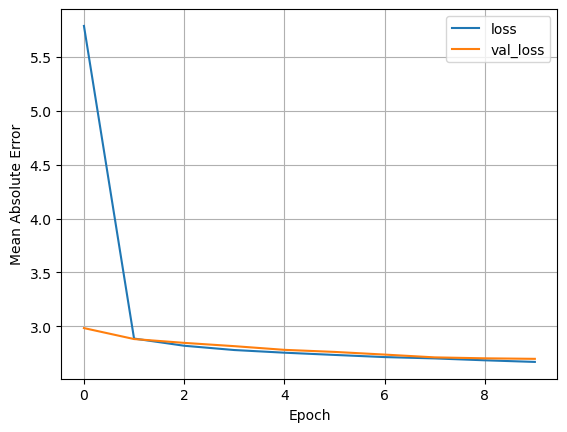

In [9]:
plot_loss(history_5_7_2, metric = 'Mean Absolute Error')

In [19]:
y_pred_5_7_2 = NN_5_7_2.predict(X_test_NN).flatten()
NN_5_7_2_test_R2 = r2_score(y_test_NN, y_pred_5_7_2)
NN_5_7_2_test_MSE = mean_squared_error(y_test_NN, y_pred_5_7_2)
NN_5_7_2_test_MAE = mean_absolute_error(y_test_NN, y_pred_5_7_2)
NN_5_7_2_test_MAPE = mean_absolute_percentage_error(y_test_NN, y_pred_5_7_2)

NN_5_7_2_test_results = pd.DataFrame({"R2" : [NN_5_7_2_test_R2],
                                      "MSE" : [NN_5_7_2_test_MSE],
                                      "MAE" : [NN_5_7_2_test_MAE],
                                      "MAPE" : [NN_5_7_2_test_MAPE],})
NN_5_7_2_test_results

113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.823276,12.664282,2.601731,0.170901


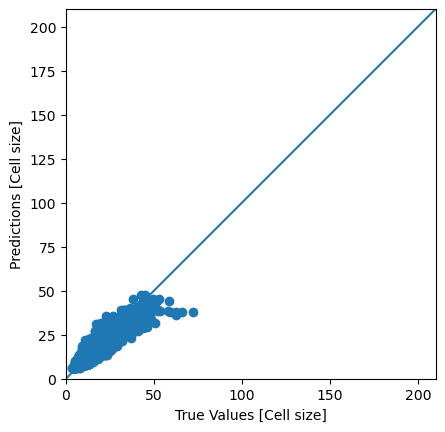

In [20]:
a = plt.axes(aspect='equal')
plt.scatter(y_test_NN, y_pred_5_7_2)
plt.xlabel('True Values [Cell size]')
plt.ylabel('Predictions [Cell size]')
lims = [0, 210]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

COMMENT: The results on looks promising. R2 is above 80% even though the results are without the correction for the uncertainty.

**5.7.3. GridSearch for the best set of parameters.**

Now I want to choose the best model so I'm going to use a grid search with Cross Validation to look for the best set of parameters.

a) Prepare grid of parameters

In [21]:
# preparing grid to search
number_of_layers = [1,2,3,4,5]
number_of_nodes = [5,10,15]
# l2_penalties = [ 0.001, 0.0001, 0.00001, 0.000001, 0.0000001]
batch_sizes = [5, 15, 32]

parameters_grid = dict(n_hidden = number_of_layers, 
                       n_neurons = number_of_nodes,
                       batch_size = batch_sizes)

b) Build and compile model and grid search object.

In [22]:
grid_search_model = KerasRegressor(build_and_compile_model)
grid_search_object = GridSearchCV(estimator=grid_search_model, 
                                  param_grid=parameters_grid)

C:\Users\Stanislaw\AppData\Local\Temp\ipykernel_20092\1224031478.py:1: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  grid_search_model = KerasRegressor(build_and_compile_model)


c) Run grid search

In [23]:
%%time
grid_search_object.fit(X_train_NN, y_train_NN, epochs = 8, validation_data=(X_val_NN,y_val_NN), verbose = 0)

# ----- add sound signal when it's finished -----------
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)


180/180 [==============================] - 0s 2ms/step - loss: 2.6649 - mse: 12.7694
CPU times: total: 1d 57min 15s
Wall time: 1h 49min 24s


GridSearchCV(estimator=<keras.wrappers.scikit_learn.KerasRegressor object at 0x00000183986ABD30>,
             param_grid={'batch_size': [5, 15, 32], 'n_hidden': [1, 2, 3, 4, 5],
                         'n_neurons': [5, 10, 15]})

In [24]:
best_NN_gridsearch = grid_search_object.best_estimator_
# best_NN_gridsearch.save('C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/Best_GridSearch_NN')

In [25]:
grid_search_object.best_params_

{'batch_size': 5, 'n_hidden': 5, 'n_neurons': 10}

Best results were achieved for those parameters: {'batch size': 5, 'n_hidden': 5, 'n_neurons': 10}

d) Check the results on the training set.

In [55]:
best_NN_gridsearch = build_and_compile_model(n_hidden = 5,
                                   n_neurons = 10,
                                   loss_function = 'mae')
best_NN_gridsearch_history = best_NN_gridsearch.fit(X_train_NN, 
                         y_train_NN, 
                         validation_data = (X_val_NN, y_val_NN),
                         epochs = 10,
                         batch_size = 5)

Epoch 1/10
5739/5739 [==============================] - 12s 2ms/step - loss: 3.0502 - mse: 20.2480 - val_loss: 2.6725 - val_mse: 13.7073
Epoch 2/10
5739/5739 [==============================] - 12s 2ms/step - loss: 2.6515 - mse: 13.1628 - val_loss: 2.6017 - val_mse: 12.2445
Epoch 3/10
5739/5739 [==============================] - 12s 2ms/step - loss: 2.6305 - mse: 12.7942 - val_loss: 2.6057 - val_mse: 12.1987
Epoch 4/10
5739/5739 [==============================] - 12s 2ms/step - loss: 2.6187 - mse: 12.6458 - val_loss: 2.5810 - val_mse: 11.9776
Epoch 5/10
5739/5739 [==============================] - 12s 2ms/step - loss: 2.6060 - mse: 12.5437 - val_loss: 2.5895 - val_mse: 12.2302
Epoch 6/10
5739/5739 [==============================] - 11s 2ms/step - loss: 2.6018 - mse: 12.4883 - val_loss: 2.5704 - val_mse: 12.1186
Epoch 7/10
5739/5739 [==============================] - 11s 2ms/step - loss: 2.6028 - mse: 12.4844 - val_loss: 2.5562 - val_mse: 11.8965
Epoch 8/10
5739/5739 [===================

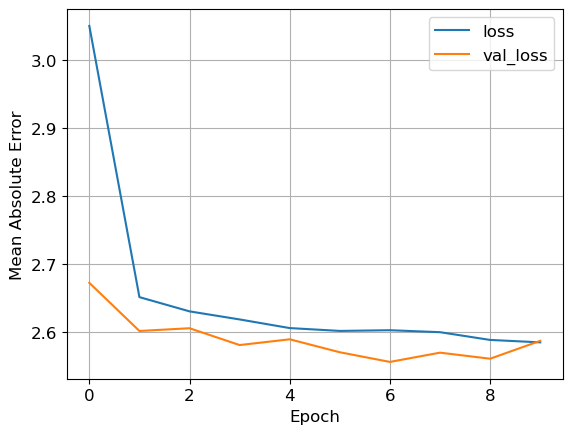

In [57]:
plot_loss(best_NN_gridsearch_history, metric = 'Mean Absolute Error')

In [ ]:
# ----- add sound signal when it's finished -----------
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)


In [58]:
y_pred_5_7_3_train = best_NN_gridsearch.predict(X_train_NN).flatten()
NN_5_7_3_train_R2 = r2_score(y_train_NN, y_pred_5_7_3_train)
NN_5_7_3_train_MSE = mean_squared_error(y_train_NN, y_pred_5_7_3_train)
NN_5_7_3_train_MAE = mean_absolute_error(y_train_NN, y_pred_5_7_3_train)
NN_5_7_3_train_MAPE = mean_absolute_percentage_error(y_train_NN, y_pred_5_7_3_train)

NN_5_7_3_train_results = pd.DataFrame({"R2" : [NN_5_7_3_train_R2],
                                      "MSE" : [NN_5_7_3_train_MSE],
                                      "MAE" : [NN_5_7_3_train_MAE],
                                      "MAPE" : [NN_5_7_3_train_MAPE],})
NN_5_7_3_train_results

897/897 [==============================] - 1s 1ms/step


,R2,MSE,MAE,MAPE
0,0.840156,11.898776,2.524086,0.167071


e) Check the results on the validation set.

In [59]:
y_pred_5_7_3_val = best_NN_gridsearch.predict(X_val_NN).flatten()
NN_5_7_3_val_R2 = r2_score(y_val_NN, y_pred_5_7_3_val)
NN_5_7_3_val_MSE = mean_squared_error(y_val_NN, y_pred_5_7_3_val)
NN_5_7_3_val_MAE = mean_absolute_error(y_val_NN, y_pred_5_7_3_val)
NN_5_7_3_val_MAPE = mean_absolute_percentage_error(y_val_NN, y_pred_5_7_3_val)

NN_5_7_3_val_results = pd.DataFrame({"R2" : [NN_5_7_3_val_R2],
                                      "MSE" : [NN_5_7_3_val_MSE],
                                      "MAE" : [NN_5_7_3_val_MAE],
                                      "MAPE" : [NN_5_7_3_val_MAPE],})
NN_5_7_3_val_results

113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.842156,11.855732,2.549604,0.166843


f) Check the results on the test set.

In [60]:
y_pred_5_7_3_test = best_NN_gridsearch.predict(X_test_NN).flatten()
NN_5_7_3_test_R2 = r2_score(y_test_NN, y_pred_5_7_3_test)
NN_5_7_3_test_MSE = mean_squared_error(y_test_NN, y_pred_5_7_3_test)
NN_5_7_3_test_MAE = mean_absolute_error(y_test_NN, y_pred_5_7_3_test)
NN_5_7_3_test_MAPE = mean_absolute_percentage_error(y_test_NN, y_pred_5_7_3_test)

NN_5_7_3_test_results = pd.DataFrame({"R2" : [NN_5_7_3_test_R2],
                                      "MSE" : [NN_5_7_3_test_MSE],
                                      "MAE" : [NN_5_7_3_test_MAE],
                                      "MAPE" : [NN_5_7_3_test_MAPE],})
NN_5_7_3_test_results

113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.843185,11.622162,2.500204,0.16461


In [61]:
train_val_test_results = pd.concat([NN_5_7_3_train_results, NN_5_7_3_val_results, NN_5_7_3_test_results], ignore_index = True)
train_val_test_results.insert(loc=0,
                              column='Dataset',
                              value= ['Training', 'Validation', 'Test'])
train_val_test_results

,Dataset,R2,MSE,MAE,MAPE
0,Training,0.840156,11.898776,2.524086,0.167071
1,Validation,0.842156,11.855732,2.549604,0.166843
2,Test,0.843185,11.622162,2.500204,0.164610


COMMENT: The best NN achieved comparable results with R2 between 82% and 84% for all three datasets. MSE was even smaller for a test set but this one is very sensitive to extreme values and it might be because more extreme values were present in the training set. MAE and MAPE are comparable across all datasets which means the model is stable. Additionaly those results are achieved without taking into consideration a correction for experimental uncertainty which means they are better then those of linear regression and SVR.

g) Introduce experimental uncertainty correction.

In [64]:
NN_general_params_test_results, y_test_NN_general_params_mod = results_with_exp_uncertainty(y_test=y_test_NN,
                                                                                            y_pred=y_pred_5_7_3_test,
                                                                                            uncertaity=0.2)
display(NN_general_params_test_results)

,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.843185,11.622162,2.500204,0.164610
1,Uncertainty correction,0.978568,1.454053,0.463474,0.028941


COMMENT: When a correction for uncertainty is introduced the results rose significantly. R2 is almost 98%, MSE dropped to 1.3 from 11, MAE from 2.5 to 0.4 and MAPE from 16% to 3%. Those results are very good.

#### 5.8. Fitting a 'general' model using NN.

Now i want to try to fit a 'genral' model that will use only general parameters of a mixture without showing what are the gases that creates the mixture. This is to see if using those parameters like density, pressure, enthalpy, mean molar weight etc. i can create model that will generalize well for example on mixtures with air. The data fot those mixtures is very limited so if i would be able to do that i would be great.

**5.8.1. Getting general gas properties using Cantera.**

The parameters that I want to extract are as follows:
1. Density
2. Pressure
3. Mean molar weight
4. Molar weight of the oxidizer
5. Molar weight of the fuel
6. Enthalpy
7. Internal energy
8. Entrophy
9. Gibbs function

a) Function to get the parameters from Cantera

*This function was moved to the top of the document.*

b) Calculate general parameters for unique cases in the data_for_modeling dataset

In [29]:
unique_cases = data_for_modeling[['phi', 'p0','ch4']].drop_duplicates().reset_index(drop=True)

In [30]:
results_list = []

for idx, row in unique_cases.iterrows():
    results_list.append(get_cantera_parameters(p0 = row['p0'],
                                               phi = row['phi'], 
                                               CH4 = row['ch4'],
                                               H2 = 0.0,
                                               air = False,
                                               T0 = 293,
                                               diluent = False, 
                                               diluent_fraction = 0.0,
                                               zhang = False]))
unique_cases['general_parameters'] = results_list

In [31]:
new_columns = ['density_mole', 
               'mean_molecular_weight', 
               'enthalpy_mole',
               'int_energy_mole', 
               'entropy_mole', 
               'gibbs_mole', 
               'fuel_molecular_weight', 
               'oxidizer_molecular_weight',
               'inert_molecular_weight']
unique_cases[new_columns] = pd.DataFrame(unique_cases['general_parameters'].values.tolist(), index=unique_cases.index)
unique_cases = unique_cases.drop(columns=['general_parameters'])

In [32]:
unique_cases.tail()

,phi,p0,ch4,density_mole,mean_molecular_weight,enthalpy_mole,int_energy_mole,entropy_mole,gibbs_mole,fuel_molecular_weight,oxidizer_molecular_weight,inert_molecular_weight
216,0.75,1.4,0.65,0.057468,29.741817,-6.829224e+07,-7.072838e+07,205975.830109,-1.286432e+08,3.815104,20.291415,5.635299
217,1.25,0.9,0.65,0.036944,28.975010,-9.145128e+07,-9.388741e+07,209463.781169,-1.528242e+08,5.111740,16.312706,7.550564
218,1.25,1.2,0.65,0.049258,28.975010,-9.145128e+07,-9.388741e+07,207071.859332,-1.521233e+08,5.111740,16.312706,7.550564
219,1.25,1.4,0.65,0.057468,28.975010,-9.145128e+07,-9.388741e+07,205790.179267,-1.517478e+08,5.111740,16.312706,7.550564
220,1.25,1.6,0.65,0.065678,28.975010,-9.145128e+07,-9.388741e+07,204679.937495,-1.514225e+08,5.111740,16.312706,7.550564


c) Join calculated parameters with the data for modeling.

In [33]:
print(unique_cases.columns)
print(data_for_modeling.columns)

Index(['phi', 'p0', 'ch4', 'density_mole', 'mean_molecular_weight',
       'enthalpy_mole', 'int_energy_mole', 'entropy_mole', 'gibbs_mole',
       'fuel_molecular_weight', 'oxidizer_molecular_weight',
       'inert_molecular_weight'],
      dtype='object')
Index(['phi', 'p0', 'ch4', 'phi^2', '1/p0', 'ln(p0)', 'phi*p0', 'phi*ch4',
       'p0*ch4', 'Cell_size'],
      dtype='object')


In [34]:
data_for_modeling_general = data_for_modeling[['phi', 'p0', 'ch4', '1/p0', 'ln(p0)', 'Cell_size']].merge(right    = unique_cases,
                                                                                                         how      = 'left',
                                                                                                         left_on  = ['phi', 'p0', 'ch4'],
                                                                                                         right_on = ['phi', 'p0', 'ch4'],
                                                                                                         )

In [35]:
new_cols = [col for col in data_for_modeling_general.columns if col != 'Cell_size'] + ['Cell_size']
data_for_modeling_general = data_for_modeling_general[new_cols]
data_for_modeling_general= data_for_modeling_general.drop(columns=['phi','ch4'])

In [36]:
data_for_modeling_general.tail()

,p0,1/p0,ln(p0),density_mole,mean_molecular_weight,enthalpy_mole,int_energy_mole,entropy_mole,gibbs_mole,fuel_molecular_weight,oxidizer_molecular_weight,inert_molecular_weight,Cell_size
35863,1.6,0.625,0.470004,0.065678,28.97501,-9.145128e+07,-9.388741e+07,204679.937495,-1.514225e+08,5.11174,16.312706,7.550564,10.689745
35864,1.6,0.625,0.470004,0.065678,28.97501,-9.145128e+07,-9.388741e+07,204679.937495,-1.514225e+08,5.11174,16.312706,7.550564,10.712868
35865,1.6,0.625,0.470004,0.065678,28.97501,-9.145128e+07,-9.388741e+07,204679.937495,-1.514225e+08,5.11174,16.312706,7.550564,10.868206
35866,1.6,0.625,0.470004,0.065678,28.97501,-9.145128e+07,-9.388741e+07,204679.937495,-1.514225e+08,5.11174,16.312706,7.550564,10.956558
35867,1.6,0.625,0.470004,0.065678,28.97501,-9.145128e+07,-9.388741e+07,204679.937495,-1.514225e+08,5.11174,16.312706,7.550564,11.018106


d) Save the dataset

In [37]:
data_for_modeling_general.to_csv(path_or_buf="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_for_modeling_general.csv",
                        sep = ';',
                        index = False,
                        encoding = 'utf-8')


e) Load the dataset

In [8]:
data_for_modeling_general = pd.read_csv(filepath_or_buffer="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_for_modeling_general.csv",
                        sep = ';',
                        decimal = '.',
                        encoding = 'utf-8')


**5.8.2. Prepare data for fitting the model.**

In [27]:
X_general = data_for_modeling_general.iloc[:, :-1]
y_general = data_for_modeling_general.iloc[:,  -1]

# divide into training and test set.
X_train_gen, X_test_gen, y_train_gen, y_test_gen = train_test_split(X_general, y_general, test_size = 0.2)
X_val_gen, X_test_gen, y_val_gen, y_test_gen = train_test_split(X_test_gen, y_test_gen, test_size = 0.5)

# scale the data
sc_X_gen    = StandardScaler()
X_train_gen = sc_X_gen.fit_transform(X_train_gen)
X_val_gen   = sc_X_gen.transform(X_val_gen)
X_test_gen  = sc_X_gen.transform(X_test_gen)


**5.8.3. Create first NN.**

I am creating first NN with some values to check if the idea of using general parameters is feasible and will render useful results.

a) Build and compile model

In [42]:
NN_5_8_3 = build_and_compile_model(n_hidden = 3,
                                   n_neurons = 15,
                                   loss_function = 'mae')

b) Train model

In [44]:
%%time
# train model
keras.backend.clear_session()
history_NN_5_8_3 = NN_5_8_3.fit(X_train_gen, 
                         y_train_gen, 
                         validation_data = (X_val_gen, y_val_gen),
                         epochs = 10)



Epoch 1/10
897/897 [==============================] - 4s 3ms/step - loss: 5.0601 - mse: 62.7199 - val_loss: 2.8693 - val_mse: 15.0167
Epoch 2/10
897/897 [==============================] - 2s 2ms/step - loss: 2.7607 - mse: 14.2930 - val_loss: 2.7403 - val_mse: 13.7251
Epoch 3/10
897/897 [==============================] - 2s 2ms/step - loss: 2.6906 - mse: 13.6270 - val_loss: 2.7069 - val_mse: 13.4864
Epoch 4/10
897/897 [==============================] - 2s 3ms/step - loss: 2.6635 - mse: 13.2787 - val_loss: 2.6802 - val_mse: 13.1022
Epoch 5/10
897/897 [==============================] - 2s 2ms/step - loss: 2.6401 - mse: 12.9826 - val_loss: 2.6780 - val_mse: 13.0452
Epoch 6/10
897/897 [==============================] - 2s 2ms/step - loss: 2.6305 - mse: 12.9348 - val_loss: 2.6710 - val_mse: 12.7810
Epoch 7/10
897/897 [==============================] - 2s 2ms/step - loss: 2.6205 - mse: 12.7845 - val_loss: 2.6711 - val_mse: 13.1639
Epoch 8/10
897/897 [==============================] - 2s 2ms/s

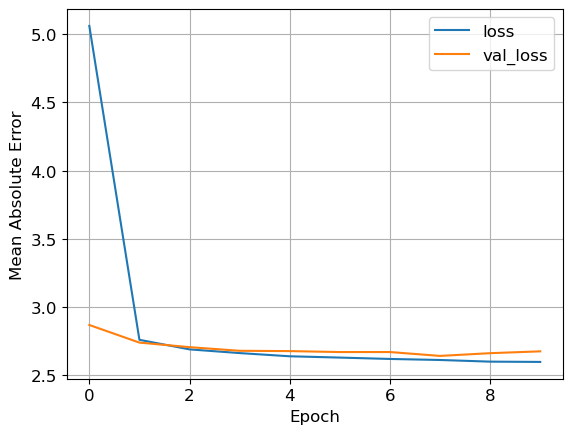

In [45]:
plot_loss(history_NN_5_8_3, metric = 'Mean Absolute Error')

c) Check the results on the training set.

In [46]:
y_pred_5_8_3_train = NN_5_8_3.predict(X_train_gen).flatten()
NN_5_8_3_train_R2 = r2_score(y_train_gen, y_pred_5_8_3_train)
NN_5_8_3_train_MSE = mean_squared_error(y_train_gen, y_pred_5_8_3_train)
NN_5_8_3_train_MAE = mean_absolute_error(y_train_gen, y_pred_5_8_3_train)
NN_5_8_3_train_MAPE = mean_absolute_percentage_error(y_train_gen, y_pred_5_8_3_train)

NN_5_8_3_train_results = pd.DataFrame({"R2"  : [NN_5_8_3_train_R2],
                                      "MSE"  : [NN_5_8_3_train_MSE],
                                      "MAE"  : [NN_5_8_3_train_MAE],
                                      "MAPE" : [NN_5_8_3_train_MAPE],})
NN_5_8_3_train_results

897/897 [==============================] - 1s 1ms/step


,R2,MSE,MAE,MAPE
0,0.832274,12.477349,2.585042,0.172512


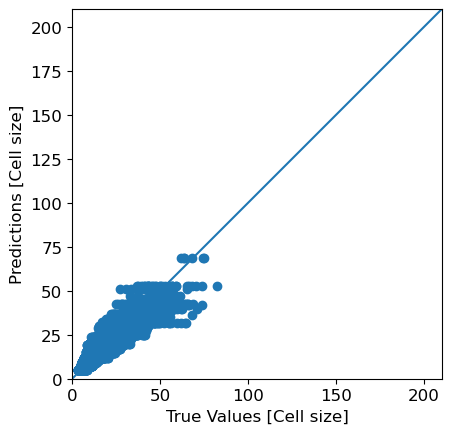

In [47]:
a = plt.axes(aspect='equal')
plt.scatter(y_train_gen, y_pred_5_8_3_train)
plt.xlabel('True Values [Cell size]')
plt.ylabel('Predictions [Cell size]')
lims = [0, 210]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

d) Check the results on the test set.

In [48]:
y_pred_5_8_3 = NN_5_8_3.predict(X_test_gen).flatten()
NN_5_8_3_test_R2 = r2_score(y_test_gen, y_pred_5_8_3)
NN_5_8_3_test_MSE = mean_squared_error(y_test_gen, y_pred_5_8_3)
NN_5_8_3_test_MAE = mean_absolute_error(y_test_gen, y_pred_5_8_3)
NN_5_8_3_test_MAPE = mean_absolute_percentage_error(y_test_gen, y_pred_5_8_3)

NN_5_8_3_test_results = pd.DataFrame({"R2" : [NN_5_8_3_test_R2],
                                      "MSE" : [NN_5_8_3_test_MSE],
                                      "MAE" : [NN_5_8_3_test_MAE],
                                      "MAPE" : [NN_5_8_3_test_MAPE],})
NN_5_8_3_test_results

113/113 [==============================] - 0s 2ms/step


,R2,MSE,MAE,MAPE
0,0.84394,11.979644,2.53378,0.192752


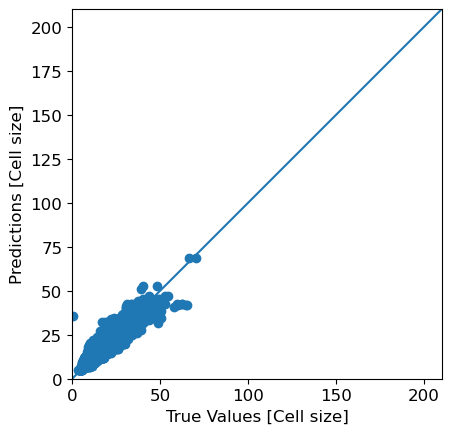

In [49]:
a = plt.axes(aspect='equal')
plt.scatter(y_test_gen, y_pred_5_8_3)
plt.xlabel('True Values [Cell size]')
plt.ylabel('Predictions [Cell size]')
lims = [0, 210]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

COMMENT: The results on looks promising. R2 is around 80% even though the results are without the correction for the uncertainty.

**5.8.4. GridSearch for the best set of parameters.**

Now I want to choose the best model so I'm going to use a grid search with Cross Validation to look for the best set of parameters.

a) Prepare grid of parameters.

In [50]:
# preparing grid to search
number_of_layers = [1,2,3,4,5]
number_of_nodes = [5,10,15]
# l2_penalties = [ 0.001, 0.0001, 0.00001, 0.000001, 0.0000001]
batch_sizes = [ 16, 32]

parameters_grid = dict(n_hidden = number_of_layers, 
                       n_neurons = number_of_nodes,
                       batch_size = batch_sizes)

b) Build and compile model and grid search object.

In [51]:
grid_search_model = KerasRegressor(build_and_compile_model)
grid_search_object = GridSearchCV(estimator=grid_search_model, 
                                  param_grid=parameters_grid)

C:\Users\Stanislaw\AppData\Local\Temp\ipykernel_10304\1224031478.py:1: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  grid_search_model = KerasRegressor(build_and_compile_model)


c) Run grid search

In [52]:
%%time
grid_search_object.fit(X_train_gen, y_train_gen, epochs = 8, validation_data=(X_val_gen,y_val_gen), verbose = 0)

# ----- add sound signal when it's finished -----------
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)


180/180 [==============================] - 0s 2ms/step - loss: 2.5828 - mse: 12.3436
CPU times: total: 8h 37min 41s
Wall time: 44min 39s


In [53]:
best_NN_gridsearch = grid_search_object.best_estimator_

In [54]:
grid_search_object.best_params_

{'batch_size': 16, 'n_hidden': 3, 'n_neurons': 15}

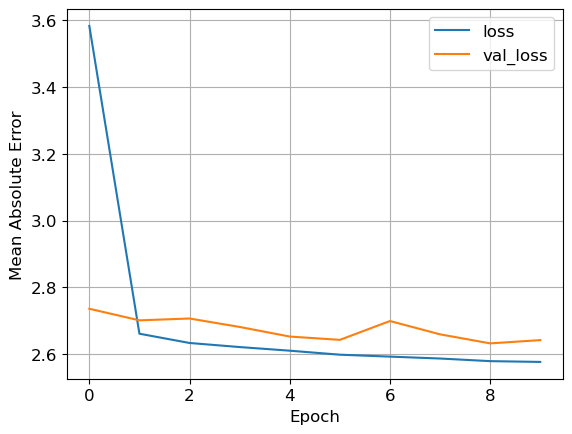

In [37]:
best_NN_gridsearch = build_and_compile_model(n_hidden = 3,
                                   n_neurons = 15,
                                   loss_function = 'mae')
history_test=best_NN_gridsearch.fit(X_train_gen, y_train_gen, epochs = 10, validation_data=(X_val_gen,y_val_gen), verbose = 0, batch_size=16)
plot_loss(history_test, metric = 'Mean Absolute Error')

In [57]:
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)

Best results were achieved for those parameters: {'batch size': 16, 'n_hidden': 3, 'n_neurons': 15}

d) Check the results on the training set.

In [38]:
y_pred_5_8_4_train = best_NN_gridsearch.predict(X_train_gen).flatten()
NN_5_8_4_train_R2 = r2_score(y_train_gen, y_pred_5_8_4_train)
NN_5_8_4_train_MSE = mean_squared_error(y_train_gen, y_pred_5_8_4_train)
NN_5_8_4_train_MAE = mean_absolute_error(y_train_gen, y_pred_5_8_4_train)
NN_5_8_4_train_MAPE = mean_absolute_percentage_error(y_train_gen, y_pred_5_8_4_train)

NN_5_8_4_train_results = pd.DataFrame({"R2" :  [NN_5_8_4_train_R2],
                                      "MSE" :  [NN_5_8_4_train_MSE],
                                      "MAE" :  [NN_5_8_4_train_MAE],
                                      "MAPE" : [NN_5_8_4_train_MAPE],})
NN_5_8_4_train_results

897/897 [==============================] - 1s 1ms/step


,R2,MSE,MAE,MAPE
0,0.840816,11.746818,2.515036,0.169103


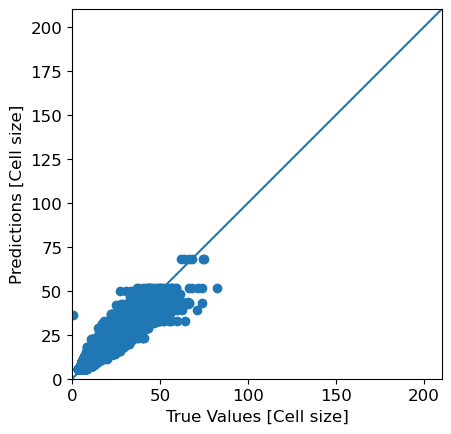

In [39]:
a = plt.axes(aspect='equal')
plt.scatter(y_train_gen, y_pred_5_8_4_train)
plt.xlabel('True Values [Cell size]')
plt.ylabel('Predictions [Cell size]')
lims = [0, 210]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

e) Check the results on the validation set.

In [40]:
y_pred_5_8_4_val = best_NN_gridsearch.predict(X_val_gen).flatten()
NN_5_8_4_val_R2 = r2_score(y_val_gen, y_pred_5_8_4_val)
NN_5_8_4_val_MSE = mean_squared_error(y_val_gen, y_pred_5_8_4_val)
NN_5_8_4_val_MAE = mean_absolute_error(y_val_gen, y_pred_5_8_4_val)
NN_5_8_4_val_MAPE = mean_absolute_percentage_error(y_val_gen, y_pred_5_8_4_val)

NN_5_8_4_val_results = pd.DataFrame({"R2"    : [NN_5_8_4_val_R2],
                                      "MSE"  : [NN_5_8_4_val_MSE],
                                      "MAE"  : [NN_5_8_4_val_MAE],
                                      "MAPE" : [NN_5_8_4_val_MAPE],})
NN_5_8_4_val_results


113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.830592,12.884555,2.598573,0.169449


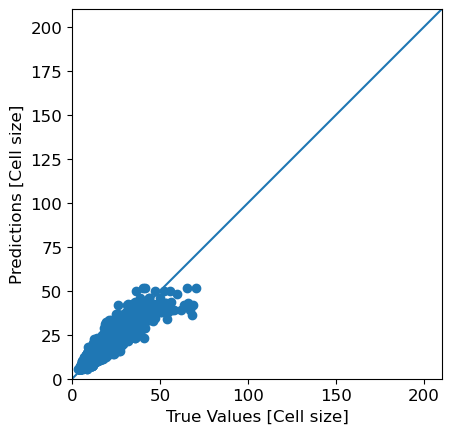

In [41]:
a = plt.axes(aspect='equal')
plt.scatter(y_val_gen, y_pred_5_8_4_val)
plt.xlabel('True Values [Cell size]')
plt.ylabel('Predictions [Cell size]')
lims = [0, 210]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

f) Check the resuts on the test set.

In [42]:
y_pred_5_8_4_test = best_NN_gridsearch.predict(X_test_gen).flatten()
NN_5_8_4_test_R2 = r2_score(y_test_gen, y_pred_5_8_4_test)
NN_5_8_4_test_MSE = mean_squared_error(y_test_gen, y_pred_5_8_4_test)
NN_5_8_4_test_MAE = mean_absolute_error(y_test_gen, y_pred_5_8_4_test)
NN_5_8_4_test_MAPE = mean_absolute_percentage_error(y_test_gen, y_pred_5_8_4_test)

NN_5_8_4_test_results = pd.DataFrame({"R2"   : [NN_5_8_4_test_R2],
                                      "MSE"  : [NN_5_8_4_test_MSE],
                                      "MAE"  : [NN_5_8_4_test_MAE],
                                      "MAPE" : [NN_5_8_4_test_MAPE],})
NN_5_8_4_test_results

113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.83782,12.705103,2.567306,0.172524


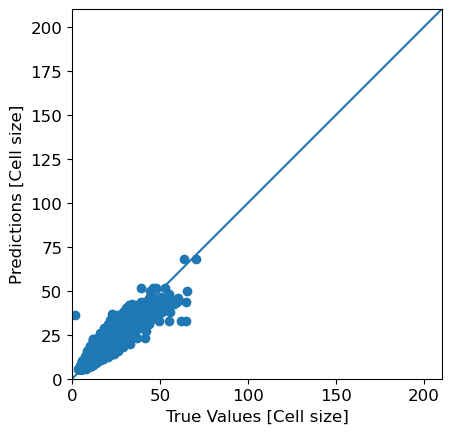

In [43]:
a = plt.axes(aspect='equal')
plt.scatter(y_test_gen, y_pred_5_8_4_test)
plt.xlabel('True Values [Cell size]')
plt.ylabel('Predictions [Cell size]')
lims = [0, 210]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

g) Check results after taking into consideration experimental uncertainty correction.

In [44]:
results, y_test_gen_mod = results_with_exp_uncertainty(y_test=y_test_gen,
                             y_pred=y_pred_5_8_4_test,
                             uncertaity=0.2)
results

,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.837820,12.705103,2.567306,0.172524
1,Uncertainty correction,0.969306,2.082891,0.504852,0.030349


COMMENT: The results using 'general' model are very good, the same as using phi,  p0 and %CH4. This is however expectabl. Now, I'd like to try this model to predict cell size for new mixtures that are rather outside of what it has seen during training. Those are going to be:
1. pure methane with pure oxygen
2. pure methan with air
3. biogas with hydrogen addition with air.

**5.8.5. Check results on the data outside from training set range of parameters.**

a) Load and transform the data from the literature.

In [58]:
data_from_literature_general = pd.read_csv(filepath_or_buffer="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_from_literature.csv",
                        sep = ';',
                        decimal = ',',
                        encoding = 'utf-8')

# drop last column being literature reference
data_from_literature_general = data_from_literature_general.drop(columns = ['Literature'])
data_from_literature_general['p0'] = data_from_literature_general['p0']/100

In [46]:
data_from_literature_general.head()

,phi,p0,ch4,h2,air,diluent,diluent_fraction,zhang,Cell_size,Comment
0,1.0,0.066250,1.0,0,False,False,0.0,False,85.7303,NaN
1,1.0,0.079723,1.0,0,False,False,0.0,False,70.6086,NaN
2,1.0,0.093399,1.0,0,False,False,0.0,False,55.9179,NaN
3,1.0,0.120344,1.0,0,False,False,0.0,False,40.4519,NaN
4,1.0,0.134425,1.0,0,False,False,0.0,False,35.0807,NaN


In [59]:
X_lit = data_from_literature_general.iloc[:, :-2]
X_lit['1/p0'] = 1/X_lit['p0']
X_lit['ln(p0)'] = np.log(X_lit['p0'])

y_lit = data_from_literature_general.iloc[:,  -2]

In [60]:
X_lit.head(1)

,phi,p0,ch4,h2,air,diluent,diluent_fraction,zhang,1/p0,ln(p0)
0,1.0,0.06625,1.0,0,False,False,0.0,False,15.094294,-2.714317


In [32]:
y_lit.head(3)

0    85.7303
1    70.6086
2    55.9179
Name: Cell_size, dtype: float64

b) Calculate the 'general' parameters using Cantera.

In [61]:
results_list = []

for idx, row in X_lit.iterrows():
    results_list.append(get_cantera_parameters(p0 = row['p0'],
                                               phi = row['phi'], 
                                               CH4 = row['ch4'],
                                               H2 = 0.0,
                                               air = row['air'],
                                               T0 = 293,
                                               diluent = row['diluent'], 
                                               diluent_fraction = row['diluent_fraction'],
                                               zhang=row['zhang']))
X_lit['general_parameters'] = results_list

In [62]:
X_lit.head(1)

,phi,p0,ch4,h2,air,diluent,diluent_fraction,zhang,1/p0,ln(p0),general_parameters
0,1.0,0.06625,1.0,0,False,False,0.0,False,15.094294,-2.714317,"(0.0027194769884135175, 26.679666666666666, -2..."


In [51]:
new_columns = ['density_mole', 
               'mean_molecular_weight', 
               'enthalpy_mole',
               'int_energy_mole', 
               'entropy_mole', 
               'gibbs_mole', 
               'fuel_molecular_weight', 
               'oxidizer_molecular_weight',
               'inert_molecular_weight']
X_lit[new_columns] = pd.DataFrame(X_lit['general_parameters'].values.tolist(), index=X_lit.index)
X_lit = X_lit.drop(columns=['general_parameters'])
X_lit = X_lit[['p0', '1/p0', 'ln(p0)', 'density_mole', 'mean_molecular_weight',
       'enthalpy_mole', 'int_energy_mole', 'entropy_mole', 'gibbs_mole',
       'fuel_molecular_weight', 'oxidizer_molecular_weight',
       'inert_molecular_weight']]

X_lit   = sc_X_gen.transform(X_lit)

c) Check te results on the literature set.

In [53]:
y_pred_literature = best_NN_gridsearch.predict(X_lit).flatten()
NN_literature_R2 = r2_score(y_lit, y_pred_literature)
NN_literature_MSE = mean_squared_error(y_lit, y_pred_literature)
NN_literature_MAE = mean_absolute_error(y_lit, y_pred_literature)
NN_literature_MAPE = mean_absolute_percentage_error(y_lit, y_pred_literature)

NN_literature_results = pd.DataFrame({"R2"   : [NN_literature_R2],
                                      "MSE"  : [NN_literature_MSE],
                                      "MAE"  : [NN_literature_MAE],
                                      "MAPE" : [NN_literature_MAPE],})
NN_literature_results

4/4 [==============================] - 0s 2ms/step


,R2,MSE,MAE,MAPE
0,-0.219575,45325.299612,104.9533,2.112933


In [54]:
X_y_lit_comb = data_from_literature_general
X_y_lit_comb['Predictions'] = y_pred_literature
fig = go.Figure()
fig.add_trace(go.Scatter(x = X_y_lit_comb['Cell_size'], 
                         y = X_y_lit_comb['Predictions'], 
                         mode = 'markers', 
                         name = "NN Literature",
                         customdata=X_y_lit_comb[['phi','p0','ch4', 'h2','air','diluent']],
                         hovertemplate = 'Phi: %{customdata[0]}<br>p0: %{customdata[1]:1.3f}[bar]<br>CH4:%{customdata[2]}<br>H2:%{customdata[3]}<br>air:%{customdata[4]}<br>diluent:%{customdata[5]}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))

fig.update_layout(
                title=f"Training set: Predicted values vs real values",
                xaxis_title="True Values [Cell size]",
                yaxis_title="Predictions [Cell size]",
                legend_title = 'Model:',
                yaxis_range=[0,250],
                xaxis_range=[0,250],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

COMMENT: The results are totally off, resulting in R2 <0. This is expectable because the input mixtures were totally different than those on which the model was trained.

#### 5.9. NN witout scaling the features.

One of the reasons that the results are so off might be the fact that the input data is scaled using scaler fitted on the training data and that differ a lot from the data gathered from the literature. Although, it's generally not reccommended, i want to try to fit the model on the data that is not scaled.

In [ ]:
X_general = data_for_modeling_general.iloc[:, :-1]
y_general = data_for_modeling_general.iloc[:,  -1]

# divide into training and test set.
X_train_gen, X_test_gen, y_train_gen, y_test_gen = train_test_split(X_general, y_general, test_size = 0.2)
X_val_gen, X_test_gen, y_val_gen, y_test_gen = train_test_split(X_test_gen, y_test_gen, test_size = 0.5)

In [27]:
NN_5_9 = build_and_compile_model(n_hidden = 3,
                                   n_neurons = 15,
                                   loss_function = 'mae')

In [29]:
%%time
# train model
keras.backend.clear_session()
history_NN_5_9 = NN_5_9.fit(X_train_gen, 
                         y_train_gen, 
                         validation_data = (X_val_gen, y_val_gen),
                         epochs = 40)



Epoch 1/40
897/897 [==============================] - 3s 2ms/step - loss: 128386.9375 - mse: 502147088384.0000 - val_loss: 30558.4648 - val_mse: 1008109696.0000
Epoch 2/40
897/897 [==============================] - 2s 2ms/step - loss: 18783.8457 - mse: 641037184.0000 - val_loss: 32532.0195 - val_mse: 1108334336.0000
Epoch 3/40
897/897 [==============================] - 2s 2ms/step - loss: 12515.2510 - mse: 254963440.0000 - val_loss: 24837.7031 - val_mse: 643321344.0000
Epoch 4/40
897/897 [==============================] - 2s 2ms/step - loss: 8072.1357 - mse: 124067248.0000 - val_loss: 4275.1494 - val_mse: 21164494.0000
Epoch 5/40
897/897 [==============================] - 2s 2ms/step - loss: 6378.2100 - mse: 65108840.0000 - val_loss: 8712.1348 - val_mse: 81308920.0000
Epoch 6/40
897/897 [==============================] - 2s 2ms/step - loss: 2761.7246 - mse: 13689742.0000 - val_loss: 1325.3146 - val_mse: 2421704.2500
Epoch 7/40
897/897 [==============================] - 2s 2ms/step - lo

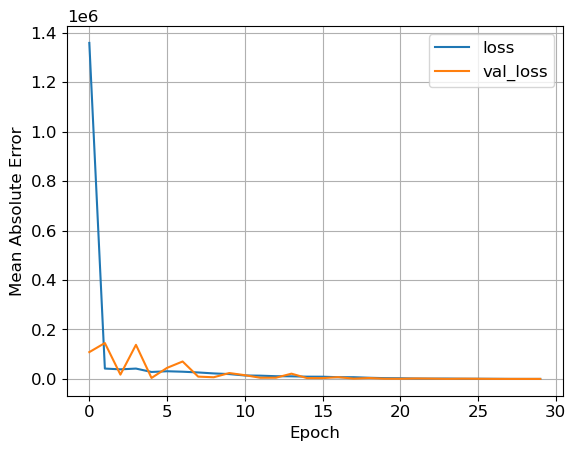

In [20]:
plot_loss(history_NN_5_9, metric = 'Mean Absolute Error')

897/897 [==============================] - 1s 1ms/step
         R2        MSE       MAE      MAPE
0 -0.069888  79.463092  6.259194  0.401029


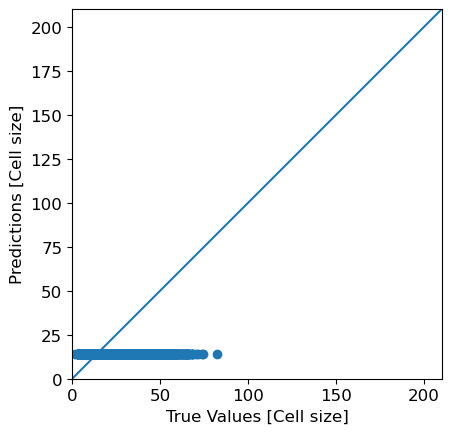

In [33]:
y_pred_5_9_train = NN_5_9.predict(X_train_gen).flatten()
print(results(y_pred=y_pred_5_9_train, y=y_train_gen))


The results are totally off, even worse than those from model trained on the scaled data.

#### 5.10. NN trained on averages with taking into account literature data.

**5.10.1. Load the data.**

In [9]:
X_general = data_for_modeling_general.iloc[:, :-1]
y_general = data_for_modeling_general.iloc[:,  -1]

In [10]:
data_from_literature_general = pd.read_csv(filepath_or_buffer="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_from_literature.csv",
                        sep = ';',
                        decimal = ',',
                        encoding = 'utf-8')

# drop last column being literature reference
data_from_literature_general = data_from_literature_general.drop(columns = ['Literature'])
data_from_literature_general['p0'] = data_from_literature_general['p0']/100

In [12]:
X_lit = data_from_literature_general.iloc[:, :-2]
X_lit['1/p0'] = 1/X_lit['p0']
X_lit['ln(p0)'] = np.log(X_lit['p0'])

y_lit = data_from_literature_general.iloc[:,  -2]

In [13]:
results_list = []

for idx, row in X_lit.iterrows():
    results_list.append(get_cantera_parameters(p0 = row['p0'],
                                               phi = row['phi'], 
                                               CH4 = row['ch4'],
                                               H2 = 0.0,
                                               air = row['air'],
                                               T0 = 293,
                                               diluent = row['diluent'], 
                                               diluent_fraction = row['diluent_fraction'],
                                               zhang=row['zhang']))
X_lit['general_parameters'] = results_list

In [14]:
new_columns = ['density_mole', 
               'mean_molecular_weight', 
               'enthalpy_mole',
               'int_energy_mole', 
               'entropy_mole', 
               'gibbs_mole', 
               'fuel_molecular_weight', 
               'oxidizer_molecular_weight',
               'inert_molecular_weight']
input_features = ['p0', '1/p0', 'ln(p0)', 'density_mole', 'mean_molecular_weight',
       'enthalpy_mole', 'int_energy_mole', 'entropy_mole', 'gibbs_mole',
       'fuel_molecular_weight', 'oxidizer_molecular_weight',
       'inert_molecular_weight']
X_lit[new_columns] = pd.DataFrame(X_lit['general_parameters'].values.tolist(), index=X_lit.index)
X_lit = X_lit.drop(columns=['general_parameters'])
X_lit = X_lit[input_features]

In [15]:
X_lit_gen = pd.concat([X_general, X_lit], ignore_index=True)
y_lit_gen = pd.concat([y_general, y_lit], ignore_index=True)

In [16]:
print(X_lit_gen.shape)
print(y_lit_gen.shape)

(35996, 12)
(35996,)


**5.10.2. Transform the data.**

In [19]:
# calculate means from traning set
X_y_lit_gen = pd.concat([X_lit_gen, y_lit_gen], axis=1)
X_y_lit_gen = X_y_lit_gen.groupby(list(X_y_lit_gen.columns[:-1])).agg(['mean']).reset_index()
X_y_lit_gen.columns = X_y_lit_gen.columns.droplevel(1)

# recreate X_lit_gen and y_lit_gen
X_lit_gen = X_y_lit_gen.iloc[:,:-1]
y_lit_gen = X_y_lit_gen.iloc[:, -1]

In [20]:
# divide into training and test set.
X_train_lit_gen, X_test_lit_gen, y_train_lit_gen, y_test_lit_gen = train_test_split(X_lit_gen, y_lit_gen, test_size = 0.2)
X_val_lit_gen, X_test_lit_gen, y_val_lit_gen, y_test_lit_gen = train_test_split(X_test_lit_gen, y_test_lit_gen, test_size = 0.5)

# scale the data
sc_X_lit_gen    = StandardScaler()
X_train_lit_gen = sc_X_lit_gen.fit_transform(X_train_lit_gen)
X_val_lit_gen   = sc_X_lit_gen.transform(X_val_lit_gen)
X_test_lit_gen  = sc_X_lit_gen.transform(X_test_lit_gen)


**5.10.3. Create first NN.**

a) Build and compile model.

In [53]:
NN_5_10 = build_and_compile_model(n_hidden = 2,
                                   n_neurons = 10,
                                   loss_function = 'mae')

b) Train model.

CPU times: total: 51.8 s
Wall time: 4.43 s


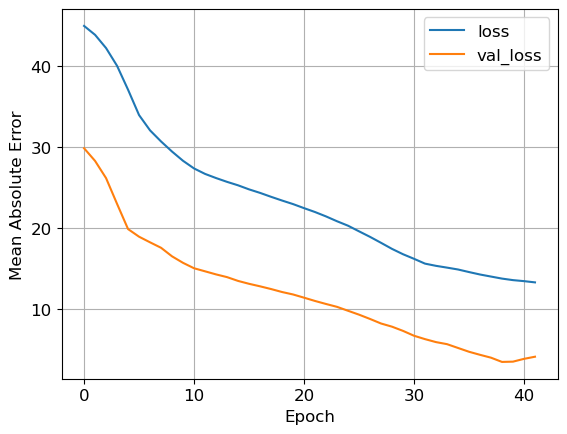

In [54]:
%%time
# train model
keras.backend.clear_session()
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)
history_5_10 = NN_5_10.fit(X_train_lit_gen, 
                         y_train_lit_gen, 
                         validation_data = (X_val_lit_gen, y_val_lit_gen),
                         epochs = 60,
                         verbose = 0,
                         batch_size=5,
                         callbacks=[callback])
plot_loss(history_5_10, metric = 'Mean Absolute Error')


c) Check the results on the training set.

8/8 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.737083,3662.09826,13.064124,0.173278


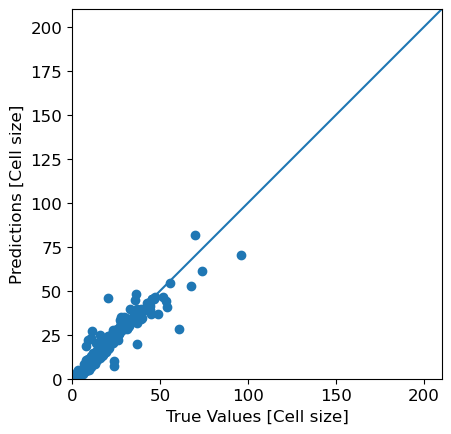

In [55]:
y_pred_5_10_train = NN_5_10.predict(X_train_lit_gen).flatten()
display(results(y_pred=y_pred_5_10_train, y=y_train_lit_gen))

d) Check the results on the validation set.

1/1 [==============================] - 0s 16ms/step


,R2,MSE,MAE,MAPE
0,0.9876,46.310604,4.074954,0.198206


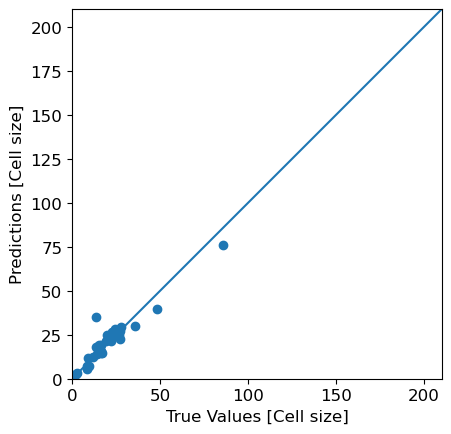

In [56]:
y_pred_5_10_val = NN_5_10.predict(X_val_lit_gen).flatten()
display(results(y_pred=y_pred_5_10_val, y=y_val_lit_gen))

e) Check the results on the test set.

1/1 [==============================] - 0s 24ms/step


,R2,MSE,MAE,MAPE
0,0.798637,2465.548127,11.961652,0.220457


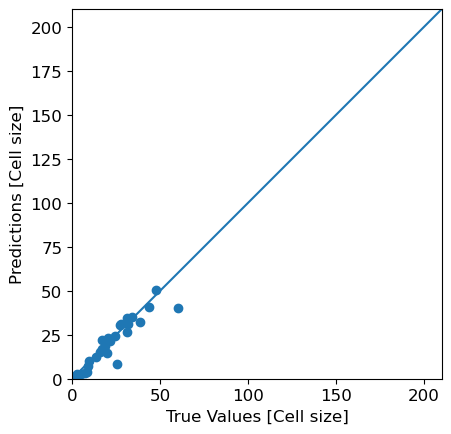

In [58]:
y_pred_5_10_test = NN_5_10.predict(X_test_lit_gen).flatten()
display(results(y_pred=y_pred_5_10_test, y=y_test_lit_gen))

**5.10.4. Run grid search.**

a) Prepare parameters grid.

In [59]:
# preparing grid to search
number_of_layers = [1,2,3,4,5]
number_of_nodes = [5,10,15]
batch_sizes = [ 5,8,10]

parameters_grid = dict(n_hidden = number_of_layers, 
                       n_neurons = number_of_nodes,
                       batch_size = batch_sizes)

b) Build and compile model and grid search object.

In [60]:
grid_search_model_5_10 = KerasRegressor(build_and_compile_model)
grid_search_object_5_10 = GridSearchCV(estimator=grid_search_model_5_10, 
                                  param_grid=parameters_grid)

C:\Users\Stanislaw\AppData\Local\Temp\ipykernel_20648\974533003.py:1: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  grid_search_model_5_10 = KerasRegressor(build_and_compile_model)


c) Run grid search

In [67]:
%%time
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)
grid_search_object_5_10.fit(X_train_lit_gen, 
                           y_train_lit_gen, 
                           epochs = 60, 
                           validation_data=(X_val_lit_gen,y_val_lit_gen), 
                           verbose = 0,
                           callbacks=[callback])

# ----- add sound signal when it's finished -----------
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)


5/5 [==============================] - 0s 3ms/step - loss: 5.4440 - mse: 123.8284
CPU times: total: 3h 35min 3s
Wall time: 31min 28s


In [68]:
best_NN_gridsearch = grid_search_object_5_10.best_estimator_

In [69]:
grid_search_object_5_10.best_params_

{'batch_size': 5, 'n_hidden': 5, 'n_neurons': 15}

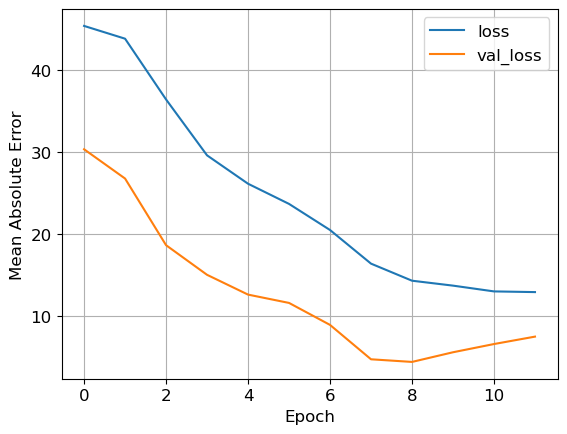

In [70]:
best_NN_gridsearch = build_and_compile_model(n_hidden = 5,
                                   n_neurons = 15,
                                   loss_function = 'mae')
history_test=best_NN_gridsearch.fit(X_train_lit_gen, 
                                    y_train_lit_gen, 
                                    epochs = 60, 
                                    validation_data=(X_val_lit_gen,y_val_lit_gen), 
                                    verbose = 0, 
                                    batch_size=5,
                                    callbacks=[callback])
plot_loss(history_test, metric = 'Mean Absolute Error')

Best results were achieved for those parameters: {'batch size': 5, 'n_hidden': 5, 'n_neurons': 15}

d) Check the results on training set.

8/8 [==============================] - 0s 3ms/step


,R2,MSE,MAE,MAPE
0,0.80342,2738.114361,12.161956,0.190398


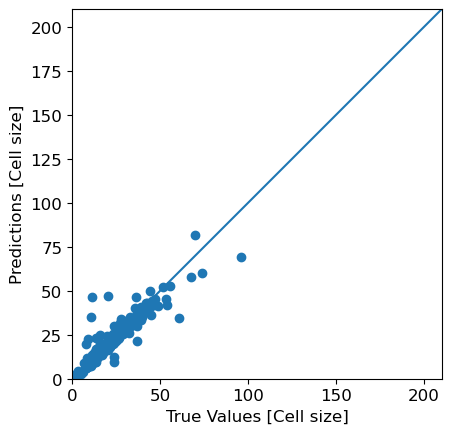

In [71]:
y_pred_grid_train = best_NN_gridsearch.predict(X_train_lit_gen).flatten()
display(results(y_pred=y_pred_grid_train, y=y_train_lit_gen))

e) Checkt the results on the validation set.

1/1 [==============================] - 0s 25ms/step


,R2,MSE,MAE,MAPE
0,0.843887,583.037947,7.399229,0.192905


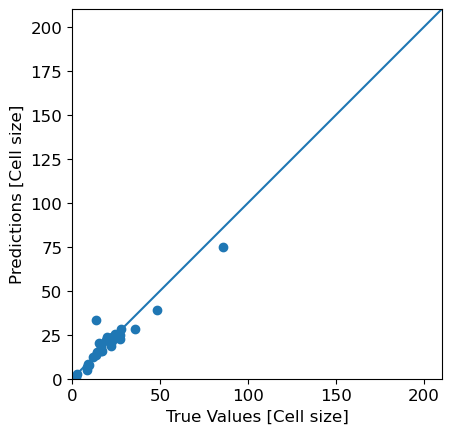

In [72]:
y_pred_grid_val = best_NN_gridsearch.predict(X_val_lit_gen).flatten()
display(results(y_pred=y_pred_grid_val, y=y_val_lit_gen))

f) Check the results on the test set.

1/1 [==============================] - 0s 29ms/step


,R2,MSE,MAE,MAPE
0,0.921909,956.16669,8.627745,0.234084


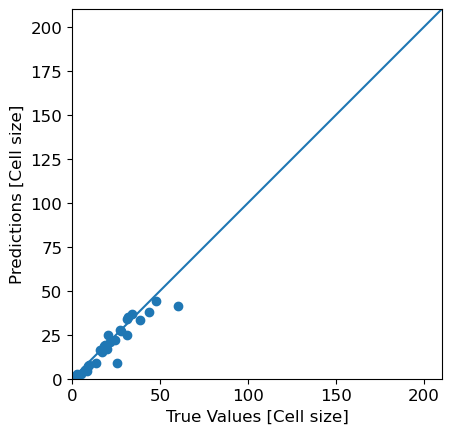

In [73]:
y_pred_grid_test = best_NN_gridsearch.predict(X_test_lit_gen).flatten()
display(results(y_pred=y_pred_grid_test, y=y_test_lit_gen))

g) Inspect the results using interactive plot.

In [83]:
X_y_lit_gen_comb = pd.concat([X_lit_gen, y_lit_gen], axis=1)
X = sc_X_lit_gen.transform( X_lit_gen)
X_y_lit_gen_comb['Predictions'] = best_NN_gridsearch.predict(X).flatten()
results, y_mod = results_with_exp_uncertainty(y_test=X_y_lit_gen_comb['Cell_size'],
                             y_pred=X_y_lit_gen_comb['Predictions'],
                             uncertaity=0.2)
display(results)
fig = go.Figure()
fig.add_trace(go.Scatter(x = X_y_lit_gen_comb['Cell_size'], 
                         y = X_y_lit_gen_comb['Predictions'], 
                         mode = 'markers', 
                         name = "No",
                         customdata=X_y_lit_gen_comb[['p0']],
                         hovertemplate = 'p0: %{customdata[0]:1.3f}[bar]<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))
fig.add_trace(go.Scatter(x = X_y_lit_gen_comb['Cell_size'], 
                         y = y_mod, 
                         mode = 'markers', 
                         name = "Yes",
                         customdata=X_y_lit_gen_comb[['p0']],
                         hovertemplate = 'p0: %{customdata[0]:1.3f}[bar]<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))

fig.update_layout(
                title=f"Results of the model trained on both exp. and lit. data.",
                xaxis_title="True Values [Cell size]",
                yaxis_title="Predictions [Cell size]",
                legend_title = 'Uncert. taken into account:',
                yaxis_range=[0,1500],
                xaxis_range=[0,1500],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

10/10 [==============================] - 0s 2ms/step


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.816423,2345.023621,11.334276,0.195085
1,Uncertainty correction,0.904058,1098.580450,5.466545,0.062490


#### 5.11. NN trained on raw literature and experimental data using general parameters.

**5.11.1. Load the data.**

In [9]:
X_general = data_for_modeling_general.iloc[:, :-1]
y_general = data_for_modeling_general.iloc[:,  -1]

In [10]:
data_from_literature_general = pd.read_csv(filepath_or_buffer="C:/Users/Stanislaw/OneDrive - Politechnika Warszawska/Pulpit/09 Synology/01 ENERGYTECH/04 Badania/Energytech-1/data_from_literature.csv",
                        sep = ';',
                        decimal = ',',
                        encoding = 'utf-8')

# drop last column being literature reference
data_from_literature_general = data_from_literature_general.drop(columns = ['Literature'])
data_from_literature_general['p0'] = data_from_literature_general['p0']/100

In [11]:
X_lit = data_from_literature_general.iloc[:, :-2]
X_lit['1/p0'] = 1/X_lit['p0']
X_lit['ln(p0)'] = np.log(X_lit['p0'])

y_lit = data_from_literature_general.iloc[:,  -2]

In [12]:
results_list = []

for idx, row in X_lit.iterrows():
    results_list.append(get_cantera_parameters(p0 = row['p0'],
                                               phi = row['phi'], 
                                               CH4 = row['ch4'],
                                               H2 = 0.0,
                                               air = row['air'],
                                               T0 = 293,
                                               diluent = row['diluent'], 
                                               diluent_fraction = row['diluent_fraction'],
                                               zhang=row['zhang']))
X_lit['general_parameters'] = results_list

In [13]:
new_columns = ['density_mole', 
               'mean_molecular_weight', 
               'enthalpy_mole',
               'int_energy_mole', 
               'entropy_mole', 
               'gibbs_mole', 
               'fuel_molecular_weight', 
               'oxidizer_molecular_weight',
               'inert_molecular_weight']
input_features = ['p0', '1/p0', 'ln(p0)', 'density_mole', 'mean_molecular_weight',
       'enthalpy_mole', 'int_energy_mole', 'entropy_mole', 'gibbs_mole',
       'fuel_molecular_weight', 'oxidizer_molecular_weight',
       'inert_molecular_weight']
X_lit[new_columns] = pd.DataFrame(X_lit['general_parameters'].values.tolist(), index=X_lit.index)
X_lit = X_lit.drop(columns=['general_parameters'])
X_lit = X_lit[input_features]

In [14]:
X_lit_gen = pd.concat([X_general, X_lit], ignore_index=True)
y_lit_gen = pd.concat([y_general, y_lit], ignore_index=True)

In [15]:
print(X_lit_gen.shape)
print(y_lit_gen.shape)

(35996, 12)
(35996,)


**5.11.2. Transform the data.**

In [16]:
# divide into training and test set.
X_train_lit_gen, X_test_lit_gen, y_train_lit_gen, y_test_lit_gen = train_test_split(X_lit_gen, y_lit_gen, test_size = 0.2)
X_val_lit_gen, X_test_lit_gen, y_val_lit_gen, y_test_lit_gen = train_test_split(X_test_lit_gen, y_test_lit_gen, test_size = 0.5)

# scale the data
sc_X_lit_gen    = StandardScaler()
X_train_lit_gen = sc_X_lit_gen.fit_transform(X_train_lit_gen)
X_val_lit_gen   = sc_X_lit_gen.transform(X_val_lit_gen)
X_test_lit_gen  = sc_X_lit_gen.transform(X_test_lit_gen)


**5.11.3. Create first NN.**

a) Build and compile model.

In [28]:
NN_5_11 = build_and_compile_model(n_hidden = 3,
                                   n_neurons = 15,
                                   loss_function = 'mse')

b) Train model.

CPU times: total: 3min 36s
Wall time: 17.3 s


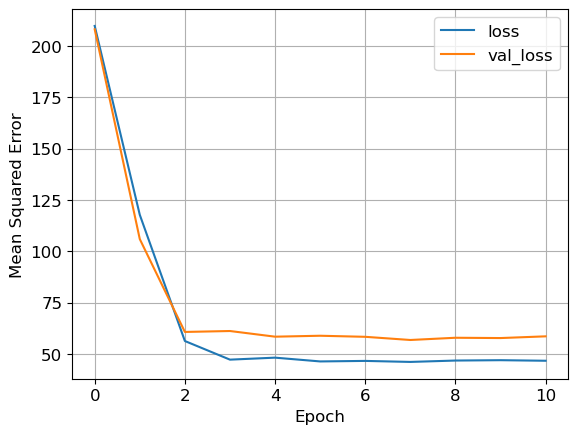

In [29]:
%%time
# train model
keras.backend.clear_session()
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)
history_5_11 = NN_5_11.fit(X_train_lit_gen, 
                         y_train_lit_gen, 
                         validation_data = (X_val_lit_gen, y_val_lit_gen),
                         epochs = 60,
                         verbose = 0,
                         batch_size=32,
                         callbacks=[callback])
plot_loss(history_5_11, metric = 'Mean Squared Error')


c) Check the results on the training set.

900/900 [==============================] - 1s 2ms/step


,R2,MSE,MAE,MAPE
0,0.812256,43.093938,2.642347,0.171326


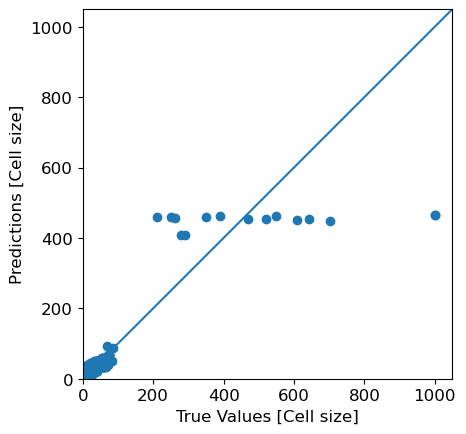

In [39]:
y_pred_5_11_train = NN_5_11.predict(X_train_lit_gen).flatten()
display(results(y_pred=y_pred_5_11_train, y=y_train_lit_gen))

d) Check the results on the validation set.

113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.806915,58.435194,2.795652,0.180721


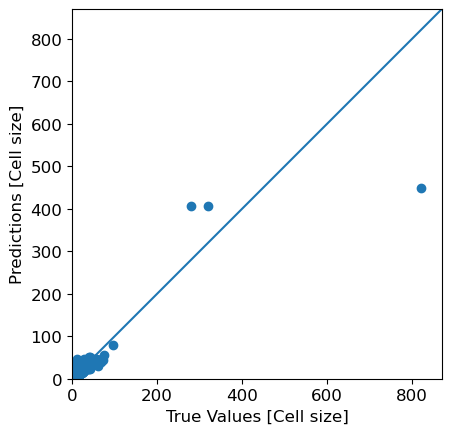

In [40]:
y_pred_5_11_val = NN_5_11.predict(X_val_lit_gen).flatten()
display(results(y_pred=y_pred_5_11_val, y=y_val_lit_gen))

e) Check the results on the test set.

113/113 [==============================] - 0s 2ms/step


,R2,MSE,MAE,MAPE
0,0.869632,16.902988,2.654884,0.174479


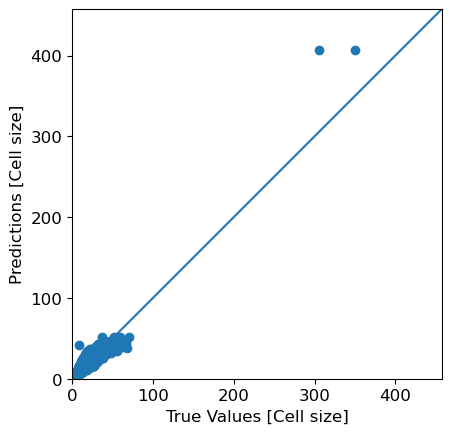

In [41]:
y_pred_5_11_test = NN_5_11.predict(X_test_lit_gen).flatten()
display(results(y_pred=y_pred_5_11_test, y=y_test_lit_gen))

**5.11.4. Run grid search.**

a) Prepare parameters grid.

In [47]:
# preparing grid to search
number_of_layers = [3,4,5]
number_of_nodes = [5,10,15]
batch_sizes = [ 16, 32, 64]

parameters_grid = dict(n_hidden = number_of_layers, 
                       n_neurons = number_of_nodes,
                       batch_size = batch_sizes)

b) Build and compile model and grid search object.

In [48]:
grid_search_model_5_11 = KerasRegressor(build_and_compile_model)
grid_search_object_5_11 = GridSearchCV(estimator=grid_search_model_5_11, 
                                  param_grid=parameters_grid)

C:\Users\Stanislaw\AppData\Local\Temp\ipykernel_23216\559199811.py:1: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  grid_search_model_5_11 = KerasRegressor(build_and_compile_model)


c) Run grid search

In [49]:
%%time
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)
grid_search_object_5_11.fit(X_train_lit_gen, 
                           y_train_lit_gen, 
                           epochs = 60, 
                           validation_data=(X_val_lit_gen,y_val_lit_gen), 
                           verbose = 0,
                           callbacks=[callback])

# ----- add sound signal when it's finished -----------
duration = 1000  # milliseconds
freq = 440  # Hz
winsound.Beep(freq, duration)


90/90 [==============================] - 0s 2ms/step - loss: 2.6688 - mse: 86.7899
CPU times: total: 20h 17min 53s
Wall time: 1h 31min 13s


In [50]:
best_NN_gridsearch = grid_search_object_5_11.best_estimator_

In [52]:
grid_search_object_5_11.best_params_

{'batch_size': 64, 'n_hidden': 5, 'n_neurons': 15}

The best results were achieved for the following set of parameters: {'batch_size': 64, 'n_hidden': 5, 'n_neurons': 15}

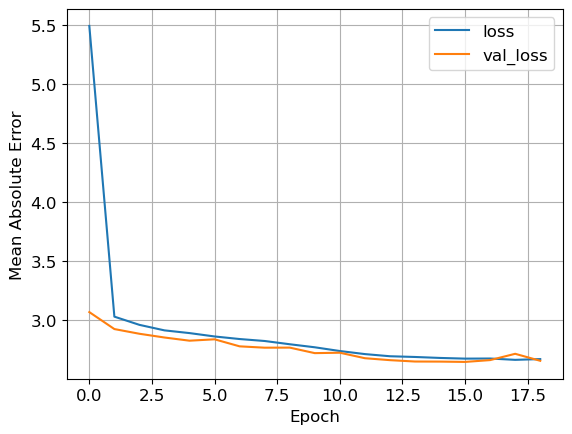

In [17]:
# training model using above set of parameters so that i don't need to rerun the grid search
best_NN_gridsearch = build_and_compile_model(n_hidden = 5,
                                   n_neurons = 15,
                                   loss_function = 'mae')

callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)
history_test=best_NN_gridsearch.fit(X_train_lit_gen, 
                                    y_train_lit_gen, 
                                    epochs = 60, 
                                    validation_data=(X_val_lit_gen,y_val_lit_gen), 
                                    verbose = 0, 
                                    batch_size=64,
                                    callbacks=[callback])
plot_loss(history_test, metric = 'Mean Absolute Error')

d) Check the results on training set.

900/900 [==============================] - 1s 1ms/step


,R2,MSE,MAE,MAPE
0,0.800646,40.406805,2.577266,0.163747


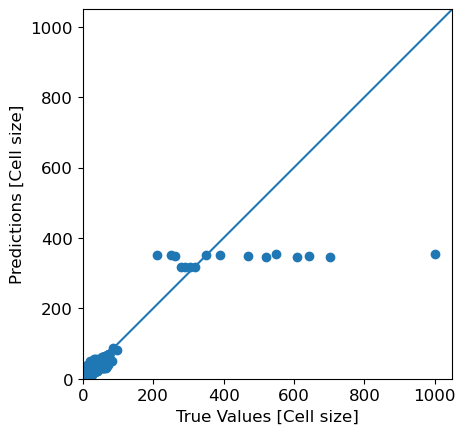

In [18]:
y_pred_grid_train = best_NN_gridsearch.predict(X_train_lit_gen).flatten()
display(results(y_pred=y_pred_grid_train, y=y_train_lit_gen))

e) Checkt the results on the validation set.

113/113 [==============================] - 0s 1ms/step


,R2,MSE,MAE,MAPE
0,0.893137,13.426555,2.589689,0.162126


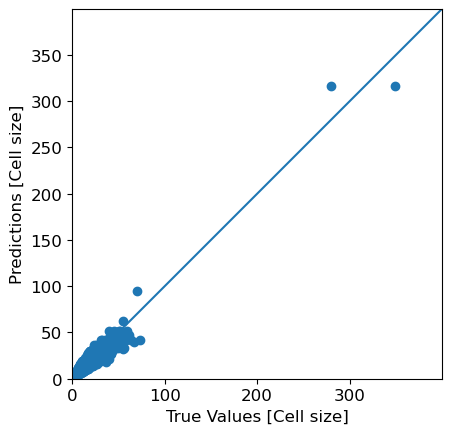

In [19]:
y_pred_grid_val = best_NN_gridsearch.predict(X_val_lit_gen).flatten()
display(results(y_pred=y_pred_grid_val, y=y_val_lit_gen))

f) Check the results on the test set.

113/113 [==============================] - 0s 2ms/step


,R2,MSE,MAE,MAPE
0,0.635435,190.084725,2.782603,0.159803


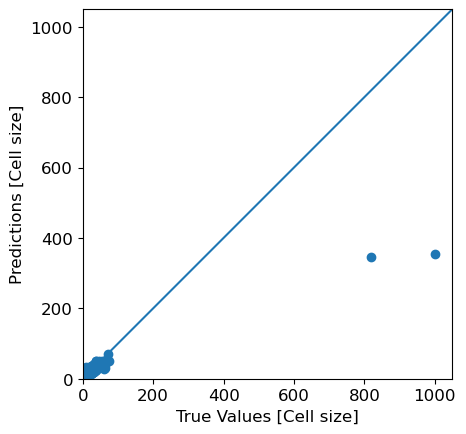

In [20]:
y_pred_grid_test = best_NN_gridsearch.predict(X_test_lit_gen).flatten()
display(results(y_pred=y_pred_grid_test, y=y_test_lit_gen))

g) Inspect the results using interactive plot.

In [22]:
X_lit_gen.columns

Index(['p0', '1/p0', 'ln(p0)', 'density_mole', 'mean_molecular_weight',
       'enthalpy_mole', 'int_energy_mole', 'entropy_mole', 'gibbs_mole',
       'fuel_molecular_weight', 'oxidizer_molecular_weight',
       'inert_molecular_weight'],
      dtype='object')

In [25]:
X_y_lit_gen_comb = pd.concat([X_lit_gen, y_lit_gen], axis=1)
X = sc_X_lit_gen.transform( X_lit_gen)
X_y_lit_gen_comb['Predictions'] = best_NN_gridsearch.predict(X).flatten()
results, y_mod = results_with_exp_uncertainty(y_test=X_y_lit_gen_comb['Cell_size'],
                             y_pred=X_y_lit_gen_comb['Predictions'],
                             uncertaity=0.2)
hover_features = ['p0','density_mole','mean_molecular_weight']
display(results)
fig = go.Figure()
fig.add_trace(go.Scatter(x = X_y_lit_gen_comb['Cell_size'], 
                         y = X_y_lit_gen_comb['Predictions'], 
                         mode = 'markers', 
                         name = "No",
                         customdata=X_y_lit_gen_comb[hover_features],
                         hovertemplate = 'p0: %{customdata[0]:1.3f}[bar]<br>density : %{customdata[1]:.3f}<br>Mean molecular weight: %{customdata[2]:.3f}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))
fig.add_trace(go.Scatter(x = y_mod, 
                         y = X_y_lit_gen_comb['Predictions'], 
                         mode = 'markers', 
                         name = "Yes",
                         customdata=X_y_lit_gen_comb[['p0']],
                         hovertemplate = 'p0: %{customdata[0]:1.3f}[bar]<br>Predicted cell size:%{y}<br>Modified "real" cell size:%{x}'))

fig.update_layout(
                title=f"Results of the model trained on both exp. and lit. data.",
                xaxis_title="True Values [Cell size]",
                yaxis_title="Predictions [Cell size]",
                legend_title = 'Uncert. taken into account:',
                yaxis_range=[0,1500],
                xaxis_range=[0,1500],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

1125/1125 [==============================] - 1s 1ms/step


,Version,R2,MSE,MAE,MAPE
0,No uncertainty correction,0.767800,52.677935,2.599044,0.163191
1,Uncertainty correction,0.844437,30.452900,0.567712,0.029968


In [36]:
X_y_lit_gen_comb['Pred delta abs'] = np.abs(X_y_lit_gen_comb['Cell_size'] - X_y_lit_gen_comb['Predictions'])
X_y_lit_gen_comb.loc[X_y_lit_gen_comb['Cell_size'] > 200]

,p0,1/p0,ln(p0),density_mole,mean_molecular_weight,enthalpy_mole,int_energy_mole,entropy_mole,gibbs_mole,fuel_molecular_weight,oxidizer_molecular_weight,inert_molecular_weight,Cell_size,Predictions,Pred delta abs
35884,1.013,0.987167,0.012916,0.041582,27.633624,-7.240798e+06,-9.676936e+06,199576.932945,-6.571684e+07,1.524448,6.081068,20.028109,349.532,316.811951,32.720049
35885,1.013,0.987167,0.012916,0.041582,27.633624,-7.240798e+06,-9.676936e+06,199576.932945,-6.571684e+07,1.524448,6.081068,20.028109,320.000,316.811951,3.188049
35913,1.013,0.987167,0.012916,0.041582,27.633624,-7.240798e+06,-9.676936e+06,199576.932945,-6.571684e+07,1.524448,6.081068,20.028109,291.710,316.811951,25.101951
35914,1.013,0.987167,0.012916,0.041582,27.633624,-7.240798e+06,-9.676936e+06,199576.932945,-6.571684e+07,1.524448,6.081068,20.028109,279.555,316.811951,37.256951
35925,1.013,0.987167,0.012916,0.041582,27.633624,-7.240798e+06,-9.676936e+06,199576.932945,-6.571684e+07,1.524448,6.081068,20.028109,305.000,316.811951,11.811951
35926,1.013,0.987167,0.012916,0.041582,27.633624,-7.240798e+06,-9.676936e+06,199576.932945,-6.571684e+07,1.524448,6.081068,20.028109,280.000,316.811951,36.811951
35960,1.013,0.987167,0.012916,0.041582,28.691272,-1.077566e+06,-3.513703e+06,198546.063813,-5.925156e+07,0.199627,6.635967,21.855678,1000.000,355.269928,644.730072
35961,1.013,0.987167,0.012916,0.041582,28.691272,-1.077566e+06,-3.513703e+06,198546.063813,-5.925156e+07,0.199627,6.635967,21.855678,1000.000,355.269928,644.730072
35962,1.013,0.987167,0.012916,0.041582,28.639027,-1.382013e+06,-3.818151e+06,198638.763049,-5.958317e+07,0.265069,6.608556,21.765401,549.300,353.562164,195.737836
35963,1.013,0.987167,0.012916,0.041582,28.600125,-1.608704e+06,-4.044841e+06,198702.092997,-5.982842e+07,0.313798,6.588146,21.698181,388.730,352.280365,36.449635


In [37]:
data_from_literature_general.loc[data_from_literature_general['air']==True]

,phi,p0,ch4,h2,air,diluent,diluent_fraction,zhang,Cell_size,Comment
16,1.00,1.013,1.0,0,True,False,0.0,False,349.532,NaN
17,1.00,1.013,1.0,0,True,False,0.0,False,320.000,NaN
45,1.00,1.013,1.0,0,True,False,0.0,False,291.710,NaN
46,1.00,1.013,1.0,0,True,False,0.0,False,279.555,NaN
57,1.00,1.013,1.0,0,True,False,0.0,False,305.000,NaN
58,1.00,1.013,1.0,0,True,False,0.0,False,280.000,NaN
92,0.12,1.013,1.0,0,True,False,0.0,False,1000.000,"assumed initial pressure, no info in the article"
93,0.12,1.013,1.0,0,True,False,0.0,False,1000.000,"assumed initial pressure, no info in the article"
94,0.16,1.013,1.0,0,True,False,0.0,False,549.300,"assumed initial pressure, no info in the article"
95,0.19,1.013,1.0,0,True,False,0.0,False,388.730,"assumed initial pressure, no info in the article"


### 6. Visualizations

In this section I'm preparing visulizations for conferences/articles and my PhD Thesis.

#### 6.1. Plots for 29th ICDERS conference.

**6.1.1. Predicted vs Actual coloured by model, trained on averages**

In [74]:
fig = go.Figure()

fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_5_4_7, 
                         mode = 'markers', 
                         name = "Regression"))
                        #  customdata=X_y_lit_comb[['phi','p0','ch4', 'h2','air','diluent']],
                        #  hovertemplate = 'Phi: %{customdata[0]}<br>p0: %{customdata[1]:1.3f}[bar]<br>CH4:%{customdata[2]}<br>H2:%{customdata[3]}<br>air:%{customdata[4]}<br>diluent:%{customdata[5]}<br>Predicted cell size:%{y}<br>Real cell size:%{x}'))

y_test_svr_avg = np.ravel(sc_y_avg.inverse_transform(y_test_SVR_avg))
y_pred_test_svr_avg = np.ravel(sc_y_avg.inverse_transform(y_pred_SVR_5_6_avg_test))
fig.add_trace(go.Scatter(x = y_test_svr_avg, 
                         y = y_pred_test_svr_avg, 
                         mode = 'markers', 
                         name = "SVR"))
fig.update_layout(
                title=f"Test set: Predicted  vs Actual, trained on averages",
                xaxis_title="True Values [Cell size]",
                yaxis_title="Predictions [Cell size]",
                legend_title = 'Model:',
                yaxis_range=[0,85],
                xaxis_range=[0,85],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}]
            )           
fig.show()

**6.1.2. Predicted vs Actual coloured by model, trained on raw data**

In [125]:
fig = go.Figure()

# ------------- Regression ----------------------
fig.add_trace(go.Scatter(x = y_test, 
                         y = y_pred_test_5_5, 
                         mode = 'markers', 
                         name = "Regression",
                        #  opacity = 0.5,
                         marker = dict(color = 'green')))
                        
# ------------- Support Vector Regression -----------
y_test_svr_avg = np.ravel(sc_y_raw.inverse_transform(y_test_SVR_raw))
y_pred_test_svr_avg = np.ravel(sc_y_raw.inverse_transform(y_pred_SVR_5_6_raw_test))
fig.add_trace(go.Scatter(x = y_test_svr_avg, 
                         y = y_pred_test_svr_avg, 
                         mode = 'markers', 
                         name = "SVR",
                        #  opacity = 0.5,
                         marker = dict(color = 'blue')))

# ------------- Neaural Network ----------------------
fig.add_trace(go.Scatter(x = pd.concat([y_val_NN, y_test_NN], ignore_index=True), 
                         y = np.concatenate((y_pred_5_7_3_val, y_pred_5_7_3_test), axis=None), 
                         mode = 'markers', 
                         name = "Neural Network",
                        #  opacity = 0.5,
                         marker = dict(color = 'red')))

# ----------------------------------------------------
fig.update_layout(
                title=f"Test set: Predicted  vs Actual <br><sup>Models trained on raw data</sup>",
                xaxis_title="True Values [Cell size]",
                yaxis_title="Predictions [Cell size]",
                legend_title = 'Model:',
                yaxis_range=[0,100],
                xaxis_range=[0,100],
                shapes = [{'type': 'line', 'yref': 'paper', 'xref': 'paper', 'y0': 0, 'y1': 1, 'x0': 0, 'x1': 1, 'layer':'below'}],
                template = 'plotly_white',
                title_font = dict(family="Calibri", size=28),
                legend_font = dict(family="Calibri", size=24),
                width=800,
                height=600,
                # legend = dict(orientation='h', yanchor='bottom', y=1.02, xanchor="right", x=1)
            )
fig.update_xaxes(title_font=dict(size=28, family='Calibri', color='black'),  # title settings
                 showline=True, linewidth=2, linecolor='black', mirror=True, # line settings
                 tickfont=dict(family='Calibri', color='black', size=22),    # tick settings
                #  showgrid = True, gridwidth=1, gridcolor='LightGray',        # grid settings
                 )
fig.update_yaxes(title_font=dict(size=28, family='Calibri', color='black'),  # title settings
                 showline=True, linewidth=2, linecolor='black', mirror=True, # line settings
                 tickfont=dict(family='Calibri', color='black', size=22),    # tick settings
                #  showgrid = True, gridwidth=1, gridcolor='LightGray',        # grid settings
                 )
 
fig.show()